<a href="https://colab.research.google.com/github/mennaayman1/EEG-classification/blob/main/EEGclassification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'eeg-data2:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F4650865%2F7915386%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240519%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240519T194510Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D793870986076bebd16a246d3439cd7064440a2f32586bbd513862d2f2edde8932b3d10174460e6a6b535d688ba7baf7f269f45be597b74401033dee80408cbb6c6698fc1a10bbf904d3f1e699863a5d2a6015ccec26ab37912acd841ef0b48d92ee9b7d8998f4e96c7d726a0cf63ad8355089ab27495f7aea657fbc18c9e11238b801557111f038284ac58d37b90750da5d5a01d2b66121fb6985655c258a29680e4e35230f8b406827edc2ccc3e1963b5cfb964c2809423f0990cd436367544e05b2afc52065385947932855703dd5ff7ba42e86f9d14dabc40c4a4c66044a63fb7d364541152121d78d099d5a3cc6dbb9f446ded9c4a8c480aa44feb1e30bc'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/eeg-data2/h09.edf
/kaggle/input/eeg-data2/h07.edf
/kaggle/input/eeg-data2/s10.edf
/kaggle/input/eeg-data2/s08.edf
/kaggle/input/eeg-data2/s06.edf
/kaggle/input/eeg-data2/h04.edf
/kaggle/input/eeg-data2/MANIFEST.TXT
/kaggle/input/eeg-data2/h01.edf
/kaggle/input/eeg-data2/s01.edf
/kaggle/input/eeg-data2/h13.edf
/kaggle/input/eeg-data2/s09.edf
/kaggle/input/eeg-data2/s05.edf
/kaggle/input/eeg-data2/h10.edf
/kaggle/input/eeg-data2/s02.edf
/kaggle/input/eeg-data2/s07.edf
/kaggle/input/eeg-data2/s14.edf
/kaggle/input/eeg-data2/s13.edf
/kaggle/input/eeg-data2/h14.edf
/kaggle/input/eeg-data2/s04.edf
/kaggle/input/eeg-data2/h12.edf
/kaggle/input/eeg-data2/h05.edf
/kaggle/input/eeg-data2/h03.edf
/kaggle/input/eeg-data2/s11.edf
/kaggle/input/eeg-data2/h02.edf
/kaggle/input/eeg-data2/h08.edf
/kaggle/input/eeg-data2/h11.edf
/kaggle/input/eeg-data2/s03.edf
/kaggle/input/eeg-data2/h06.edf
/kaggle/input/eeg-data2/s12.edf


# Read Data

In [ ]:
import mne

# قراءة ملف EDF
raw = mne.io.read_raw_edf('/kaggle/input/eeg-data2/h01.edf')

# طباعة معلومات حول الإشارات
print(raw.info)

# طباعة البيانات الأولية للتحقق
print(raw.get_data())

Extracting EDF parameters from /kaggle/input/eeg-data2/h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
<Info | 8 non-empty values
 bads: []
 ch_names: Fp2, F8, T4, T6, O2, Fp1, F7, T3, T5, O1, F4, C4, P4, F3, C3, ...
 chs: 19 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2003-06-23 16:14:37 UTC
 nchan: 19
 projs: []
 sfreq: 250.0 Hz
 subject_info: 1 item (dict)
>
[[2.5e-09 2.5e-09 2.5e-09 ... 2.5e-09 2.5e-09 2.5e-09]
 [2.5e-09 2.5e-09 2.5e-09 ... 2.5e-09 2.5e-09 2.5e-09]
 [2.5e-09 2.5e-09 2.5e-09 ... 2.5e-09 2.5e-09 2.5e-09]
 ...
 [2.5e-09 2.5e-09 2.5e-09 ... 2.5e-09 2.5e-09 2.5e-09]
 [2.5e-09 2.5e-09 2.5e-09 ... 2.5e-09 2.5e-09 2.5e-09]
 [2.5e-09 2.5e-09 2.5e-09 ... 2.5e-09 2.5e-09 2.5e-09]]


Extracting EDF parameters from /kaggle/input/eeg-data2/h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


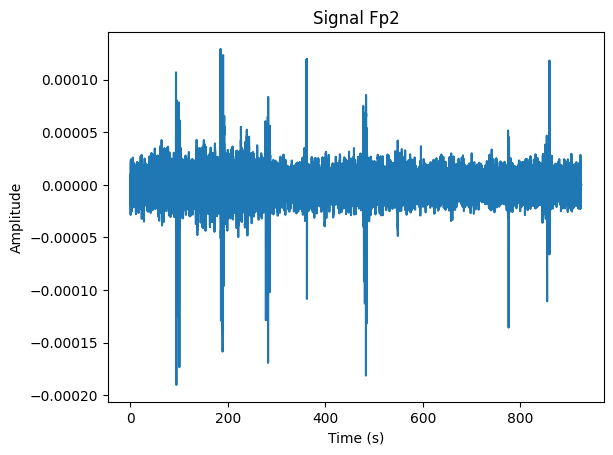

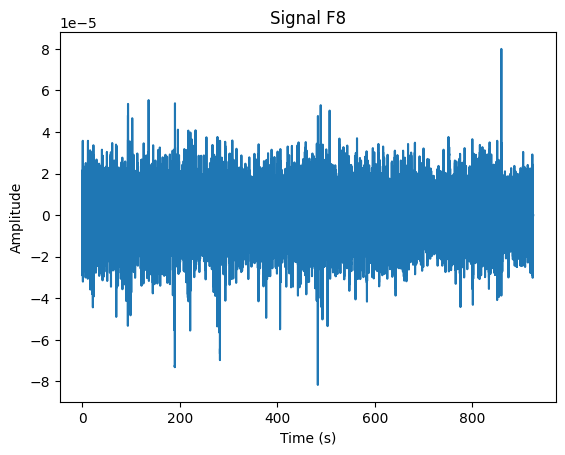

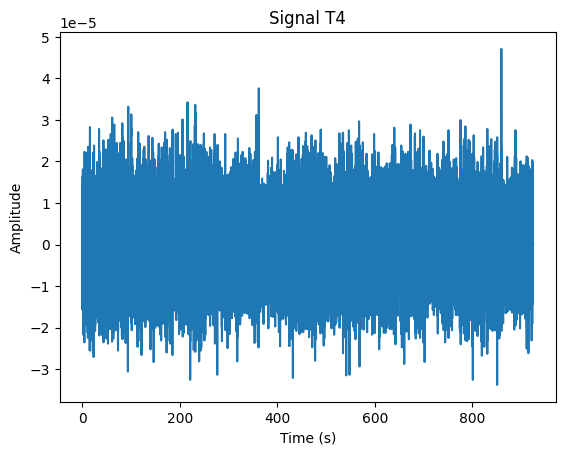

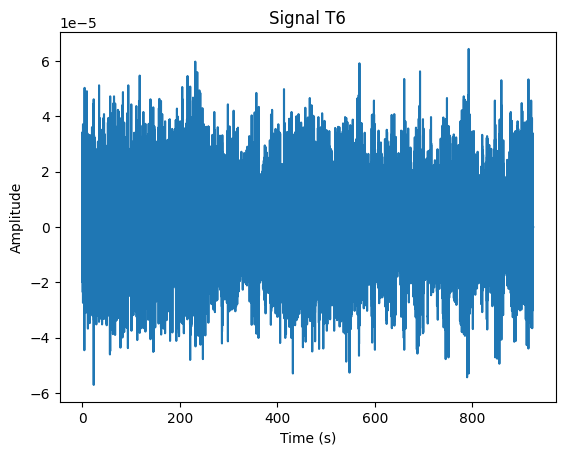

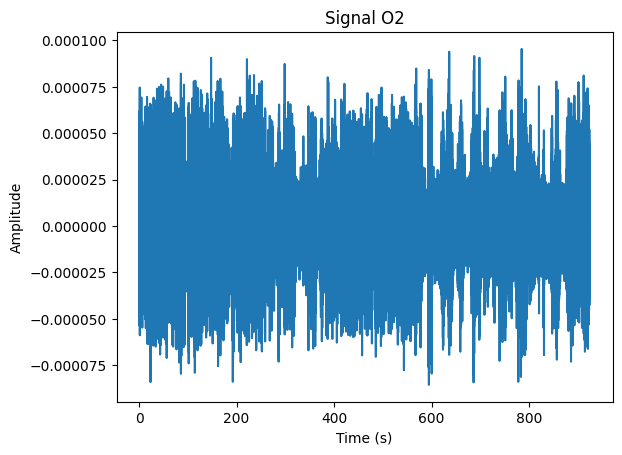

...

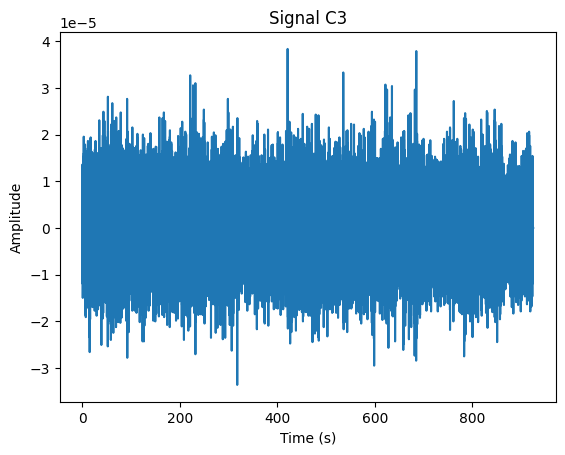

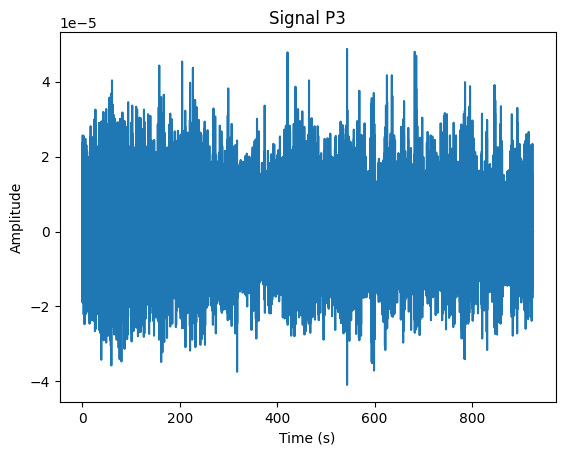

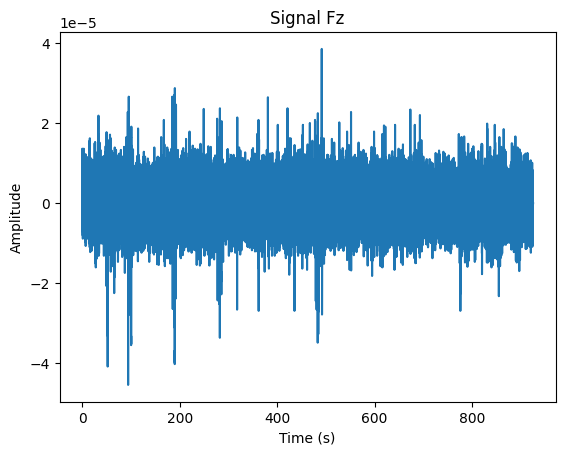

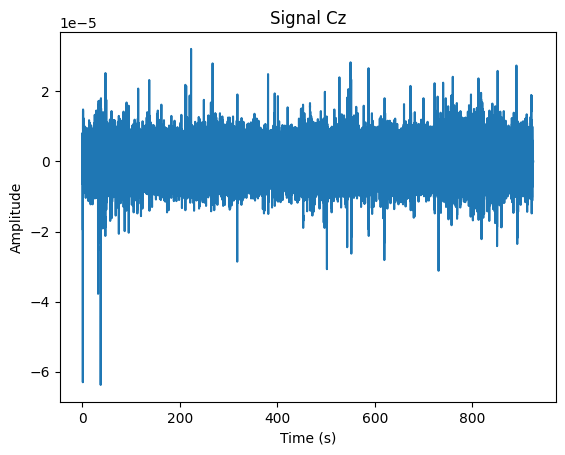

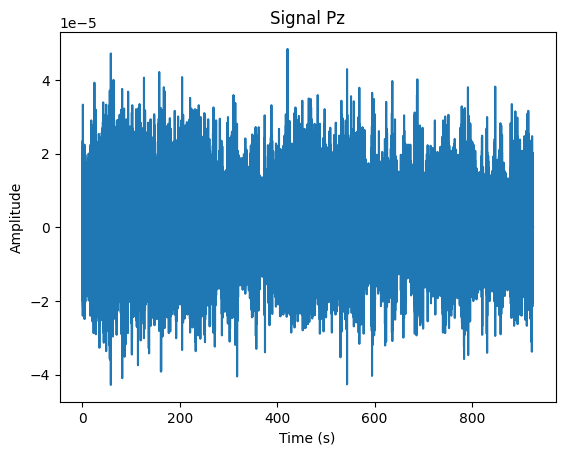

In [ ]:
import mne
import matplotlib.pyplot as plt

# قراءة ملف EDF
raw = mne.io.read_raw_edf('/kaggle/input/eeg-data2/h01.edf')

# استخراج البيانات
data = raw.get_data()

# عدد الإشارات (channels)
num_channels = len(raw.ch_names)

# رسم كل إشارة بشكل منفصل
for i in range(num_channels):
    plt.figure()
    plt.plot(raw.times, data[i, :])  # بيانات الإشارة رقم i
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title('Signal {}'.format(raw.ch_names[i]))

Extracting EDF parameters from /kaggle/input/eeg-data2/h09.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


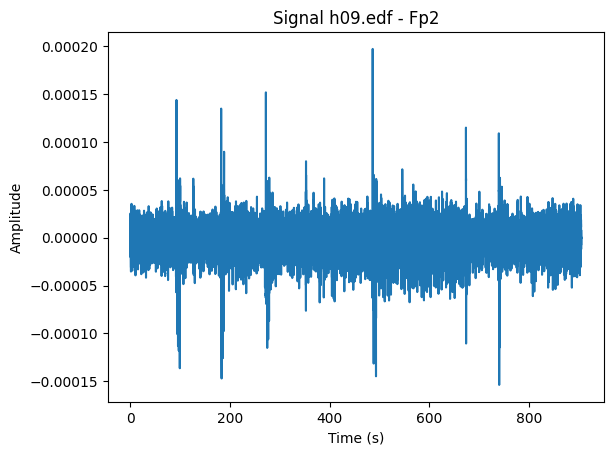

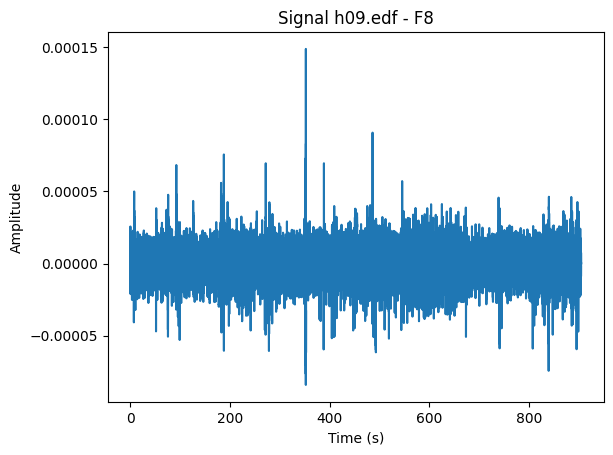

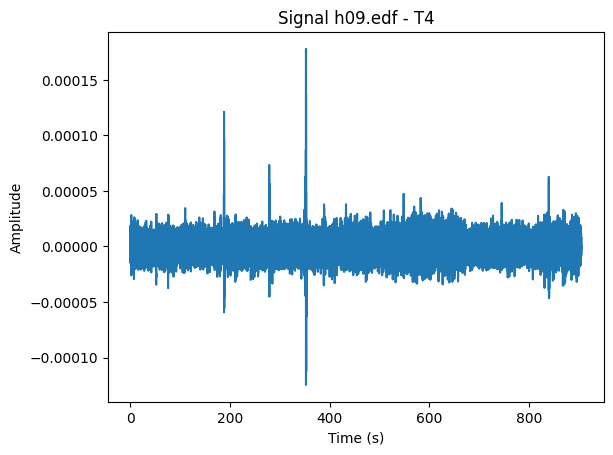

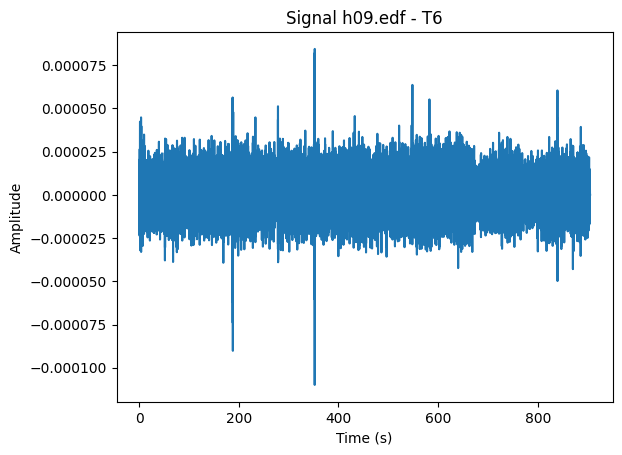

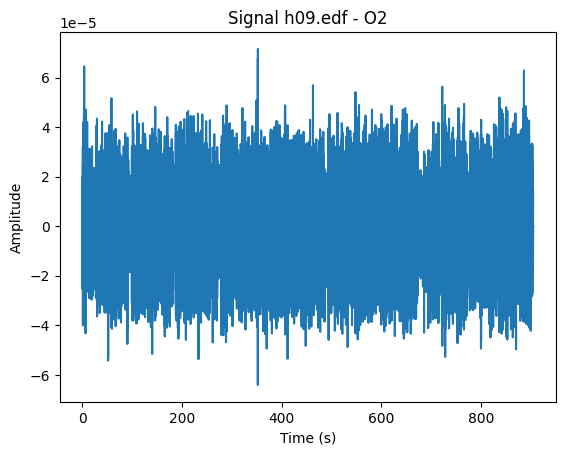

...

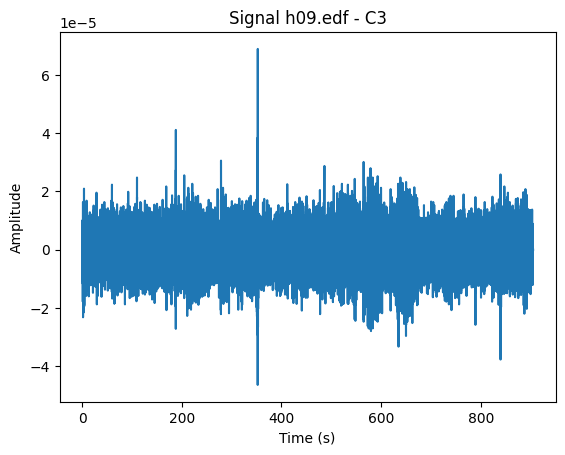

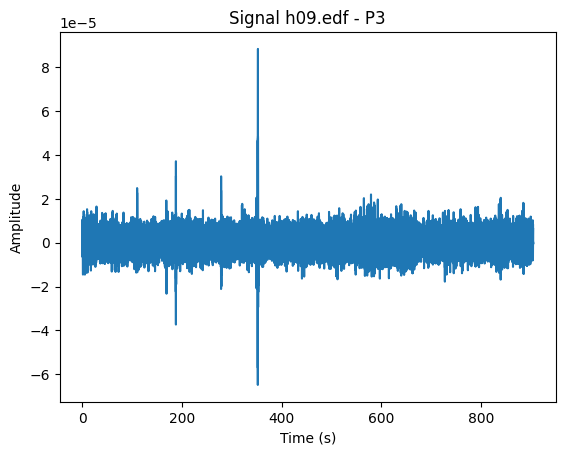

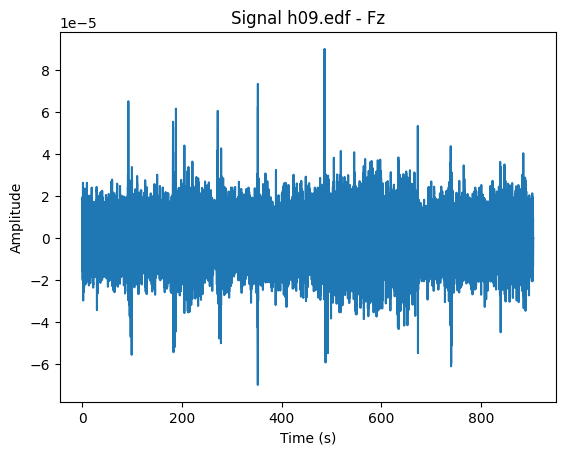

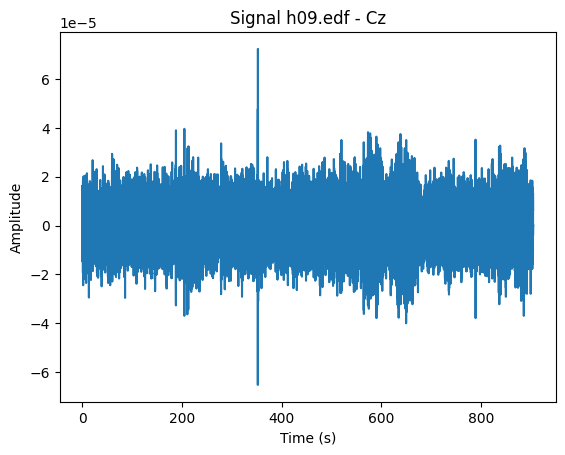

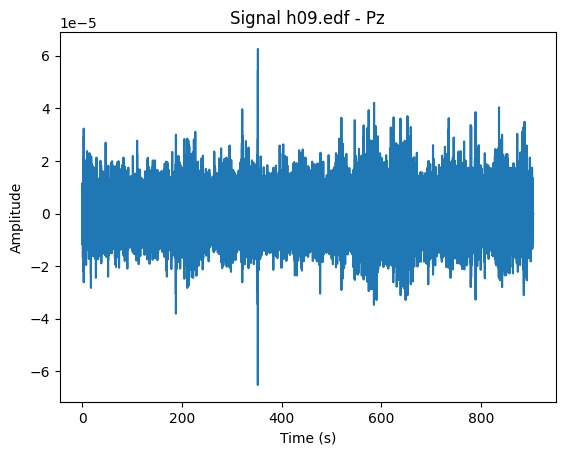

Extracting EDF parameters from /kaggle/input/eeg-data2/h07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


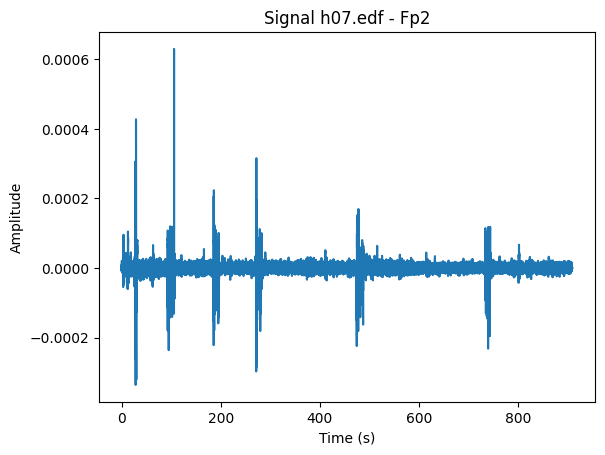

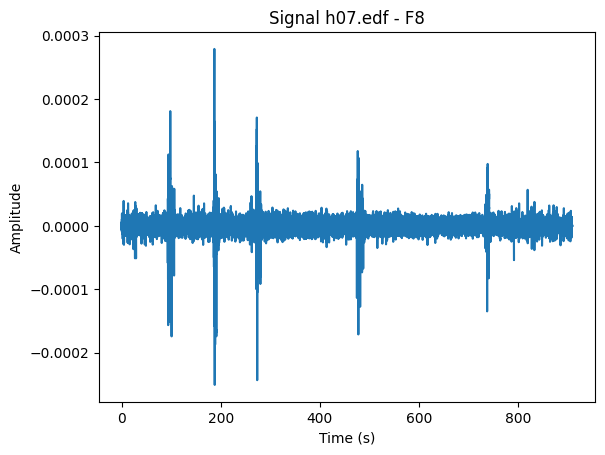

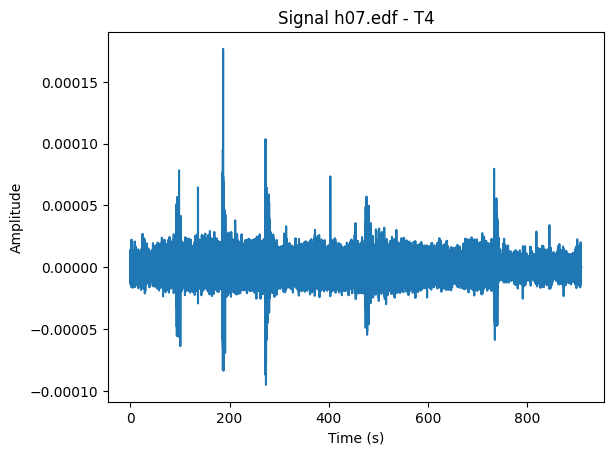

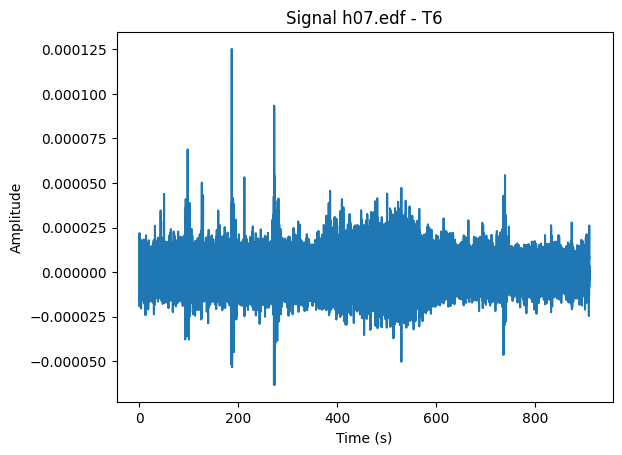

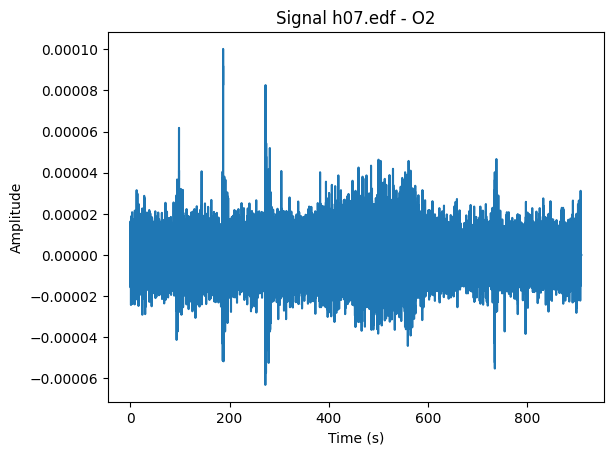

...

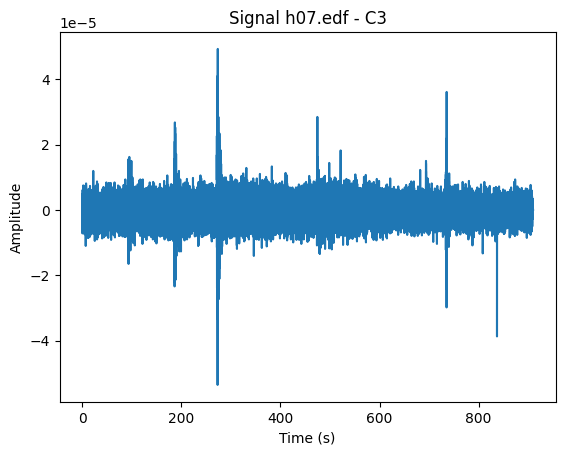

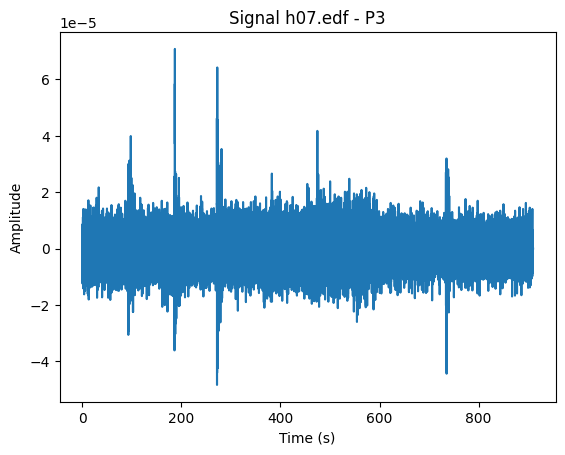

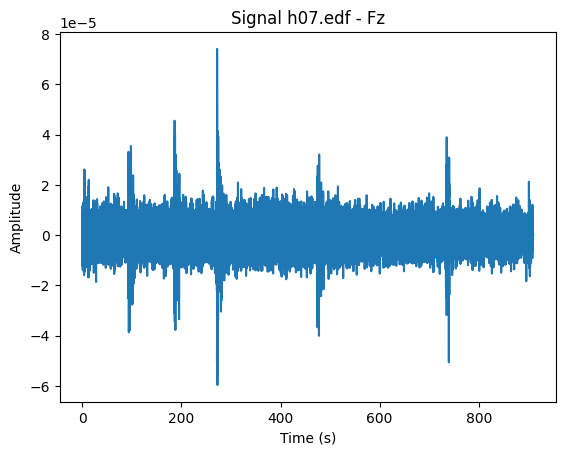

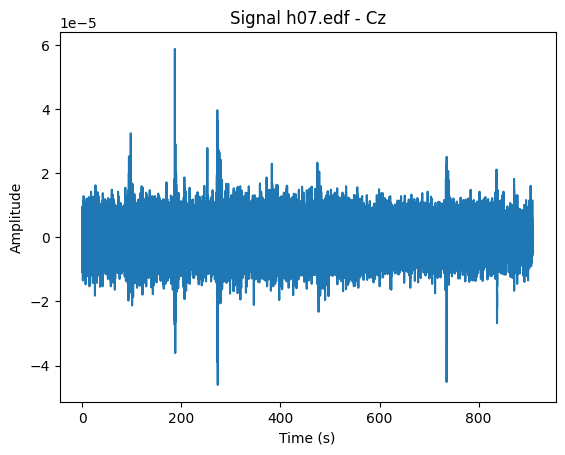

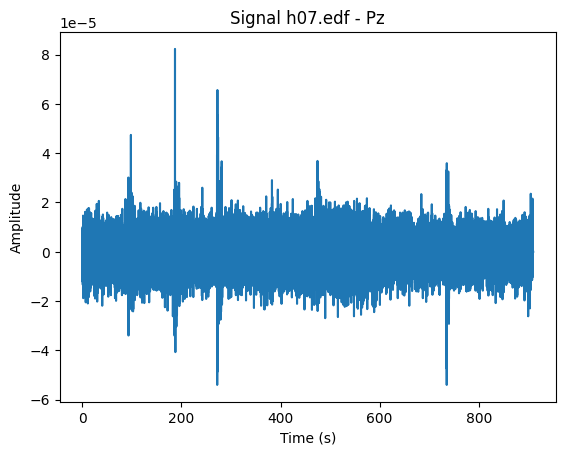

Extracting EDF parameters from /kaggle/input/eeg-data2/s10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


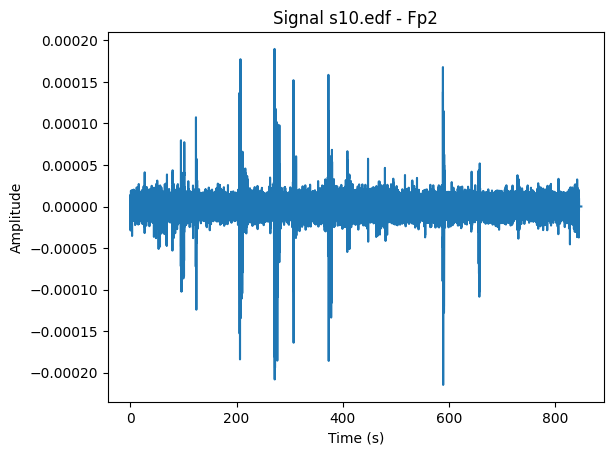

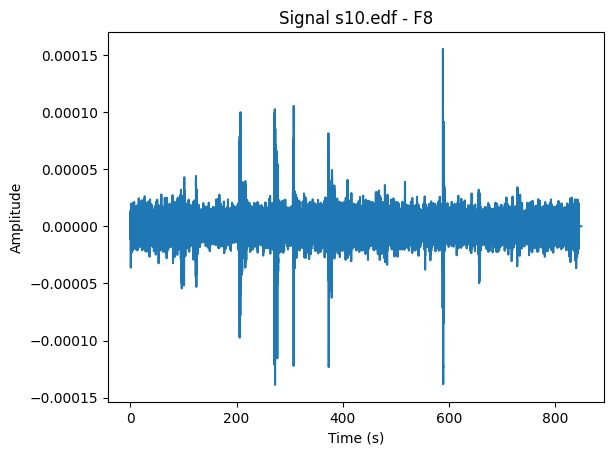

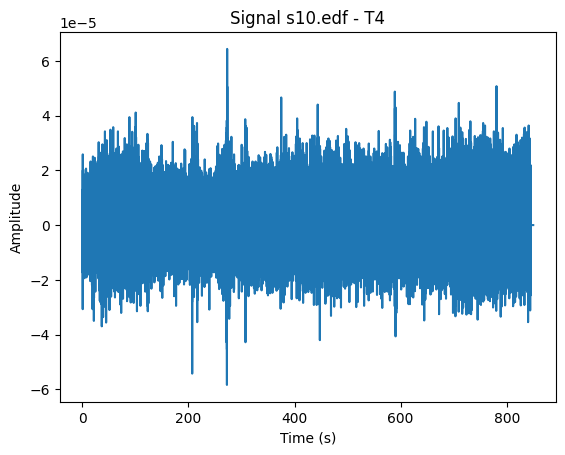

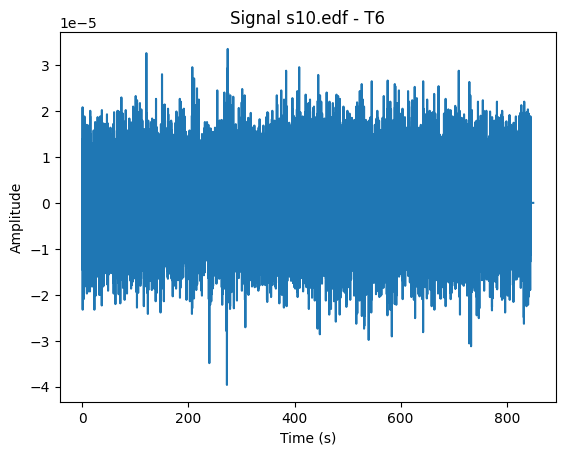

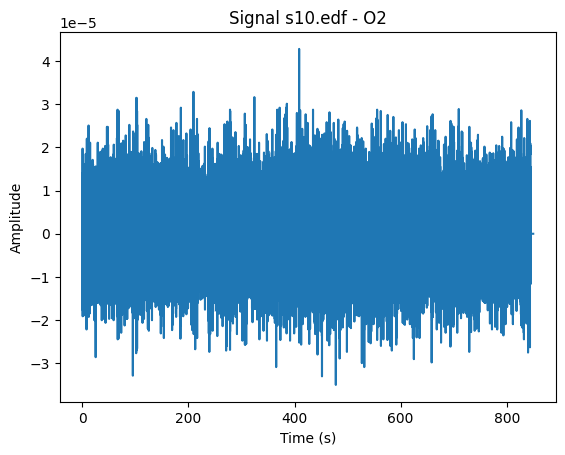

...

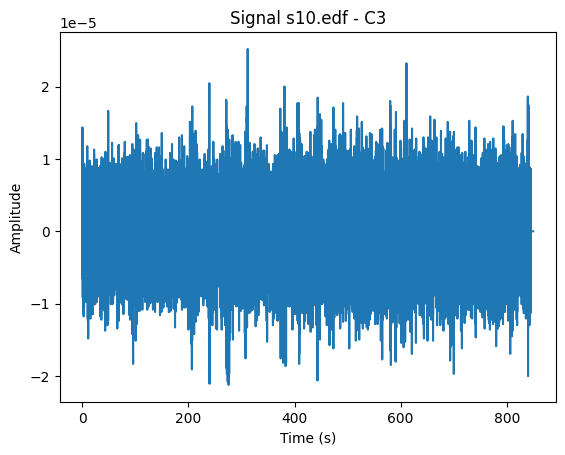

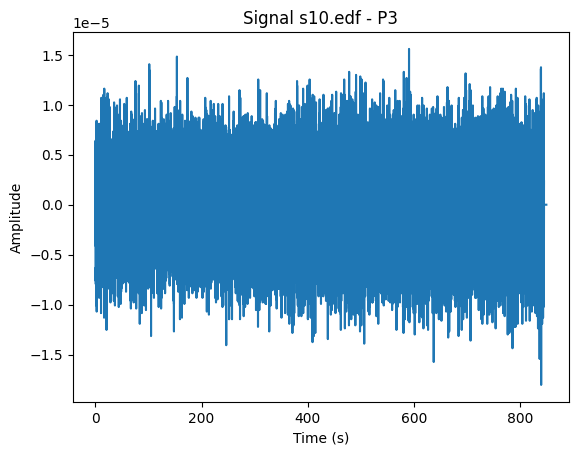

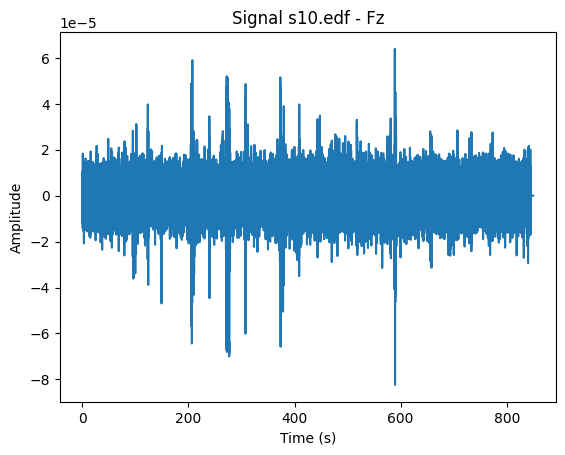

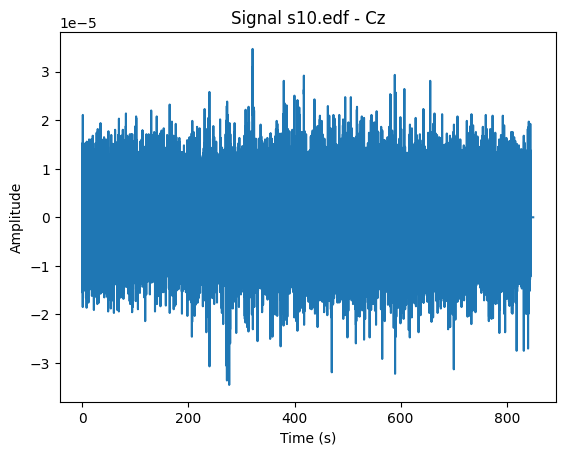

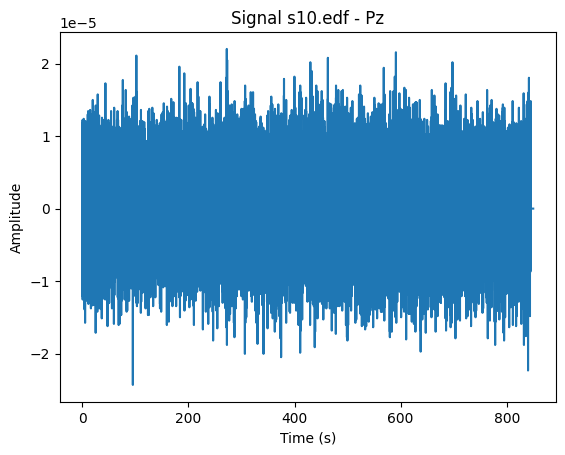

Extracting EDF parameters from /kaggle/input/eeg-data2/s08.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


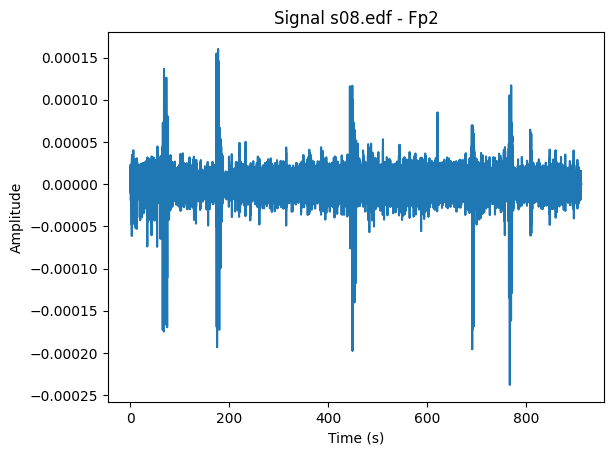

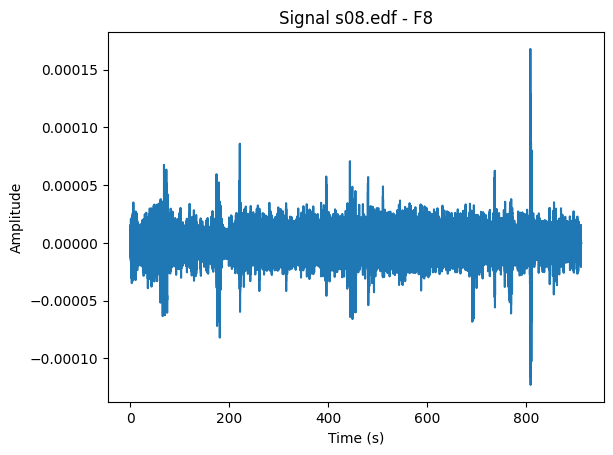

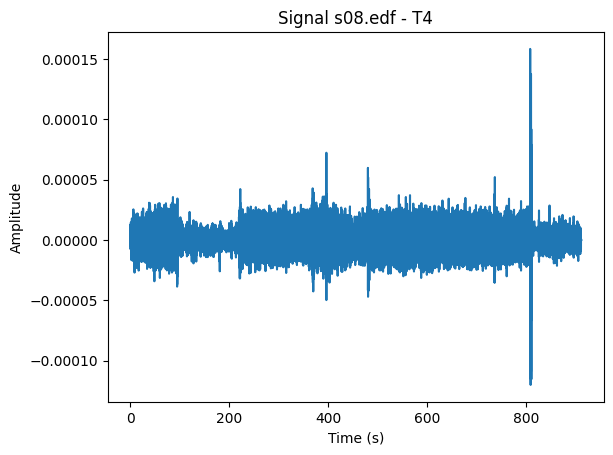

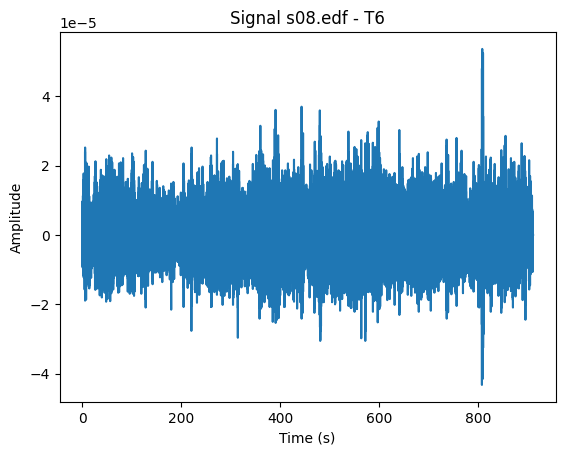

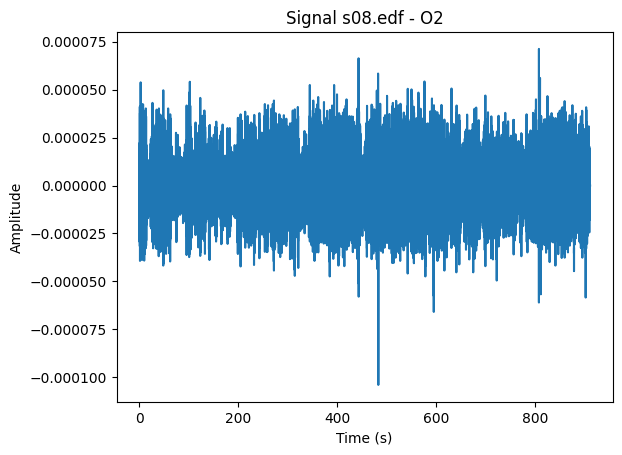

...

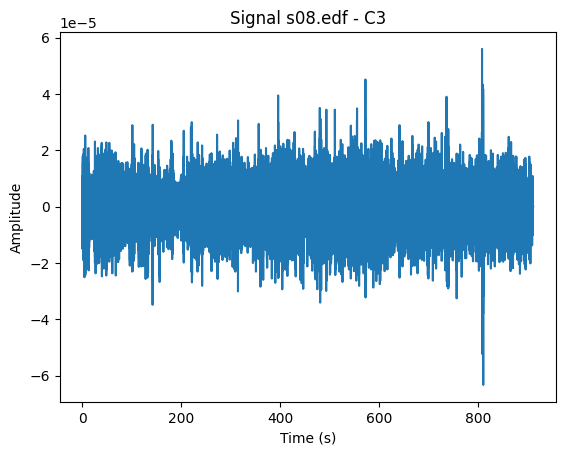

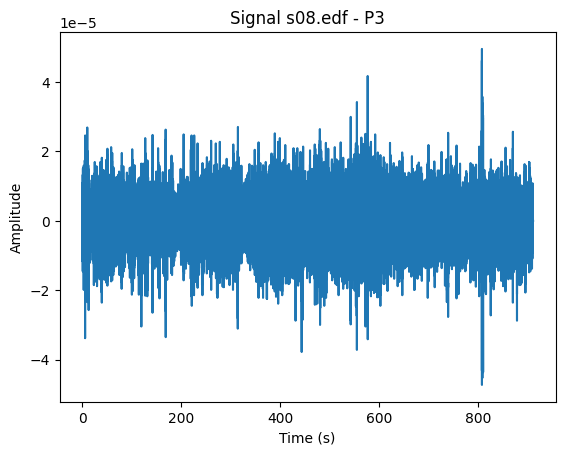

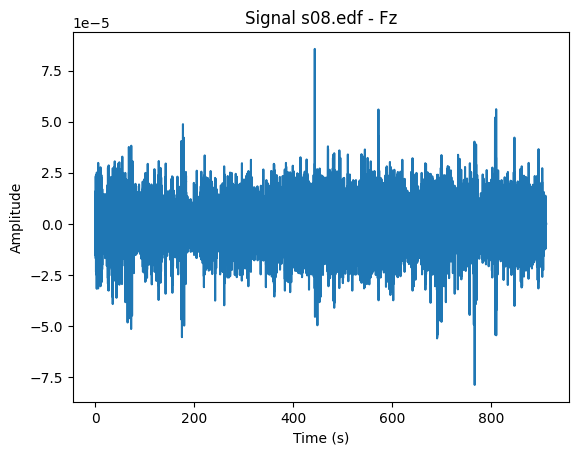

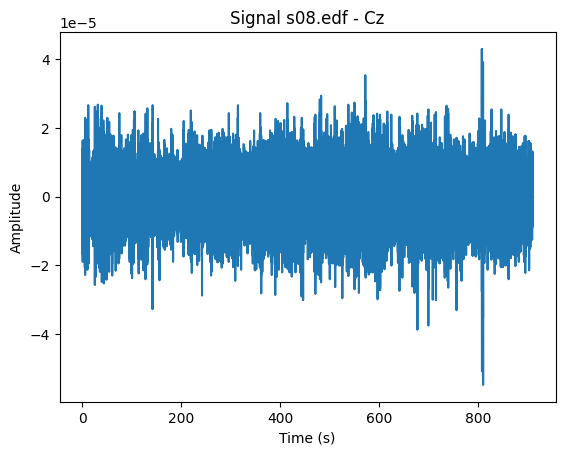

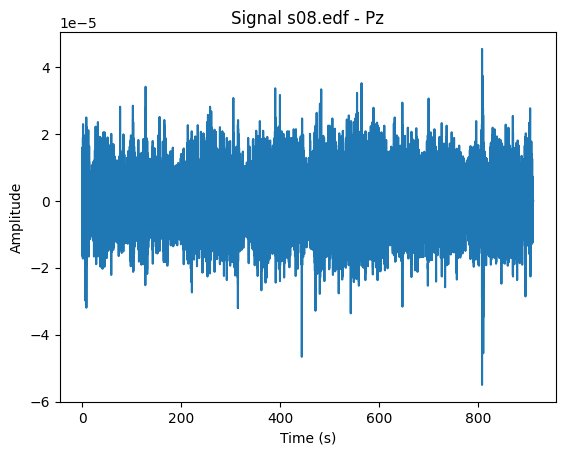

Extracting EDF parameters from /kaggle/input/eeg-data2/s06.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


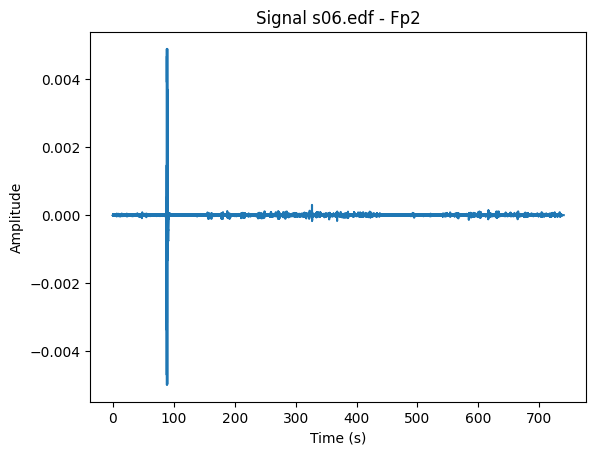

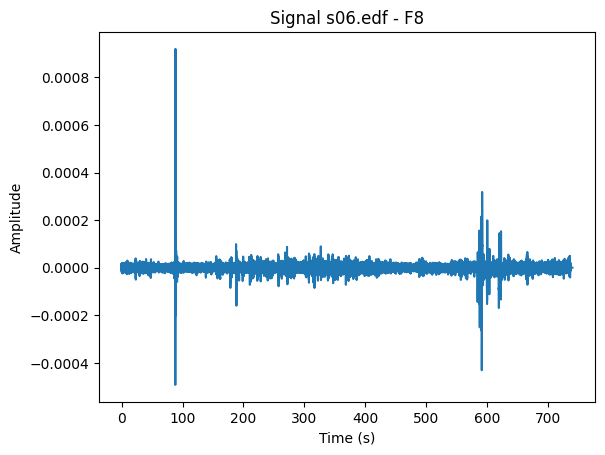

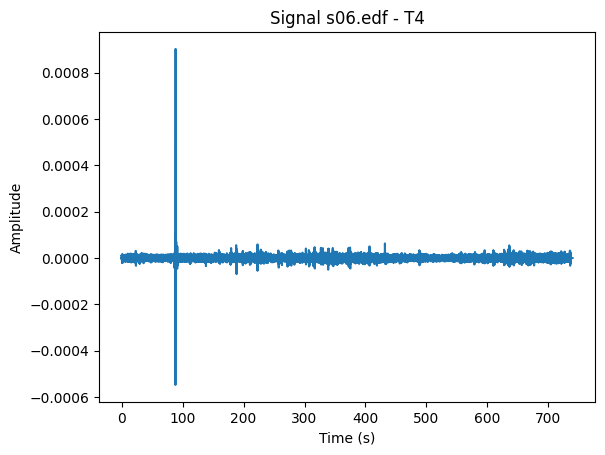

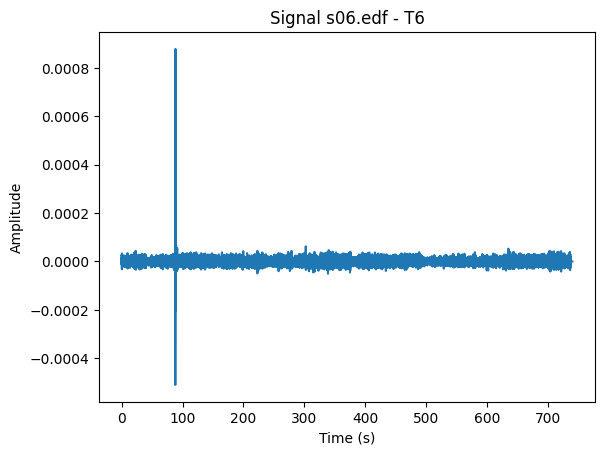

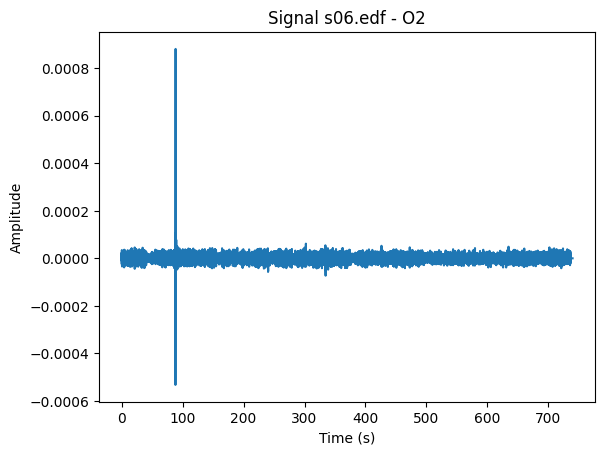

...

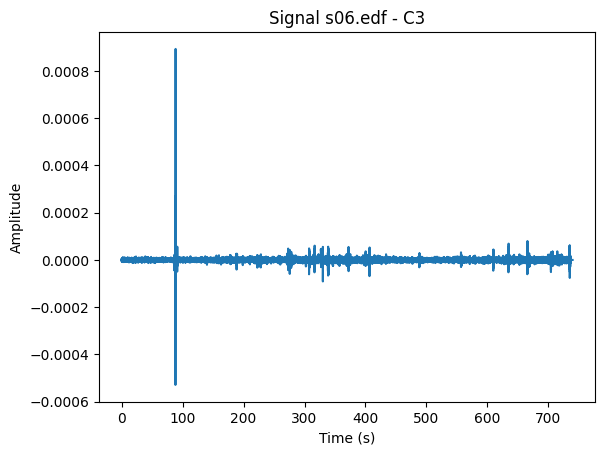

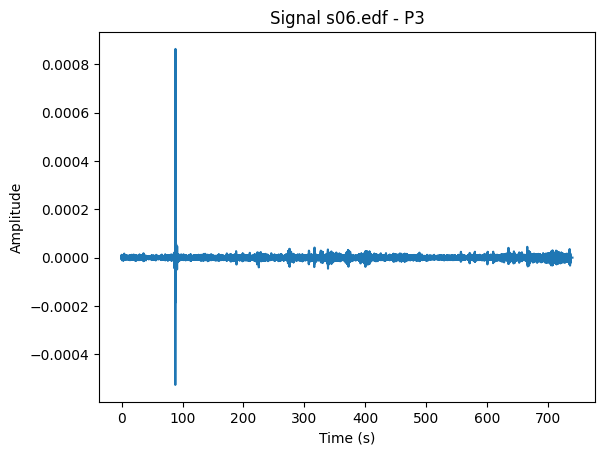

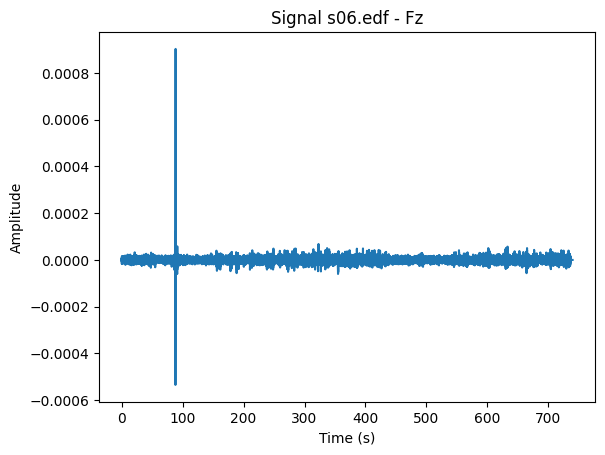

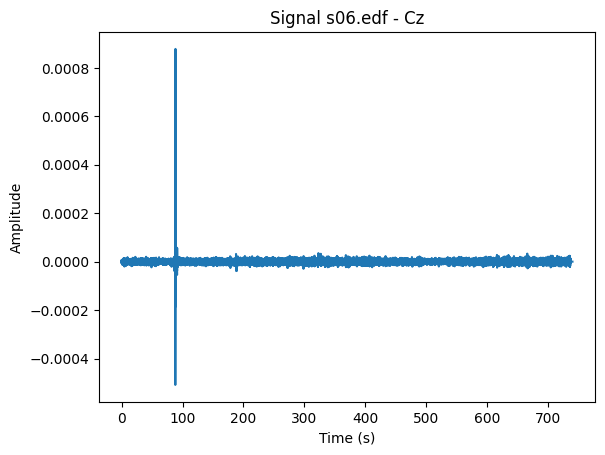

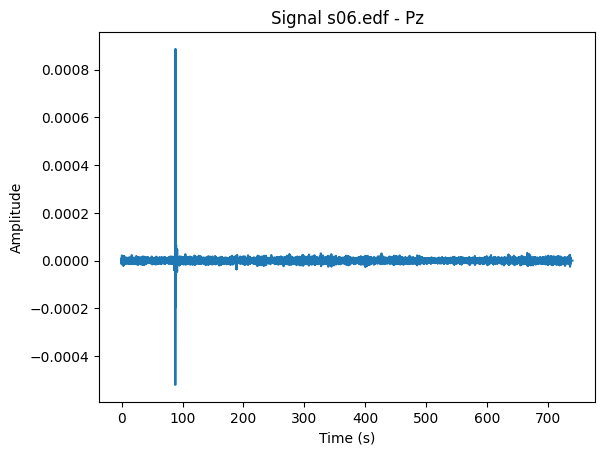

Extracting EDF parameters from /kaggle/input/eeg-data2/h04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


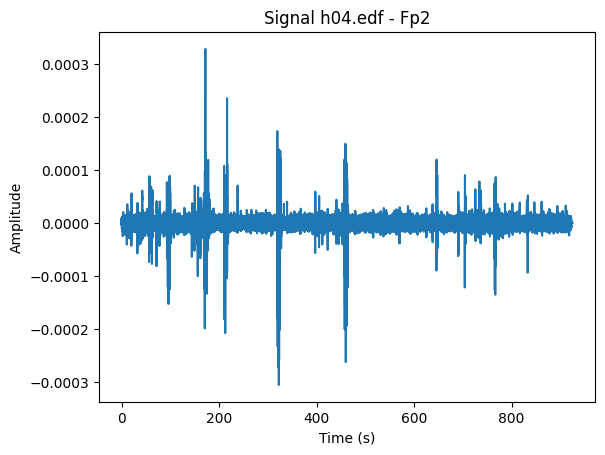

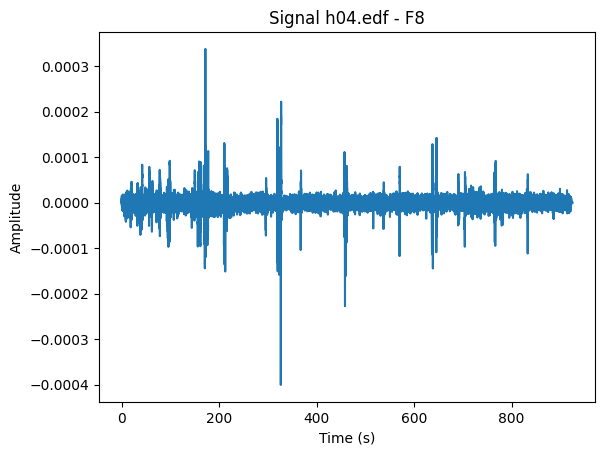

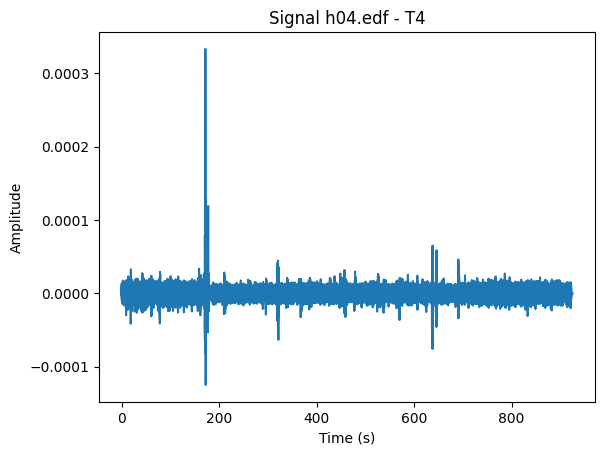

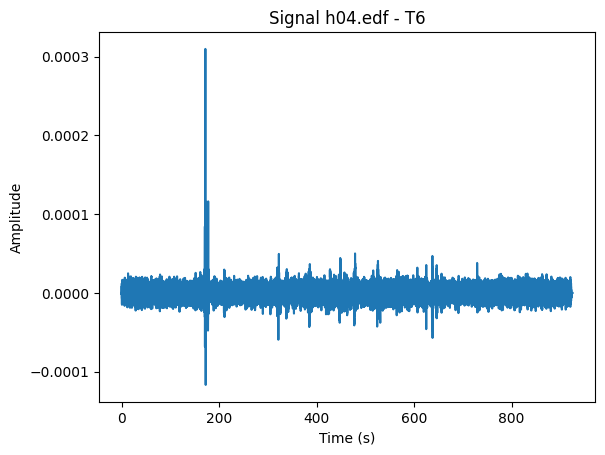

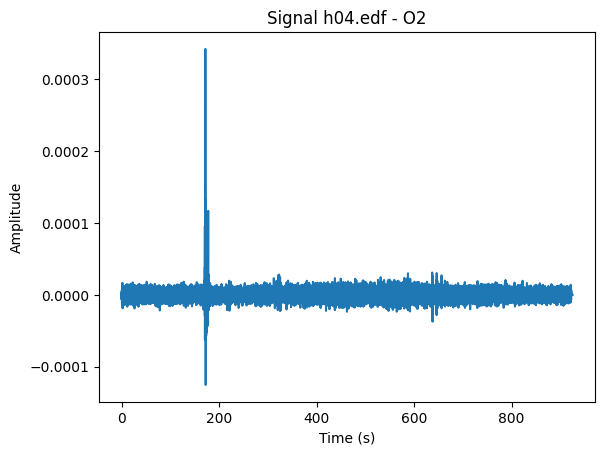

...

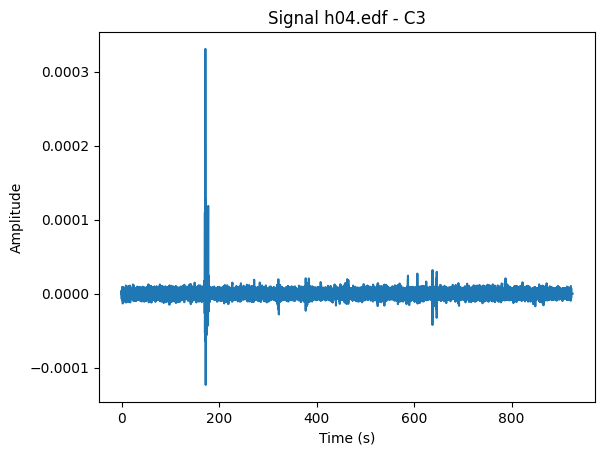

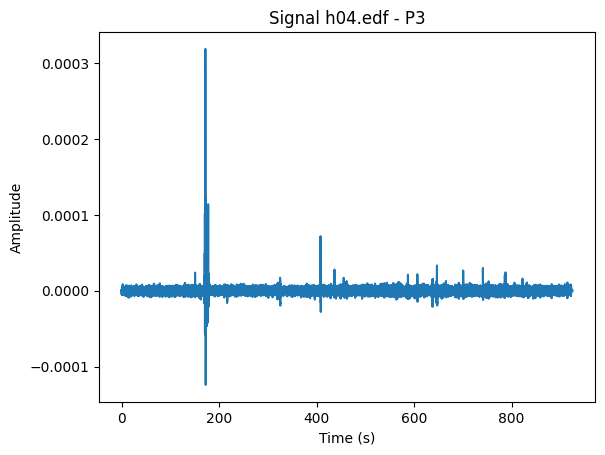

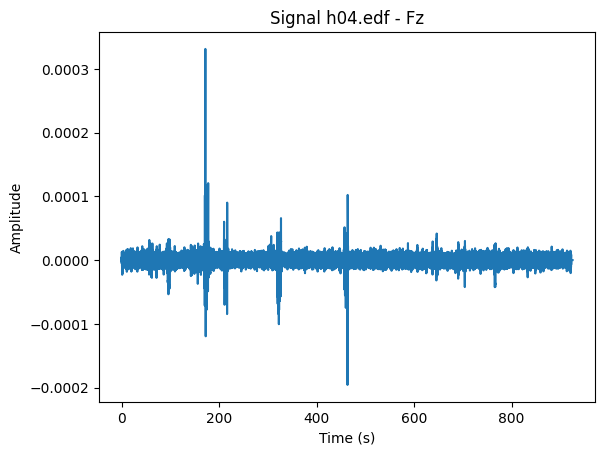

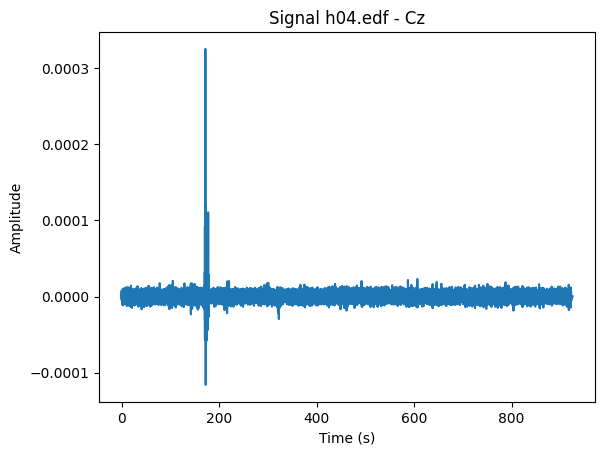

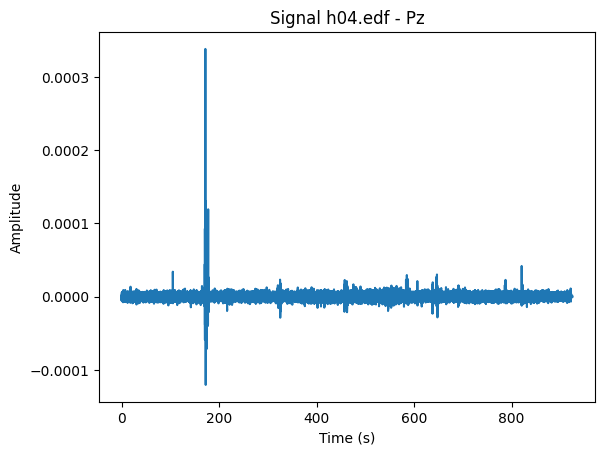

Extracting EDF parameters from /kaggle/input/eeg-data2/h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


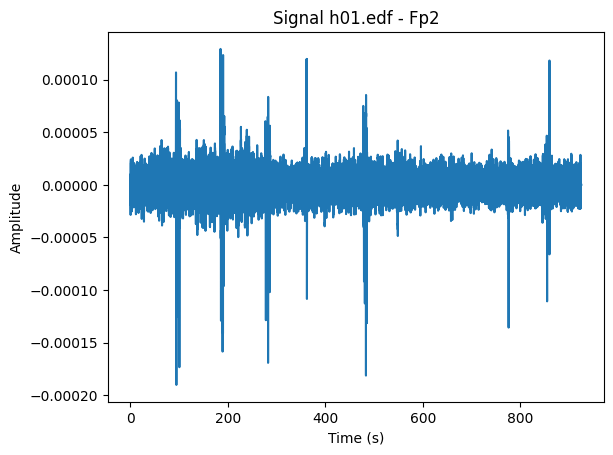

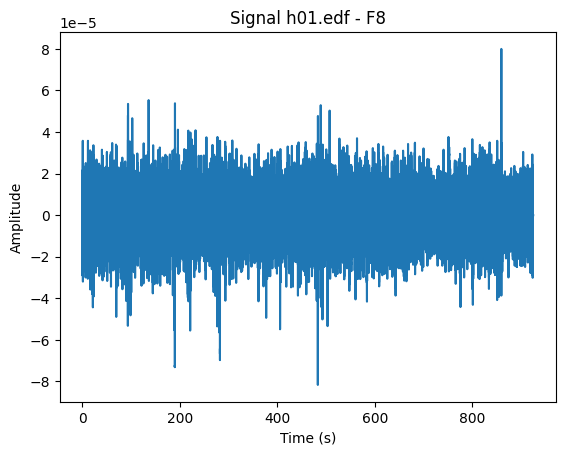

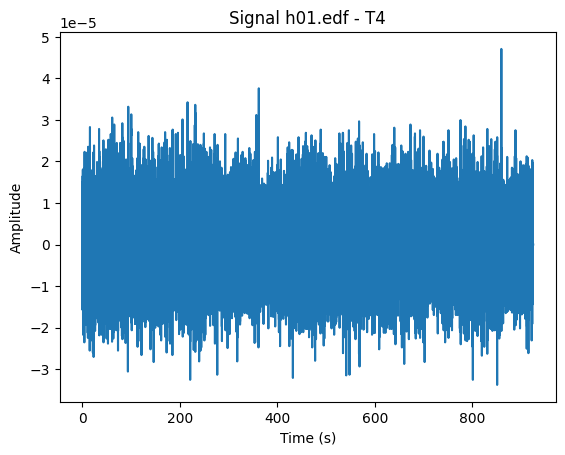

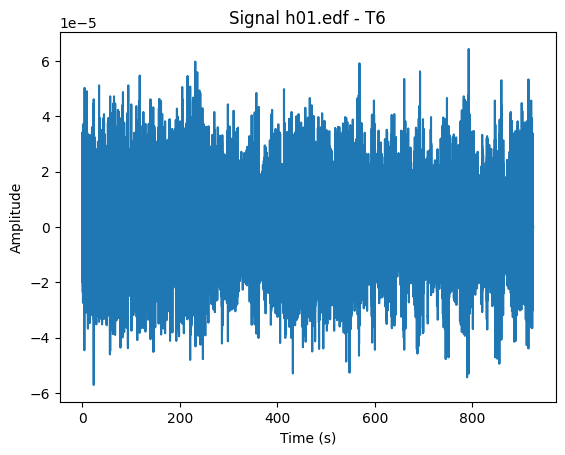

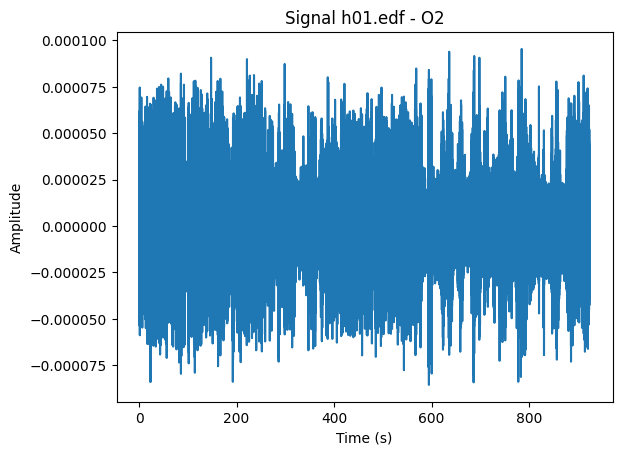

...

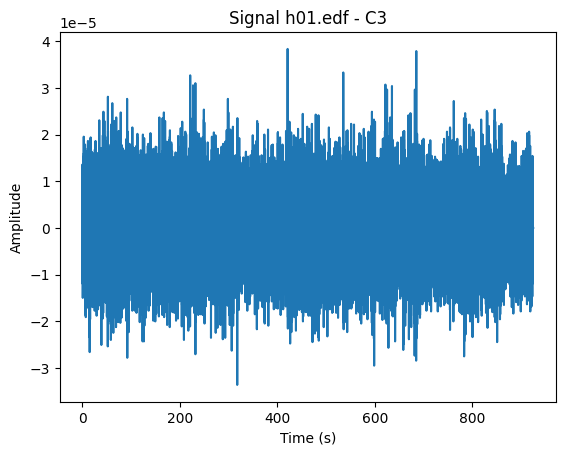

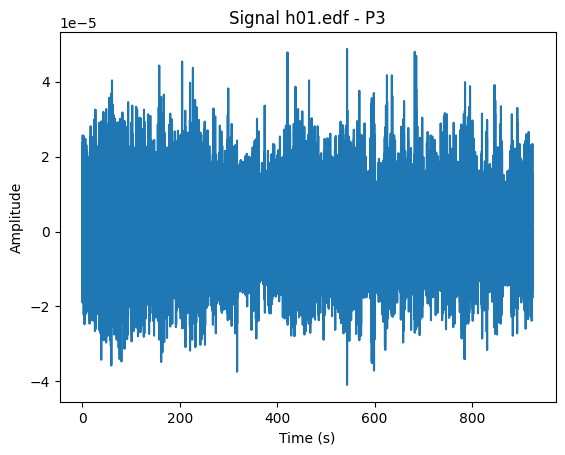

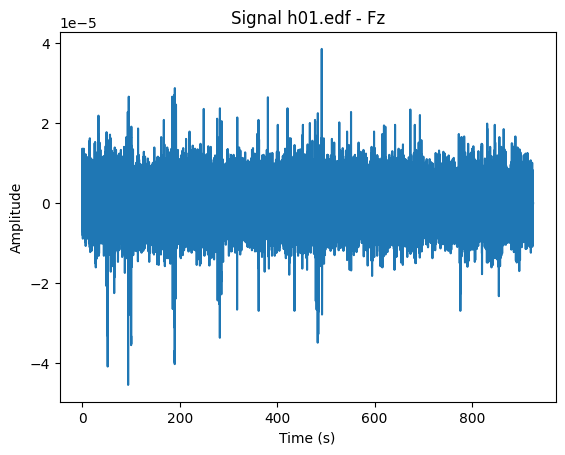

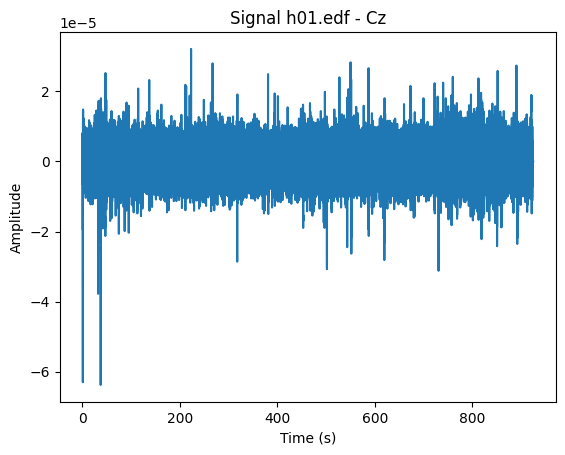

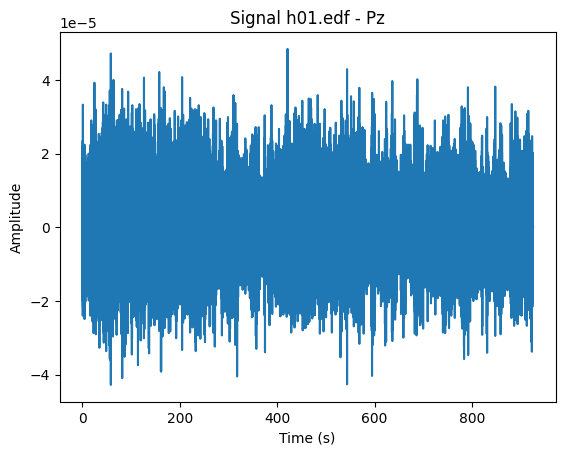

Extracting EDF parameters from /kaggle/input/eeg-data2/s01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


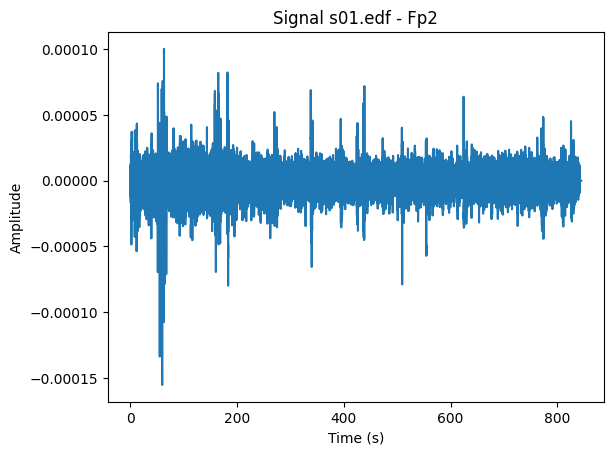

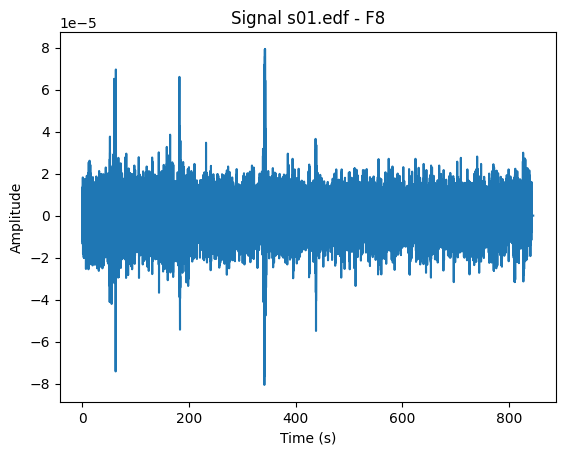

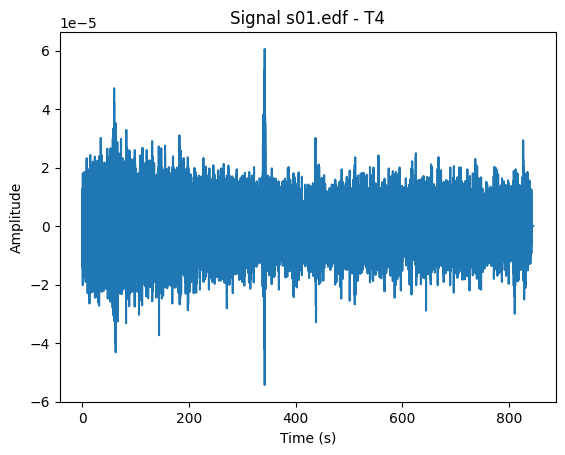

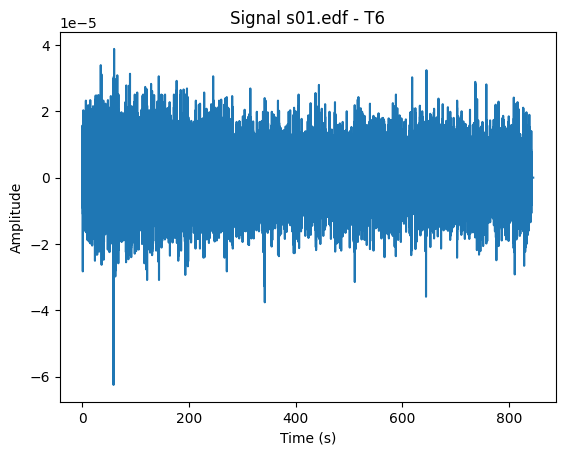

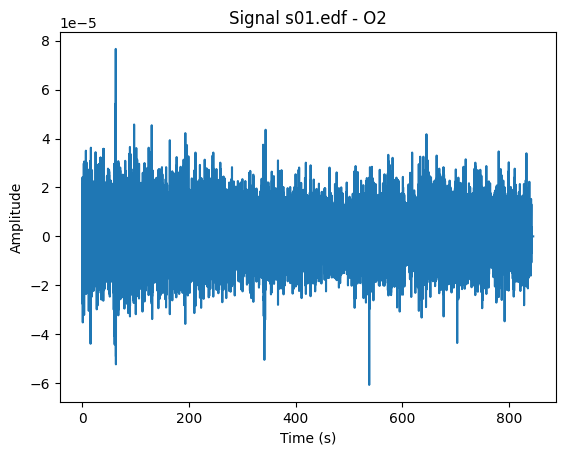

...

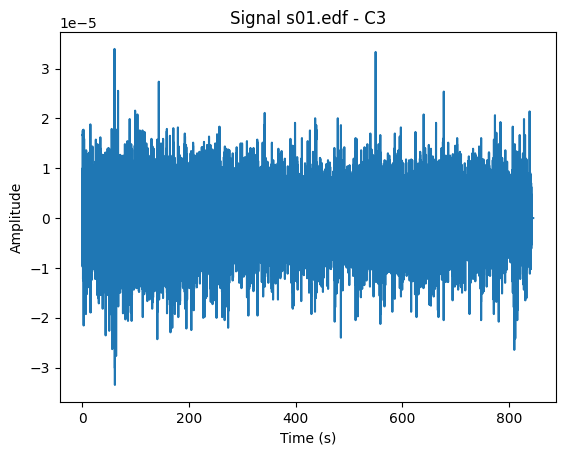

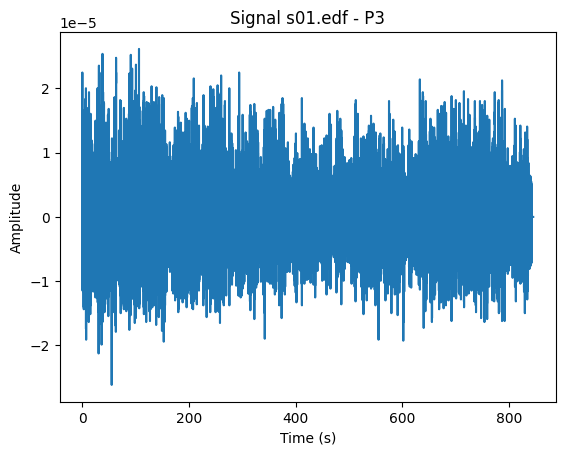

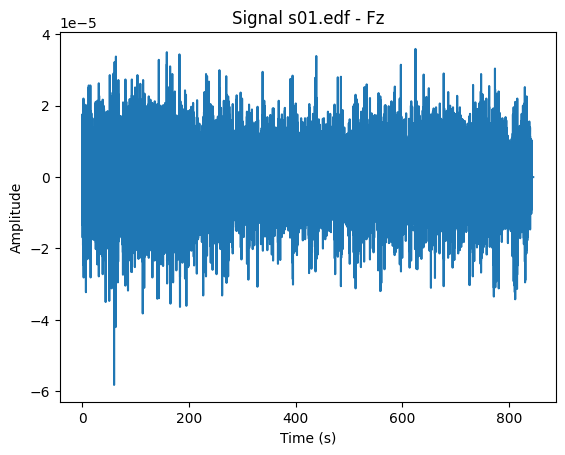

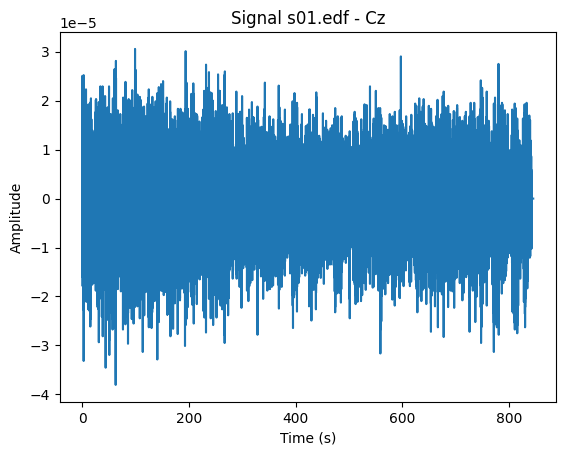

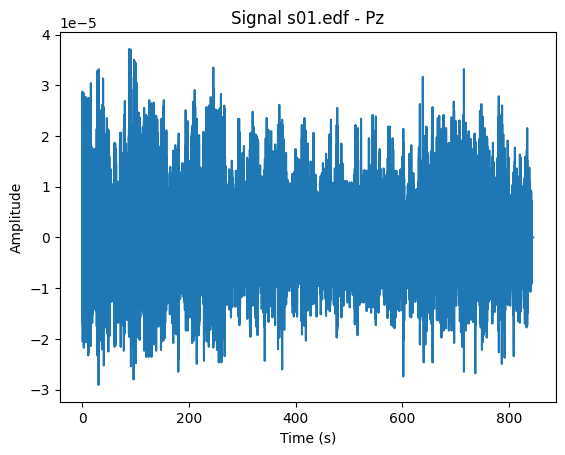

Extracting EDF parameters from /kaggle/input/eeg-data2/h13.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


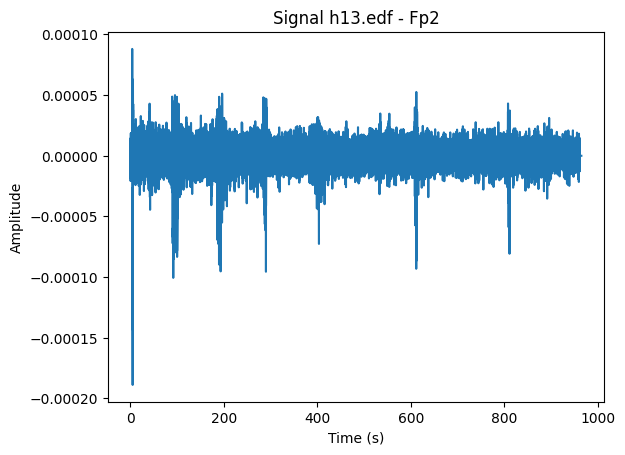

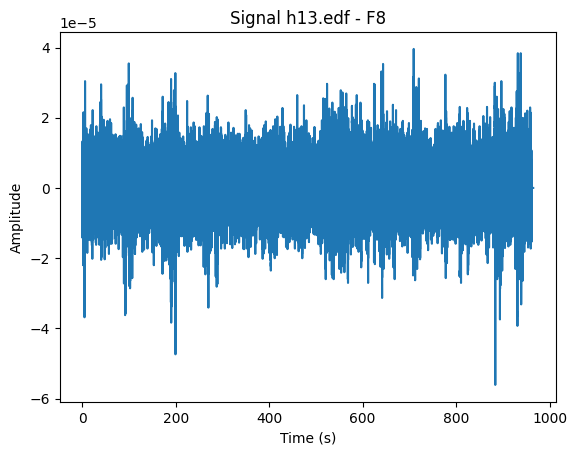

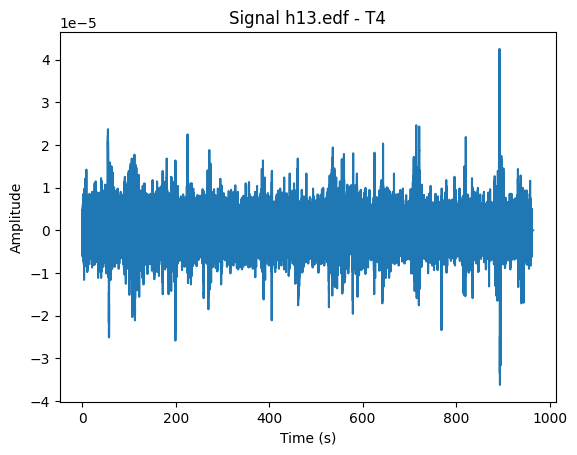

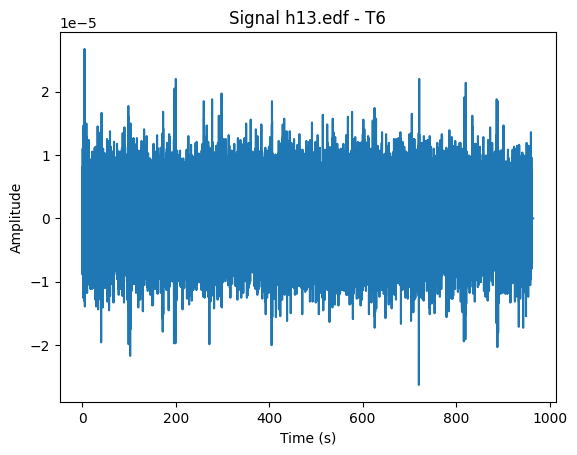

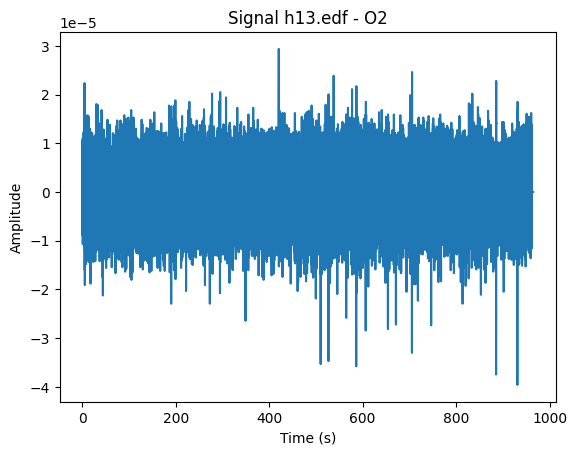

...

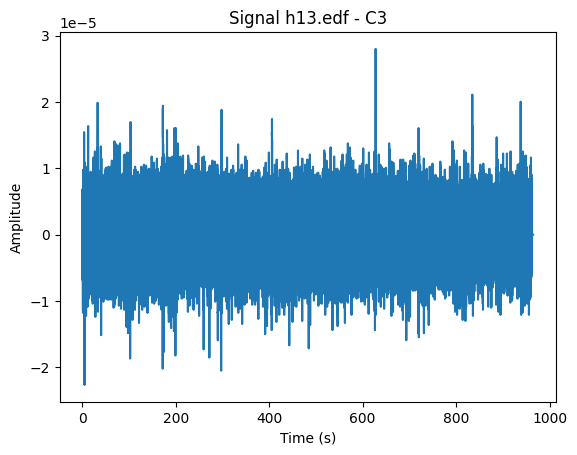

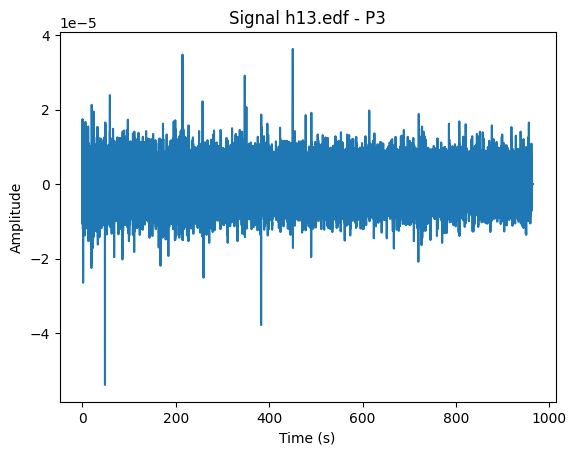

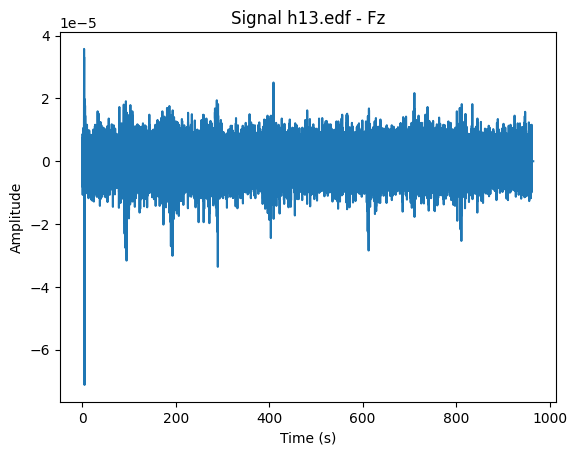

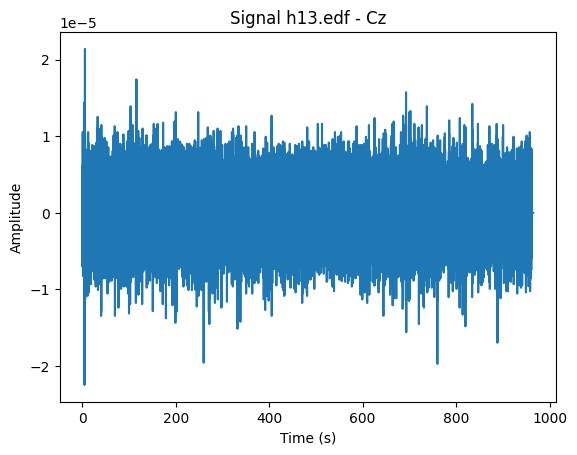

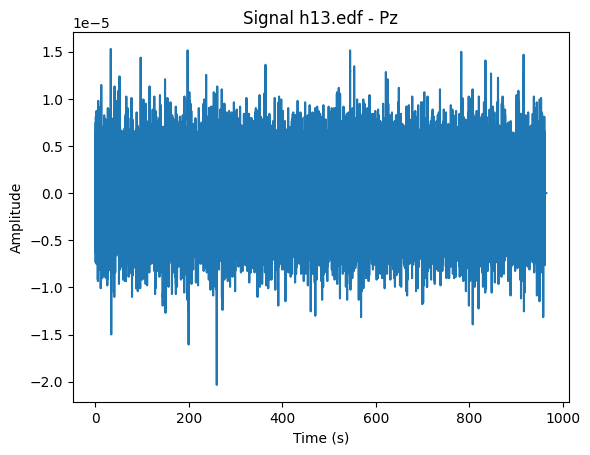

Extracting EDF parameters from /kaggle/input/eeg-data2/s09.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


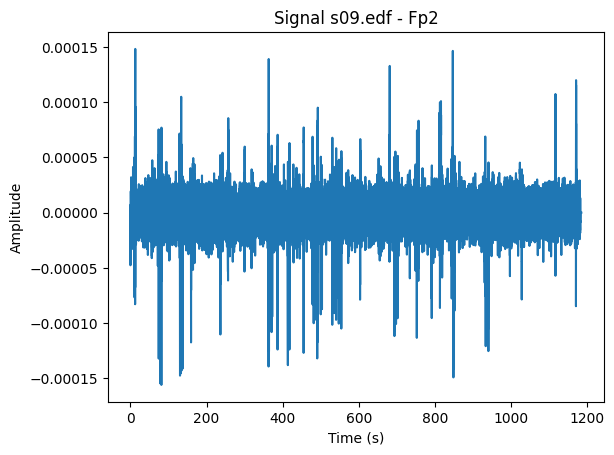

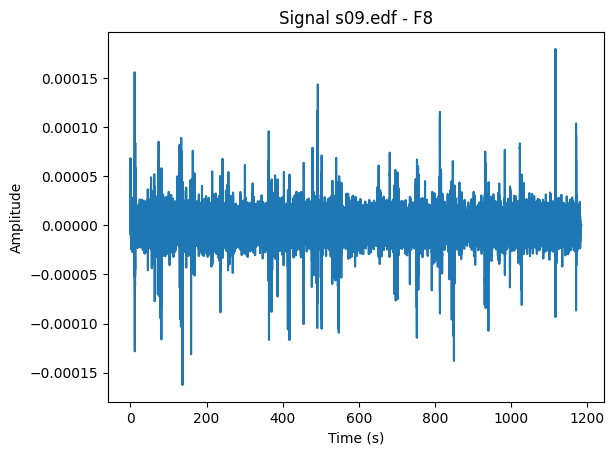

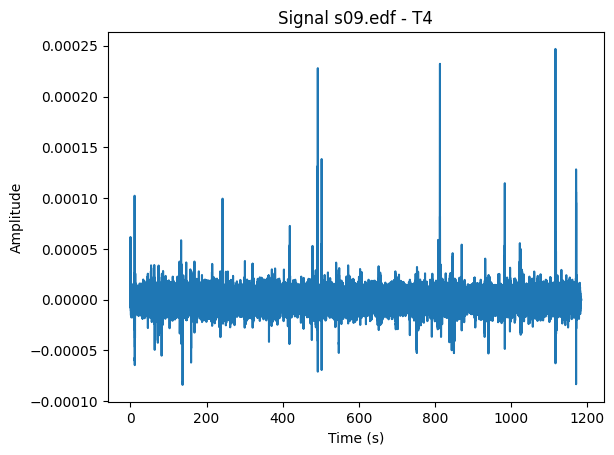

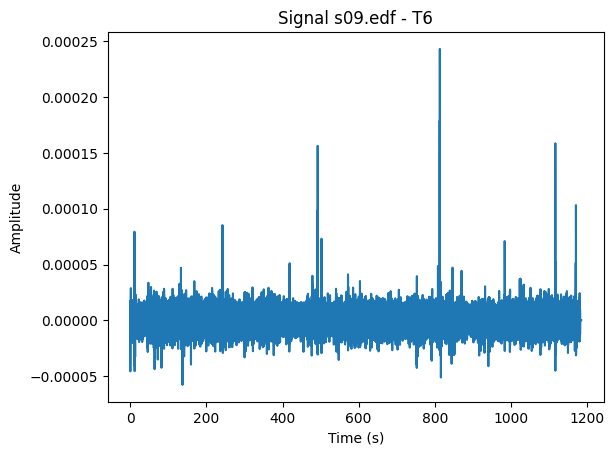

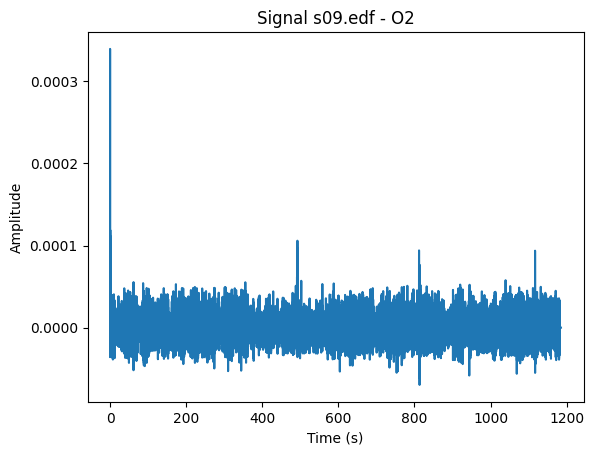

...

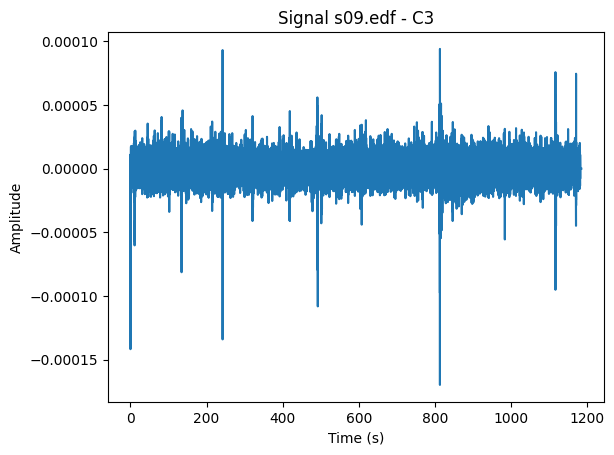

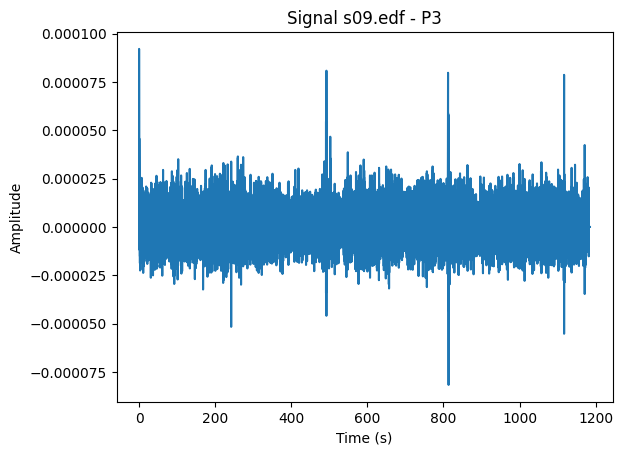

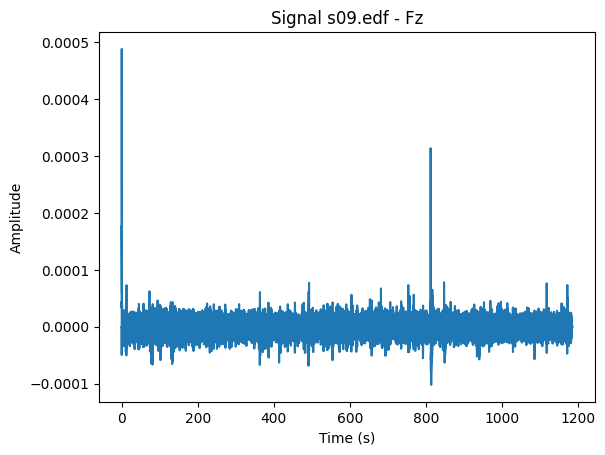

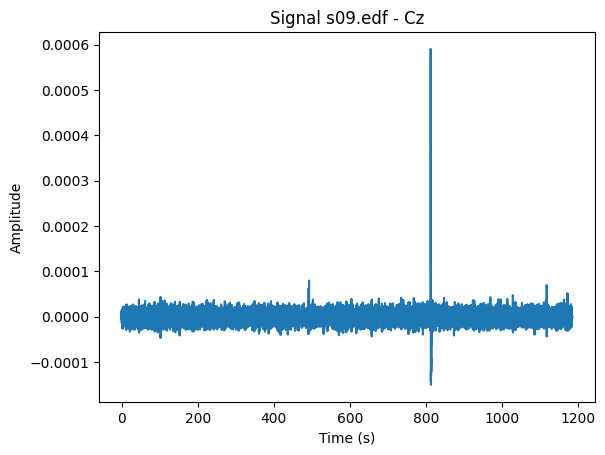

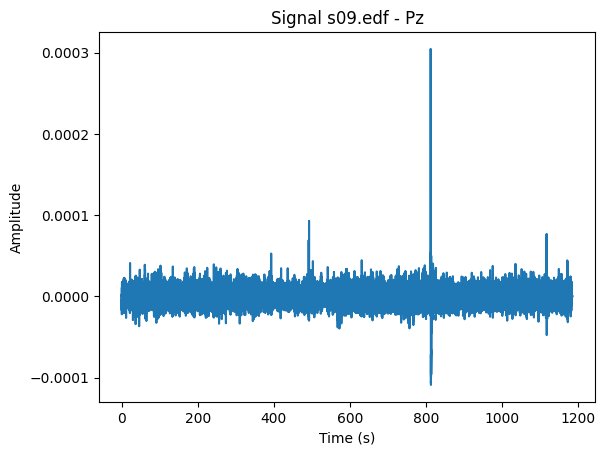

Extracting EDF parameters from /kaggle/input/eeg-data2/s05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


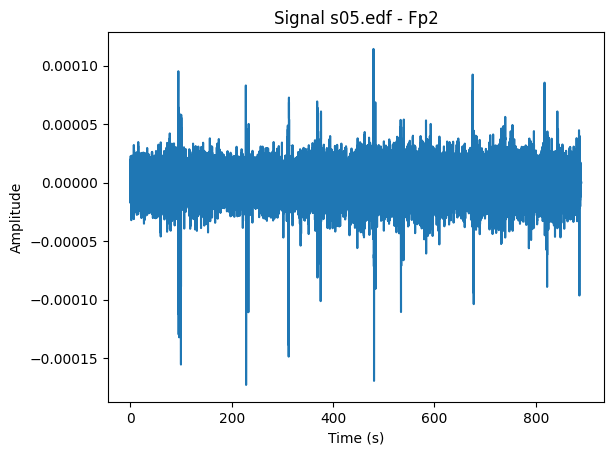

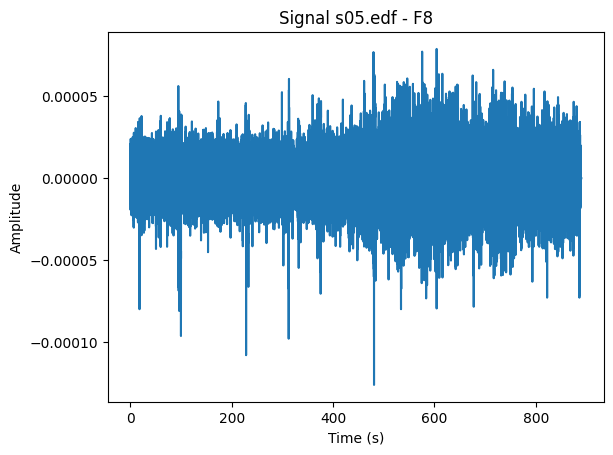

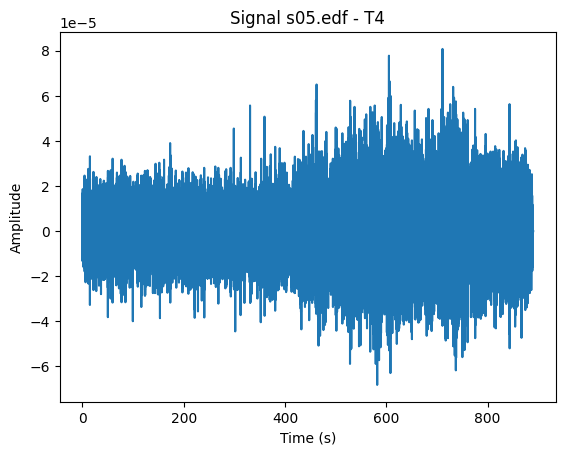

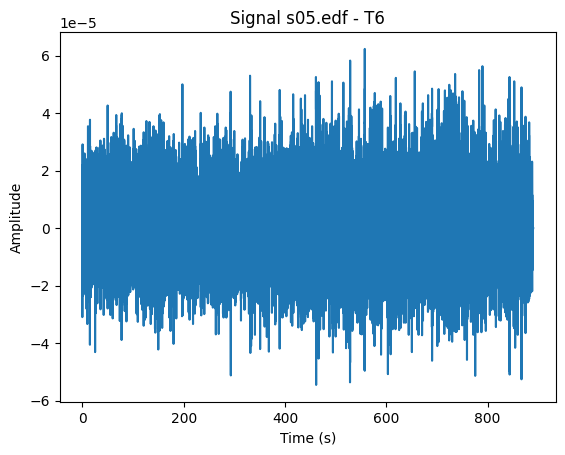

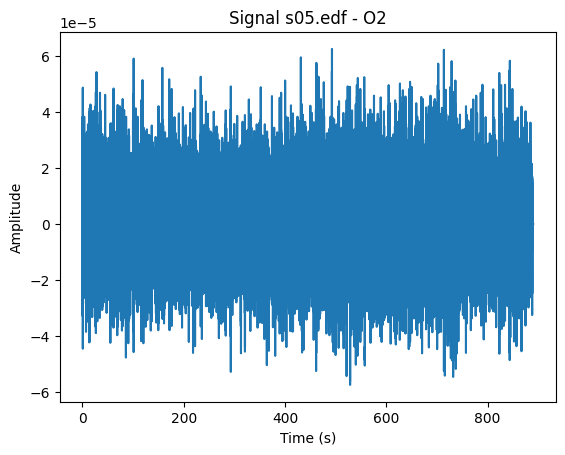

...

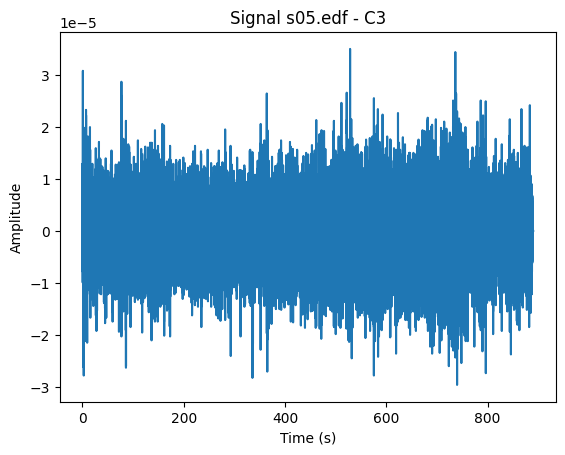

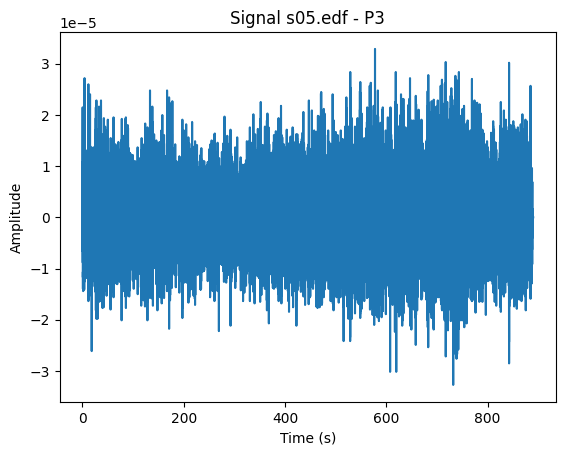

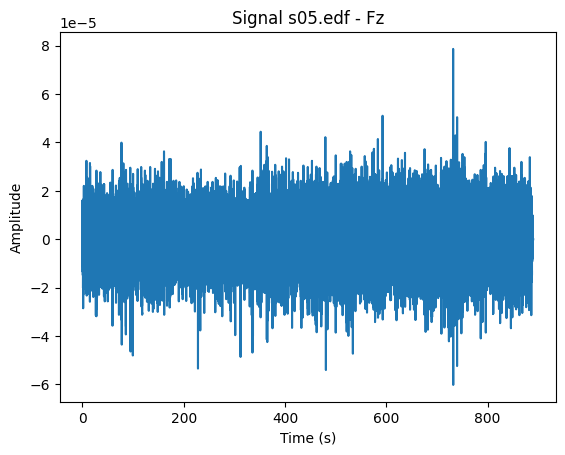

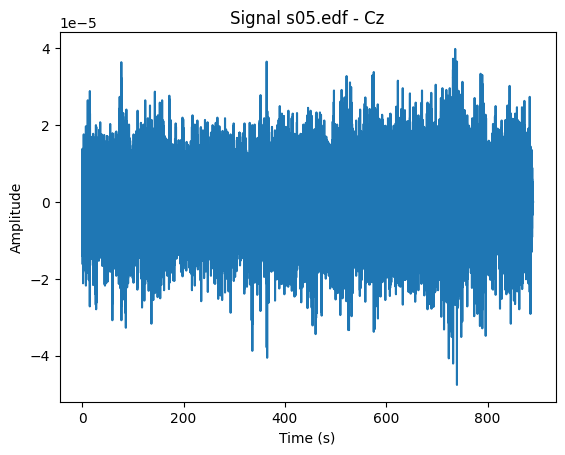

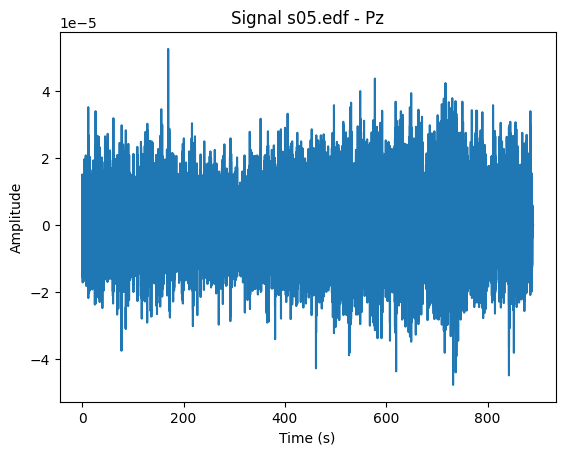

Extracting EDF parameters from /kaggle/input/eeg-data2/h10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


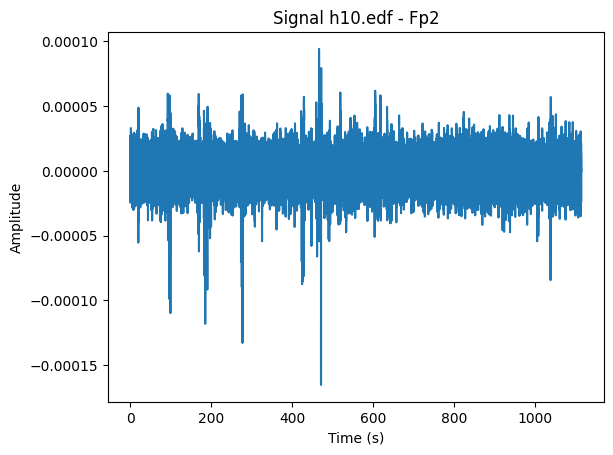

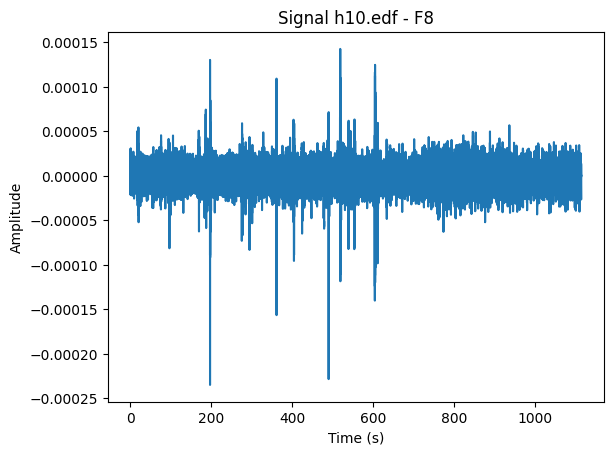

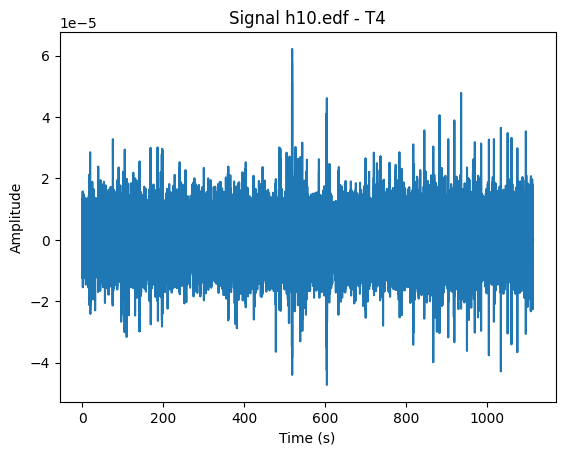

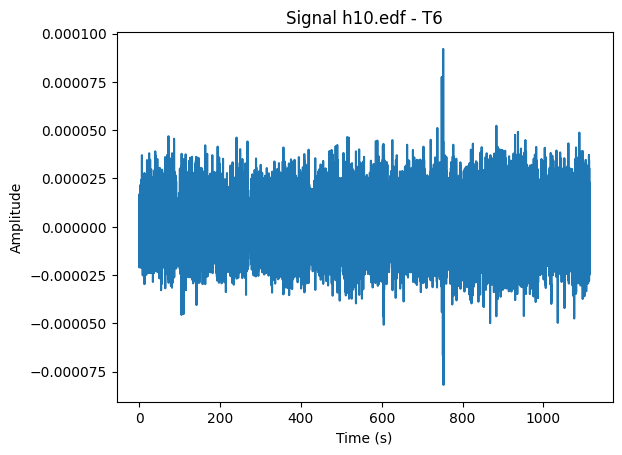

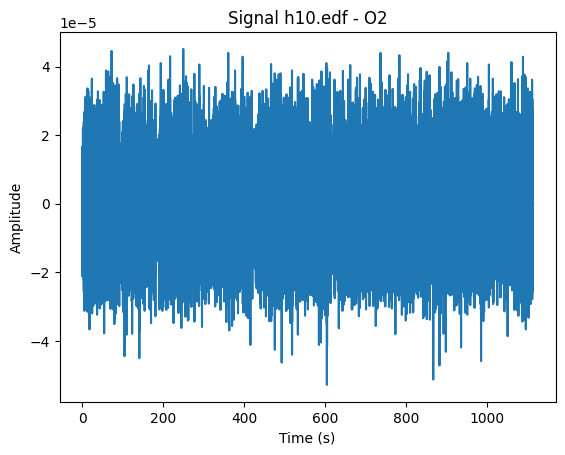

...

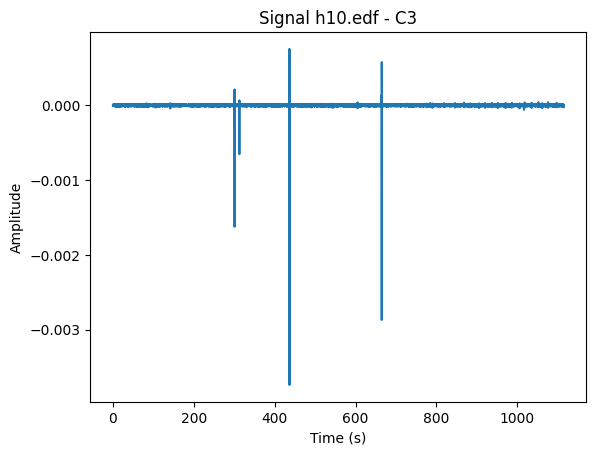

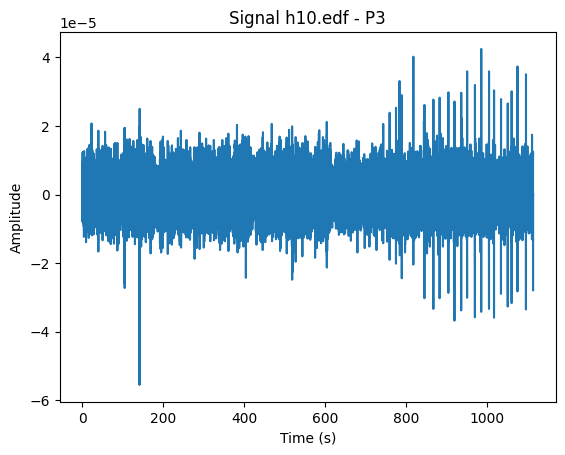

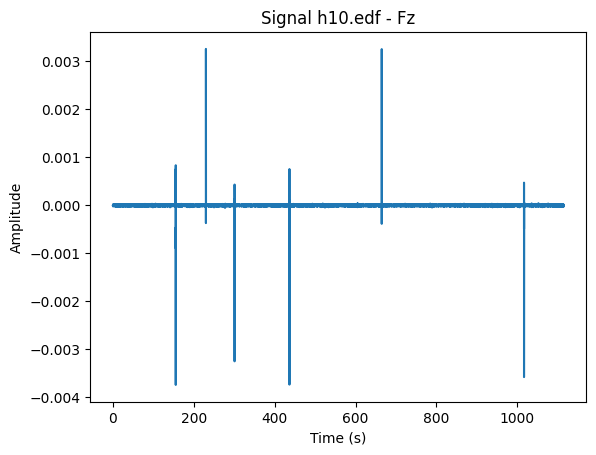

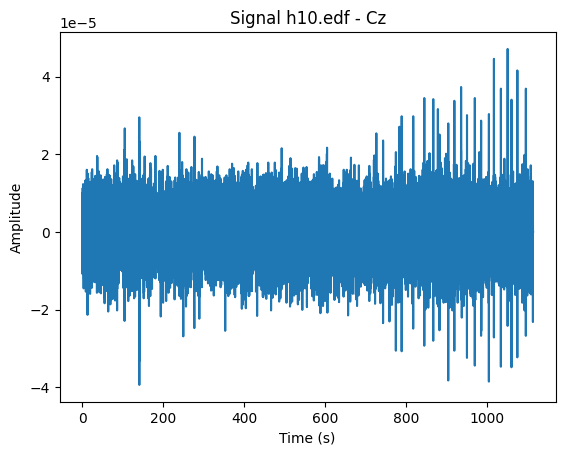

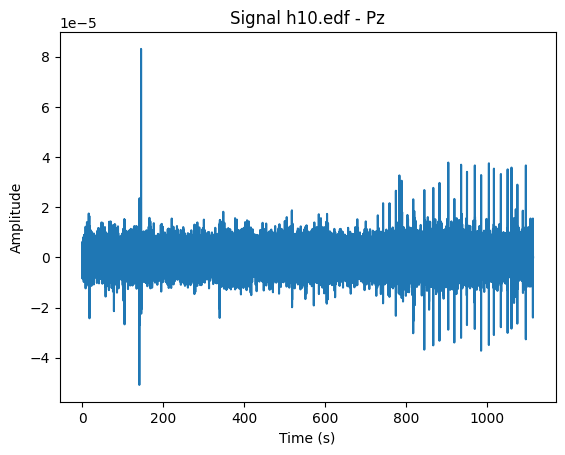

Extracting EDF parameters from /kaggle/input/eeg-data2/s02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


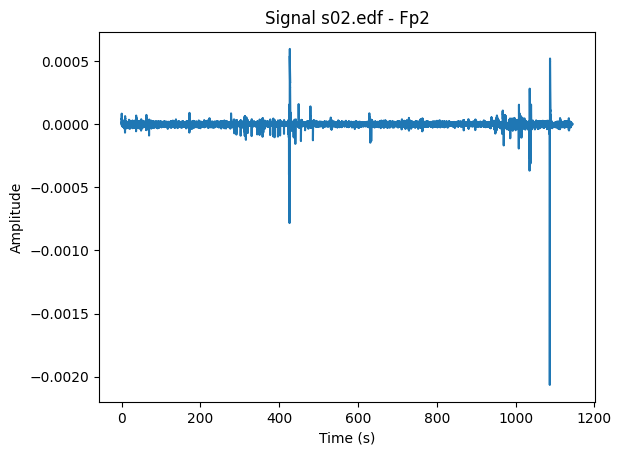

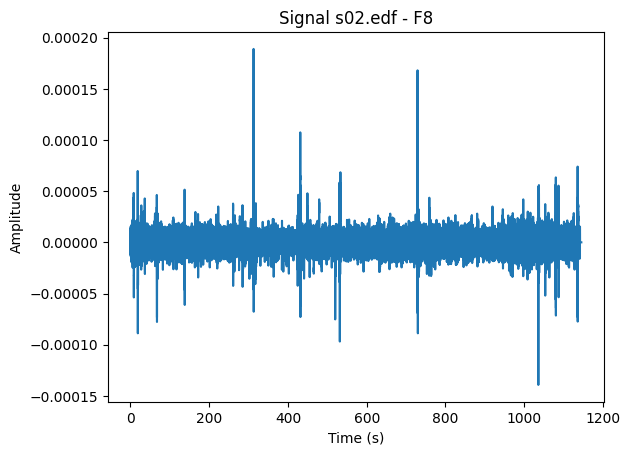

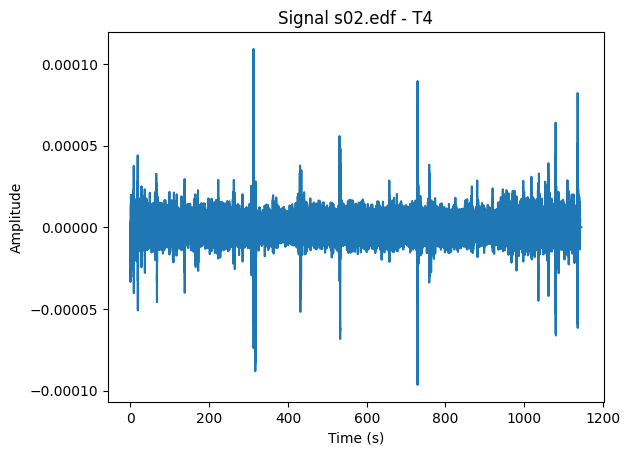

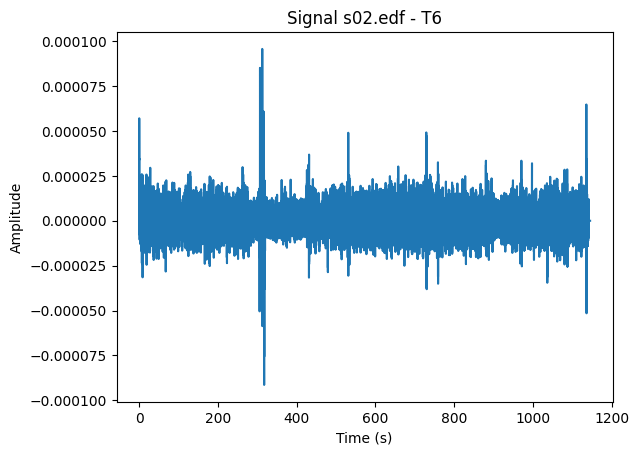

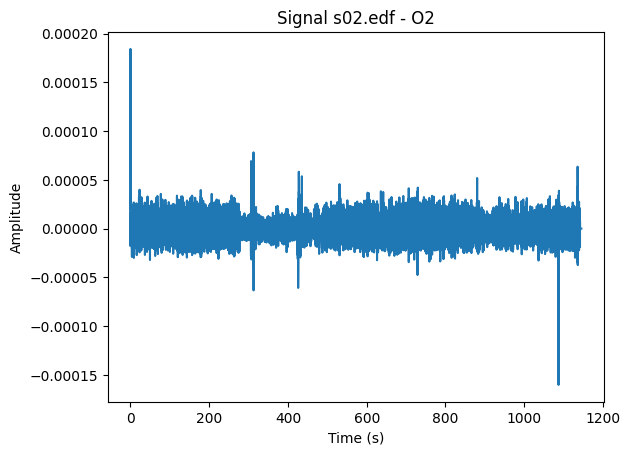

...

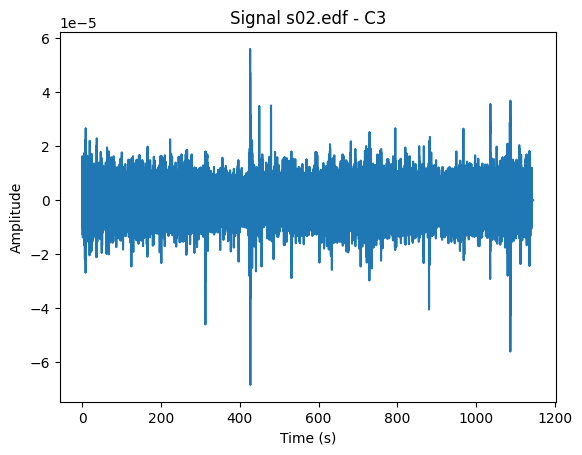

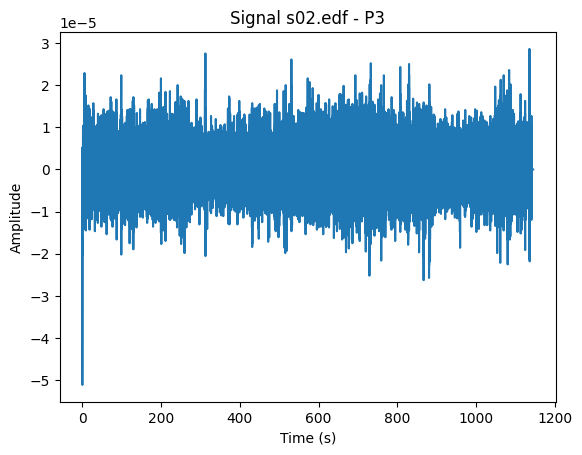

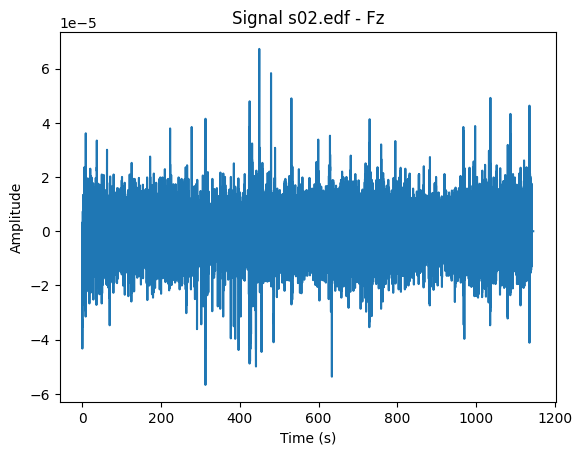

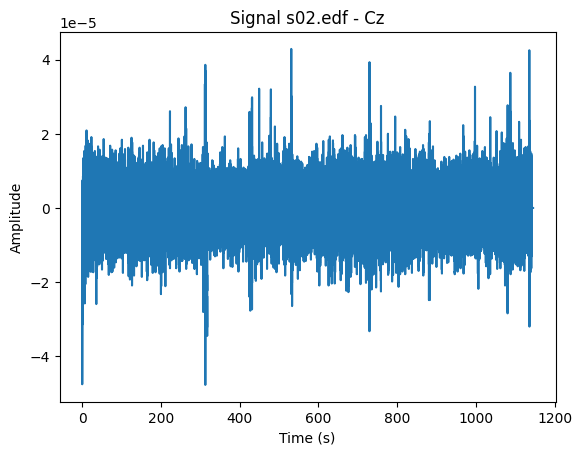

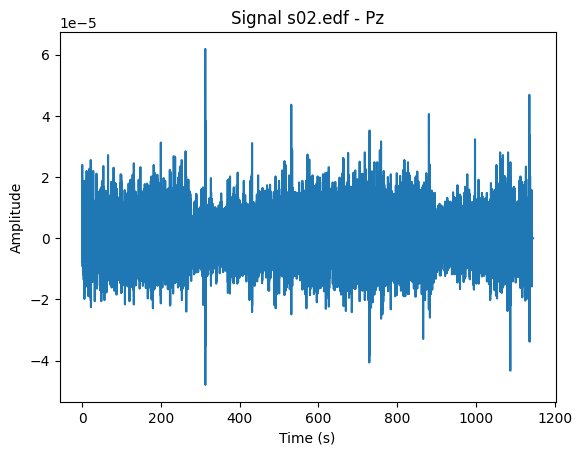

Extracting EDF parameters from /kaggle/input/eeg-data2/s07.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


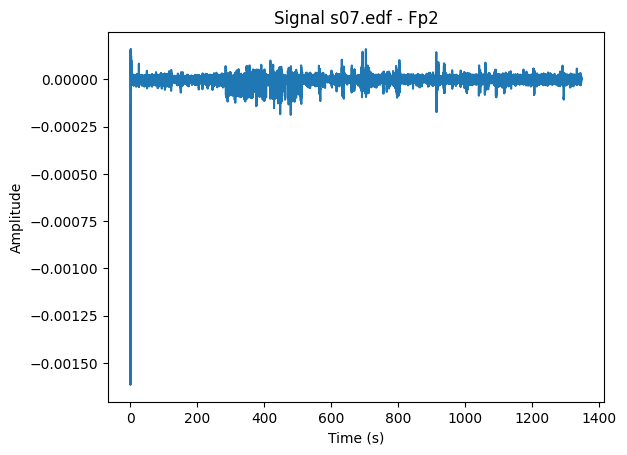

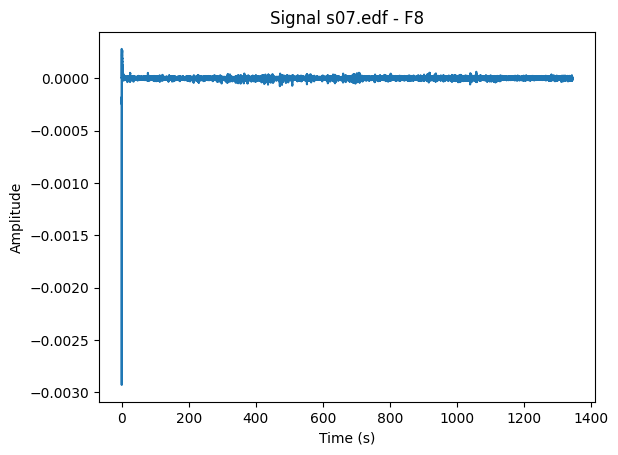

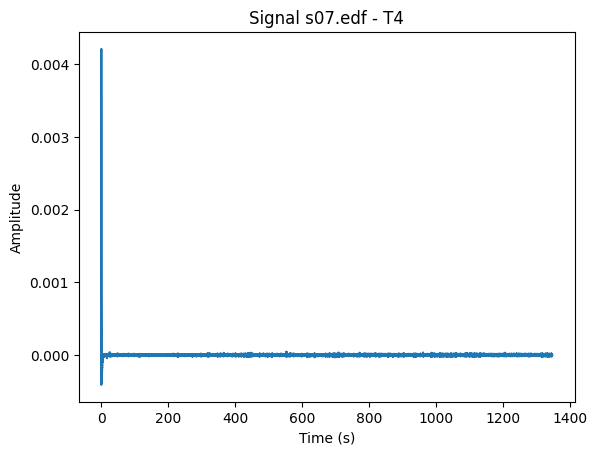

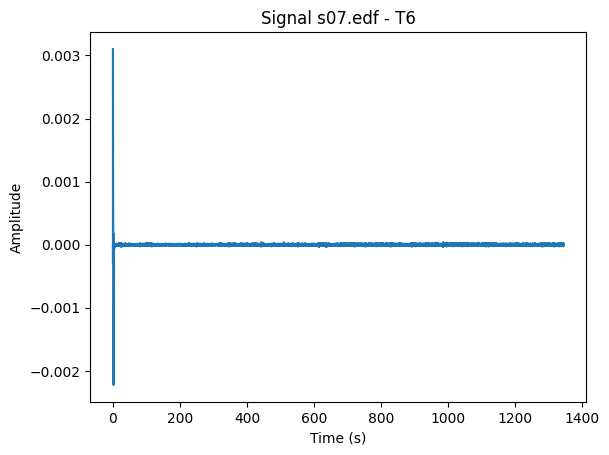

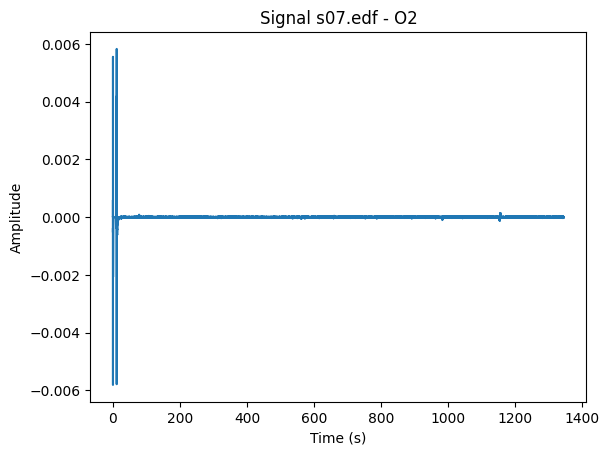

...

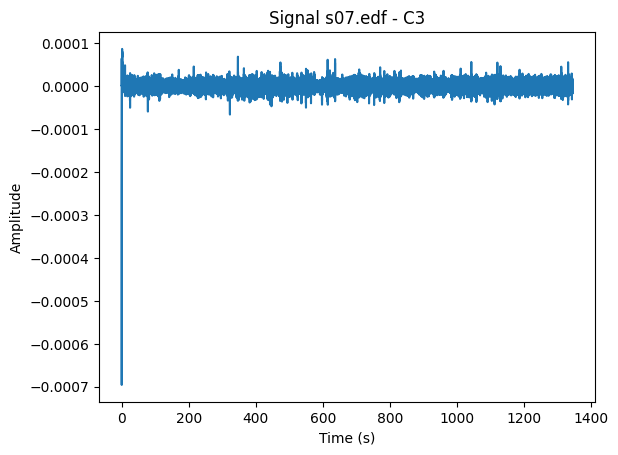

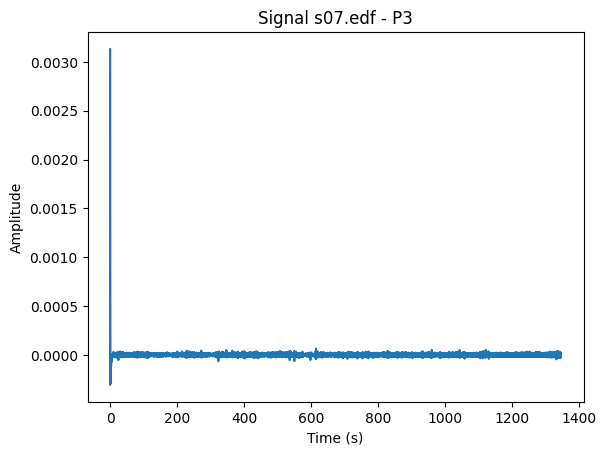

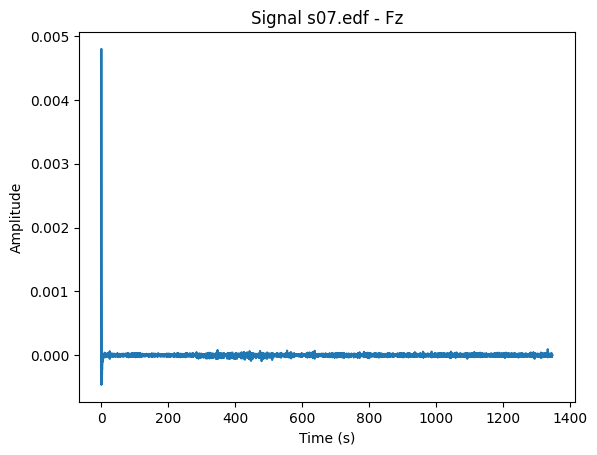

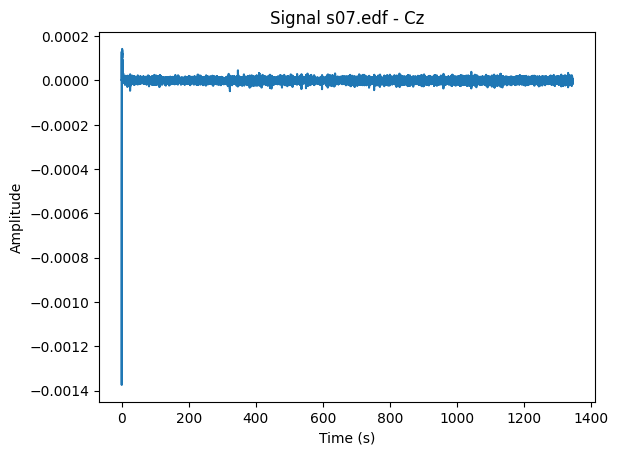

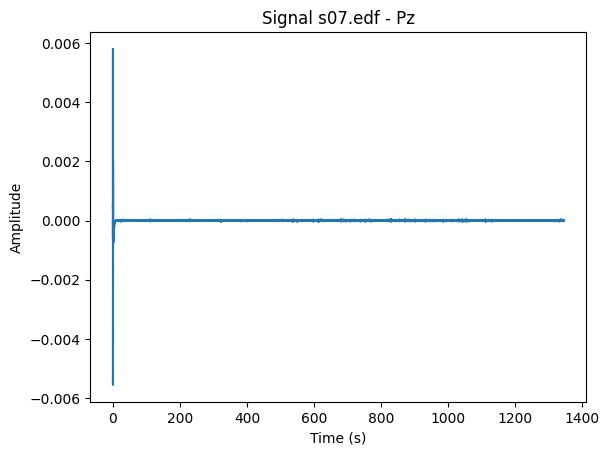

Extracting EDF parameters from /kaggle/input/eeg-data2/s14.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


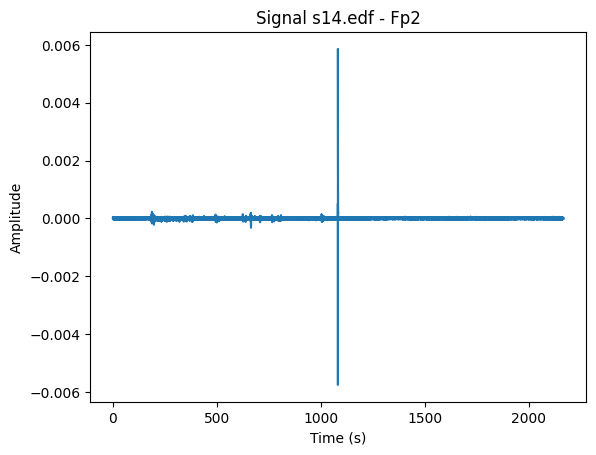

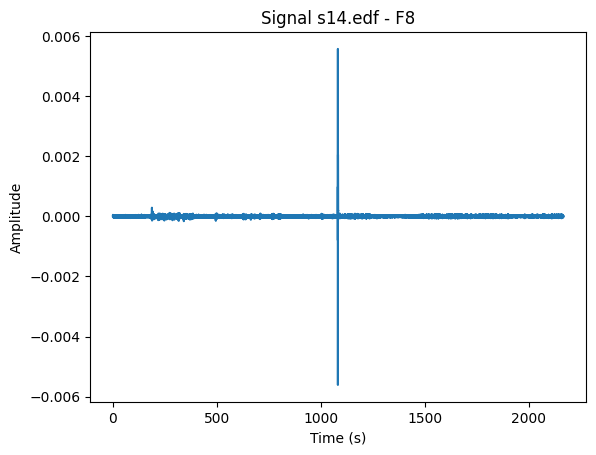

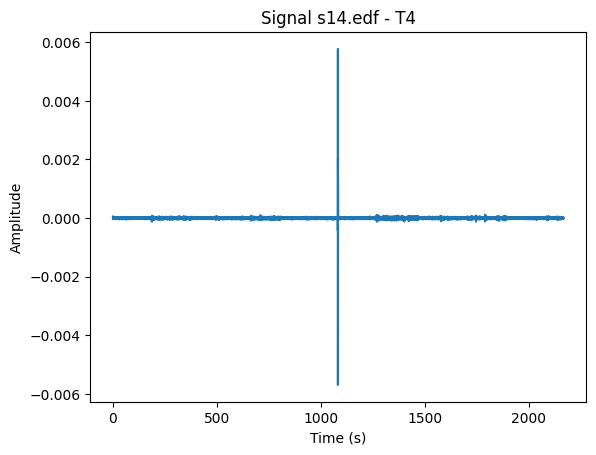

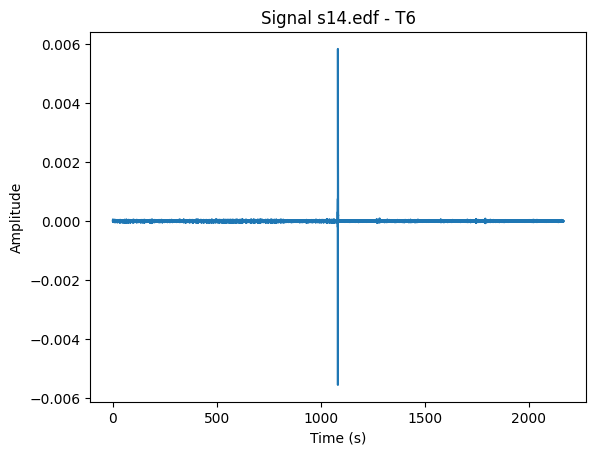

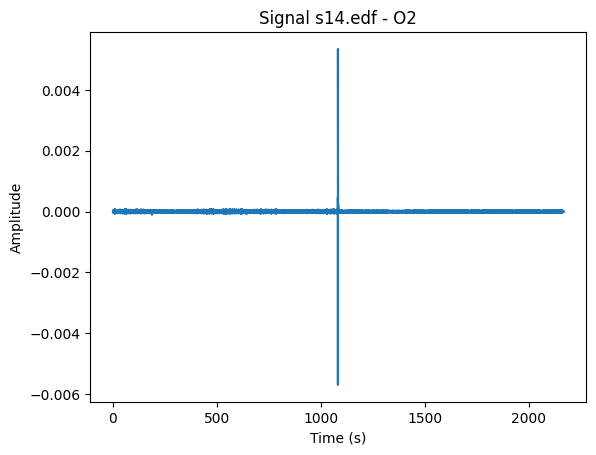

...

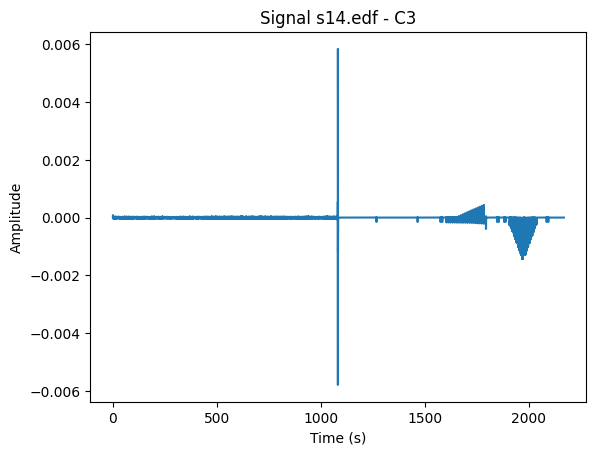

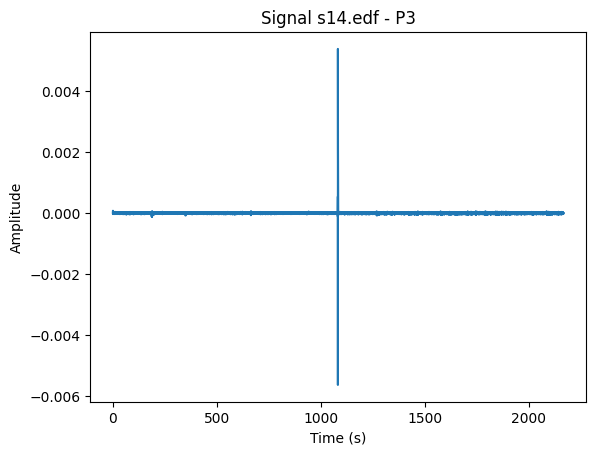

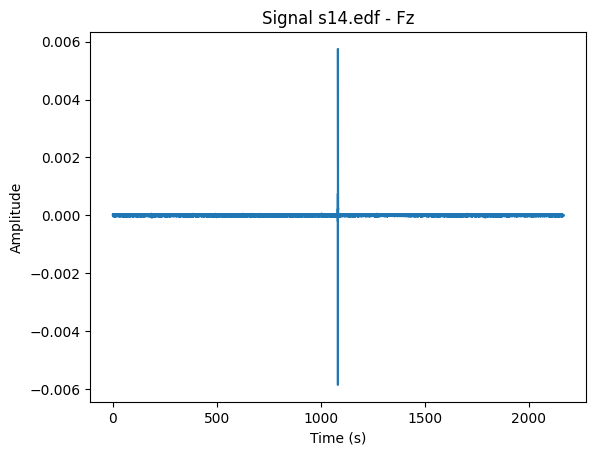

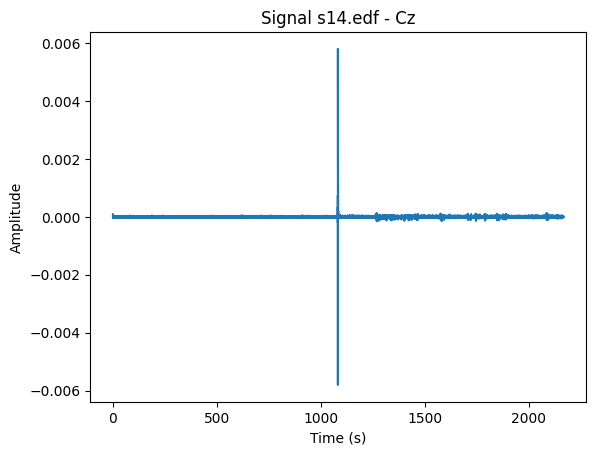

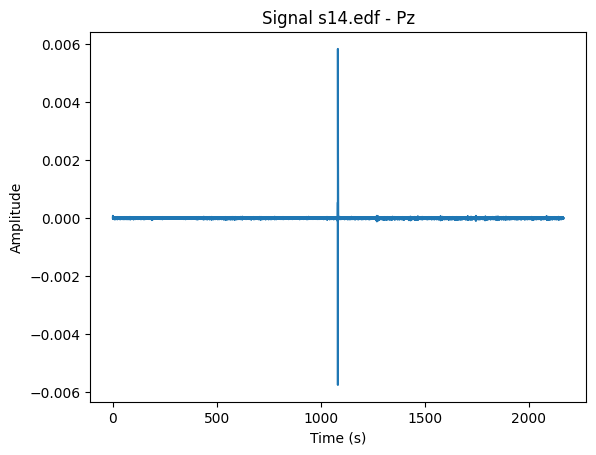

Extracting EDF parameters from /kaggle/input/eeg-data2/s13.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


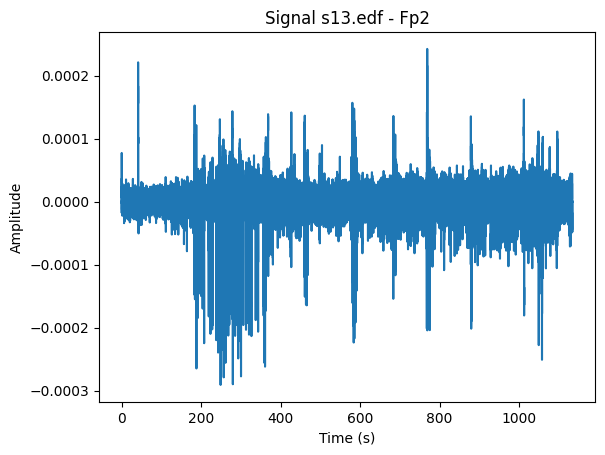

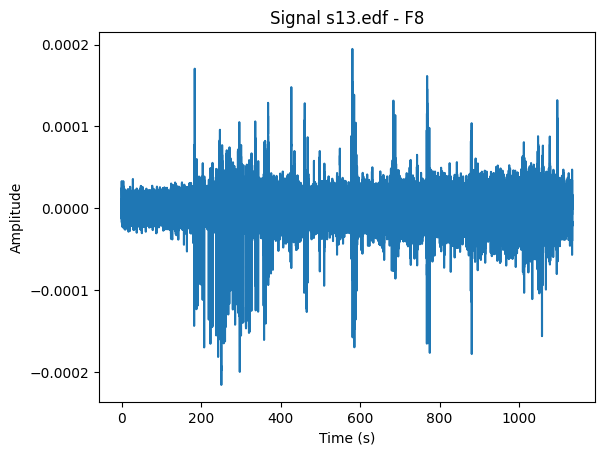

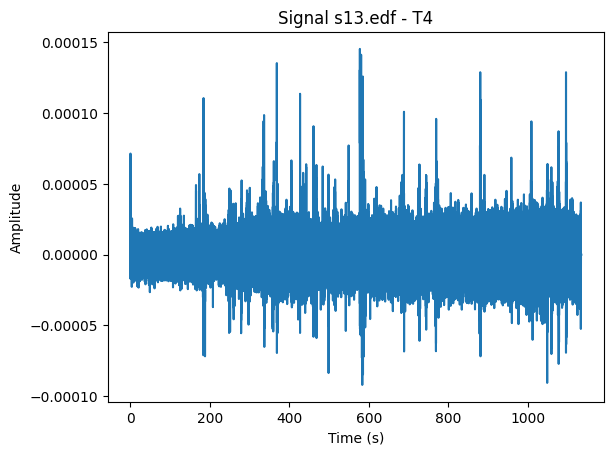

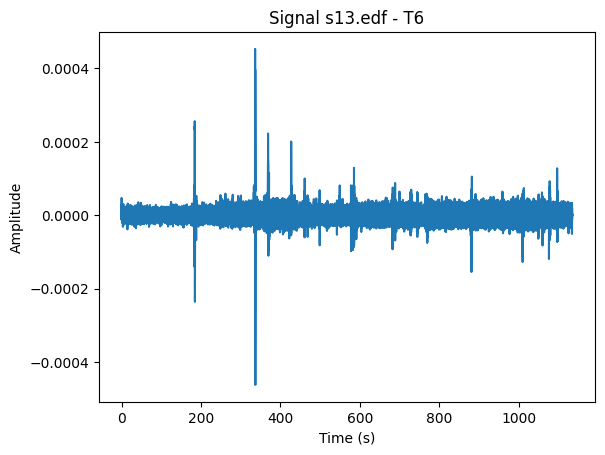

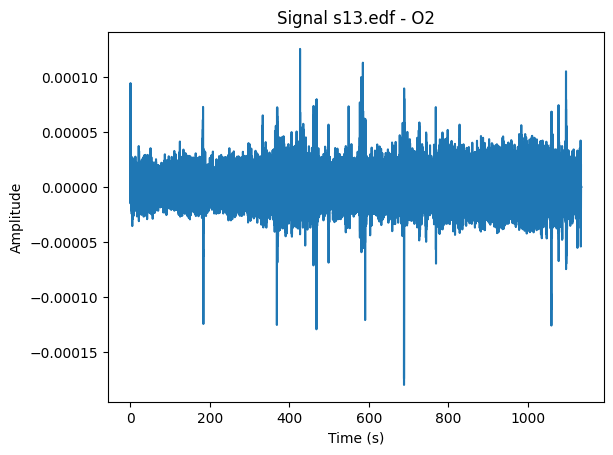

...

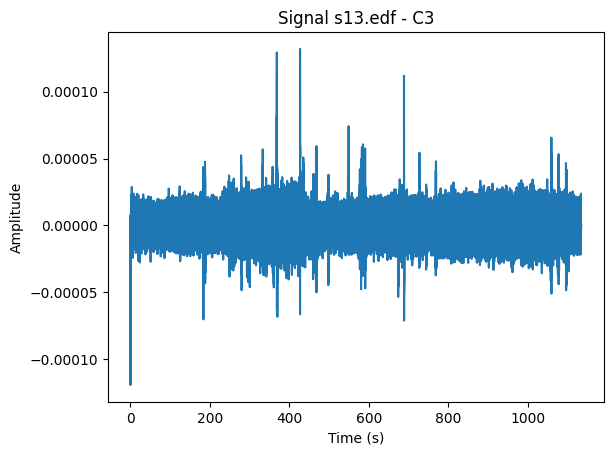

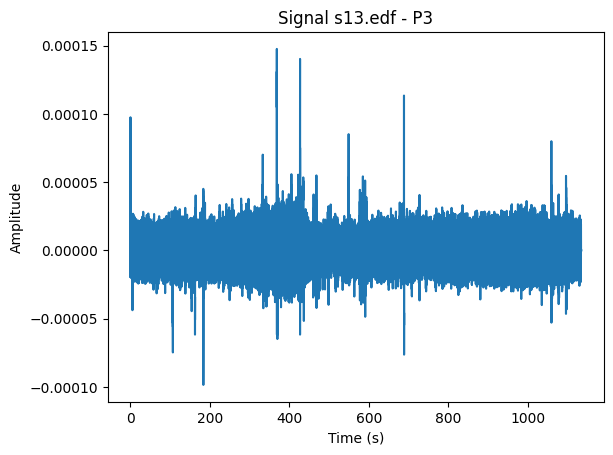

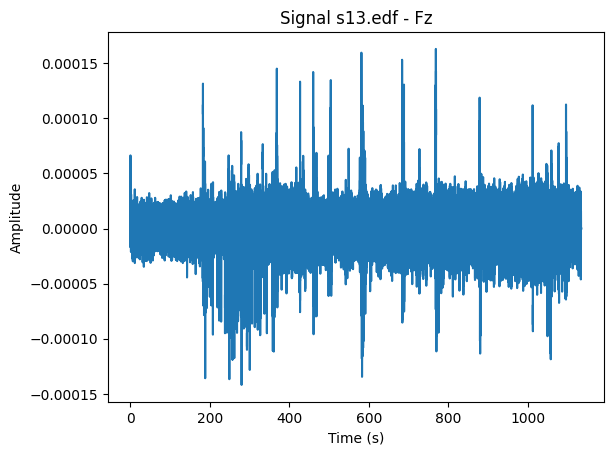

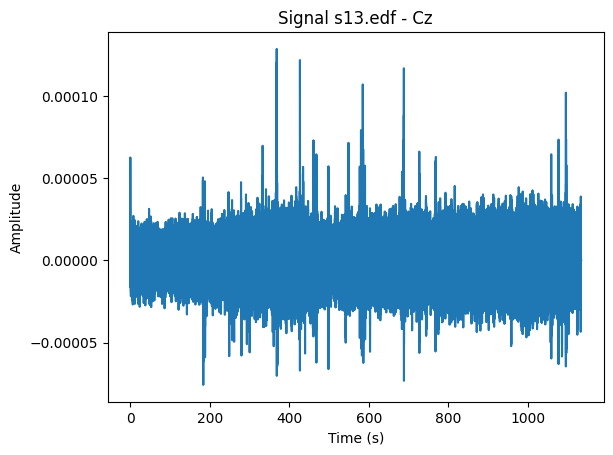

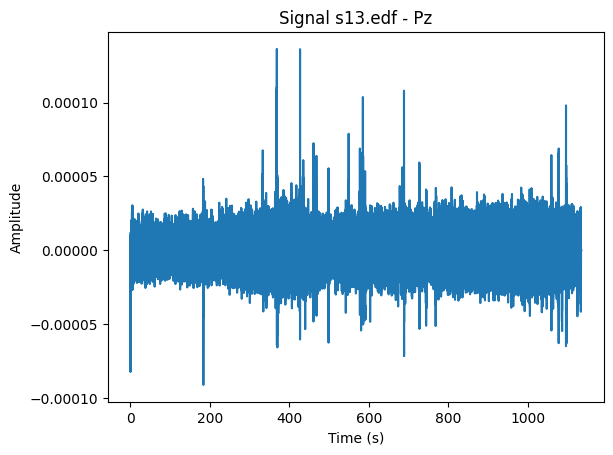

Extracting EDF parameters from /kaggle/input/eeg-data2/h14.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


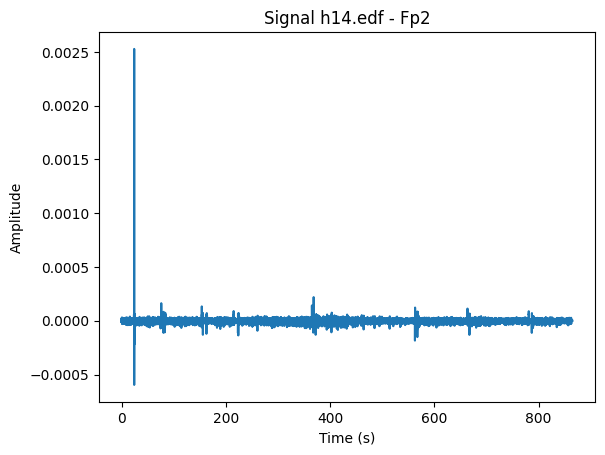

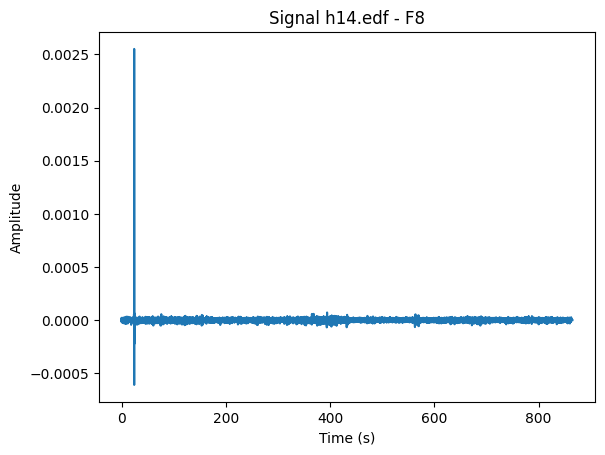

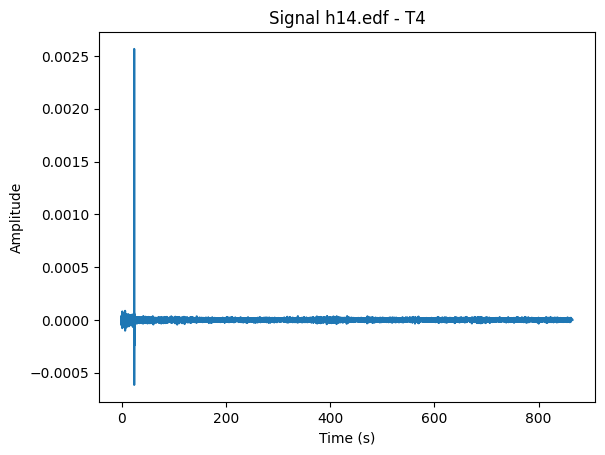

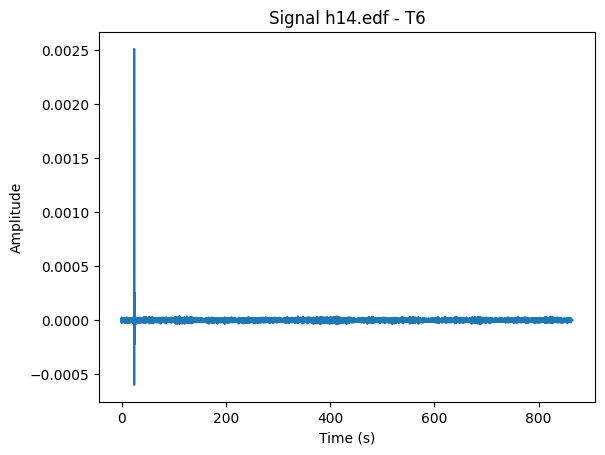

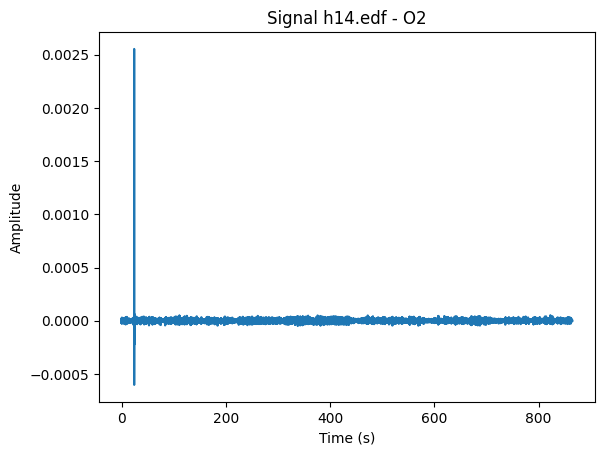

...

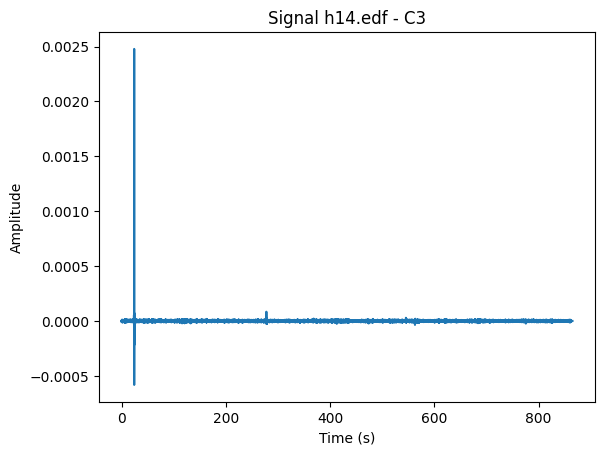

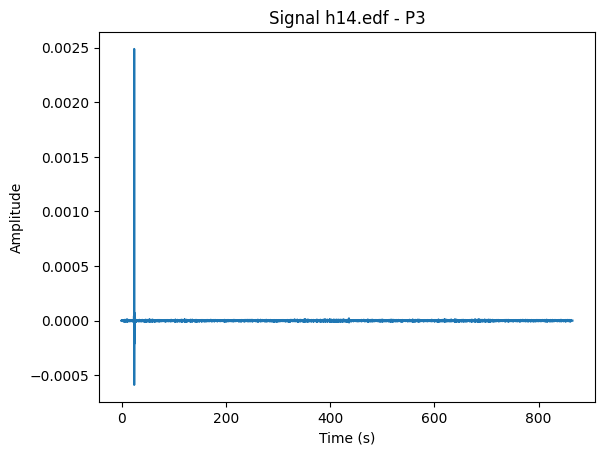

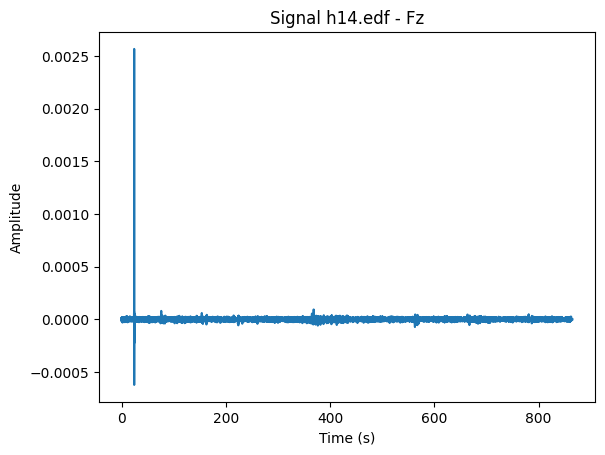

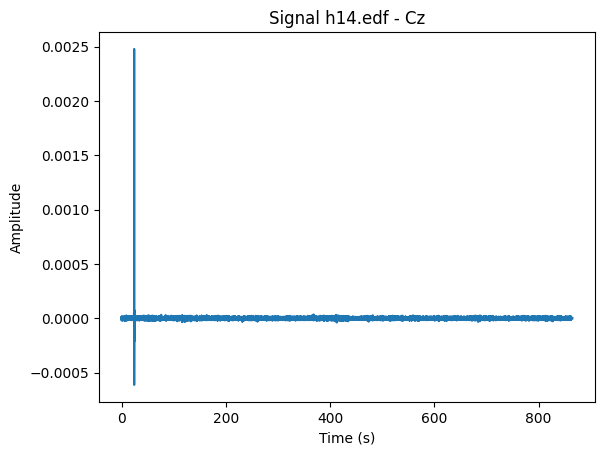

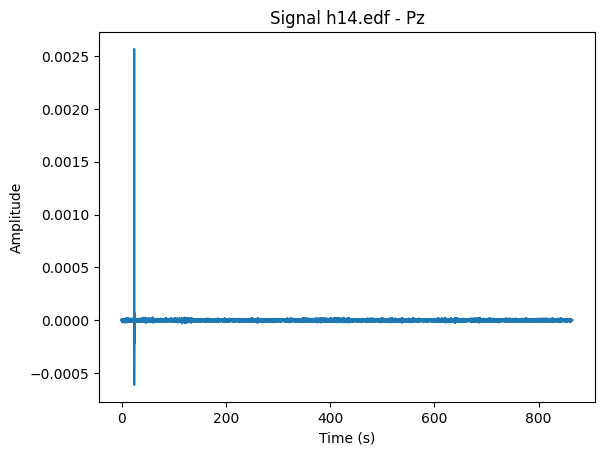

Extracting EDF parameters from /kaggle/input/eeg-data2/s04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


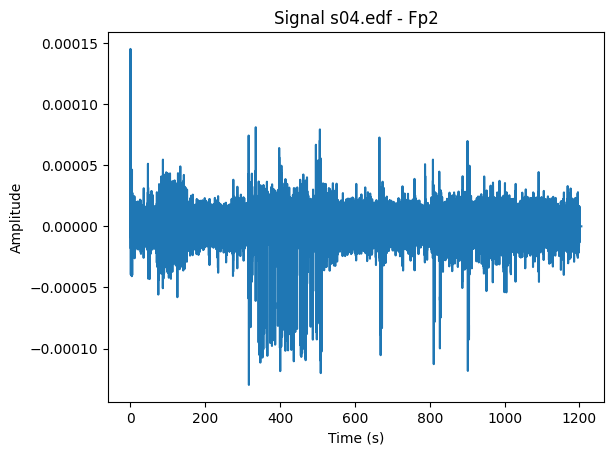

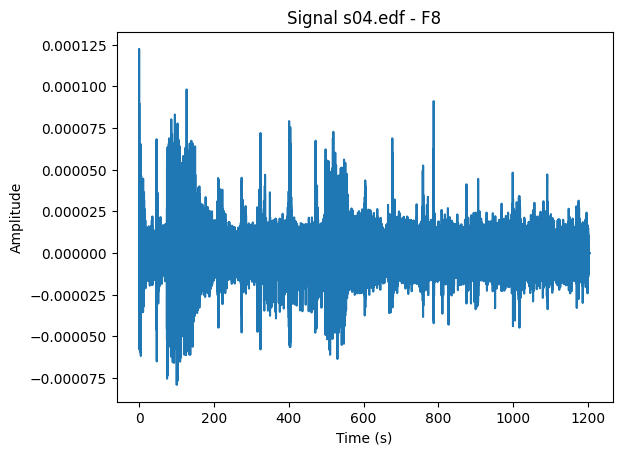

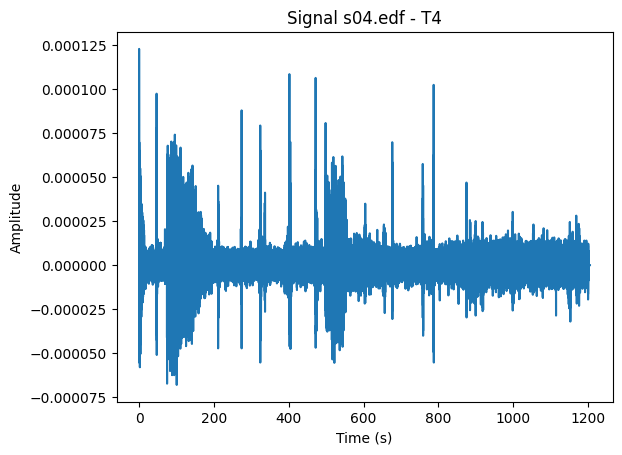

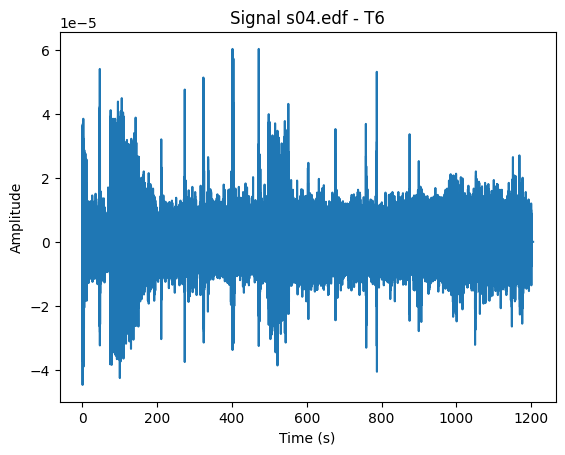

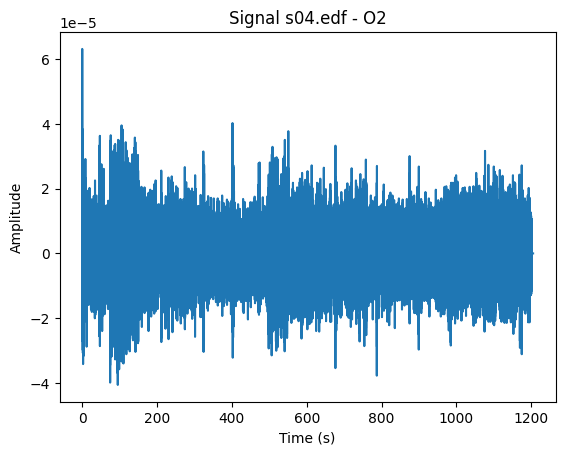

...

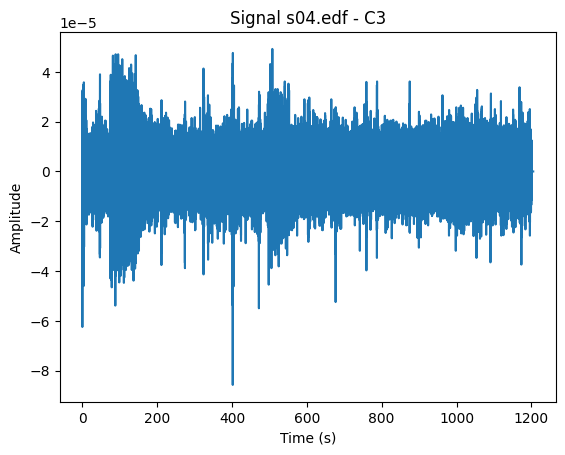

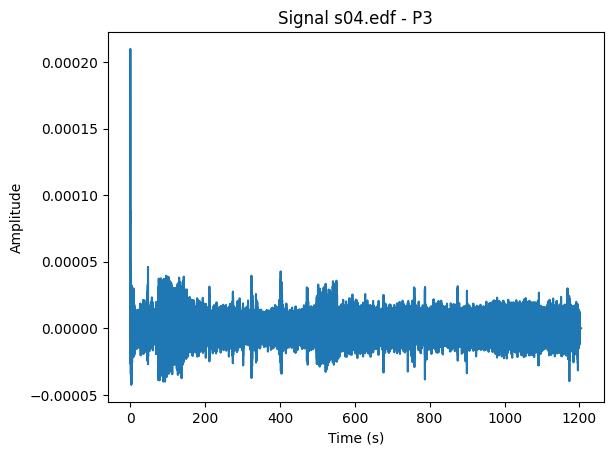

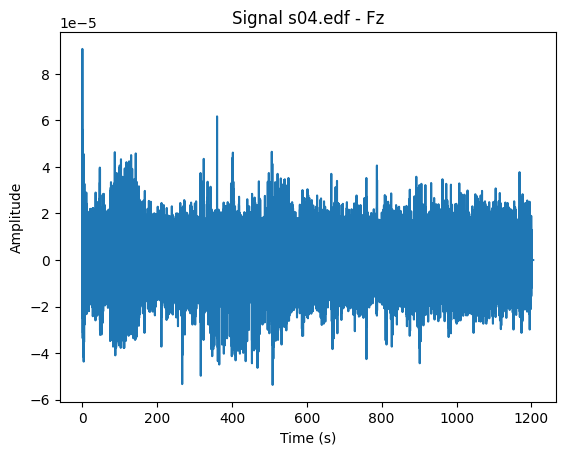

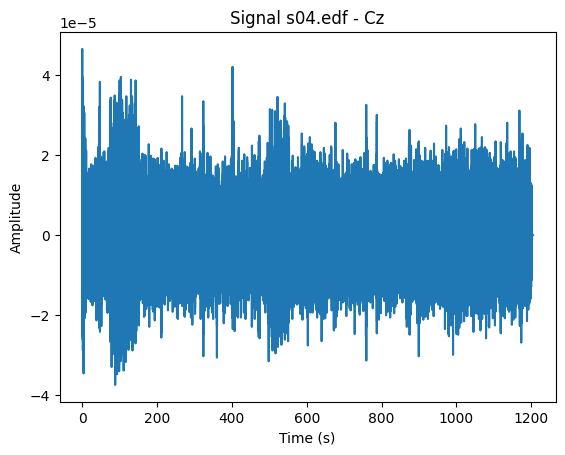

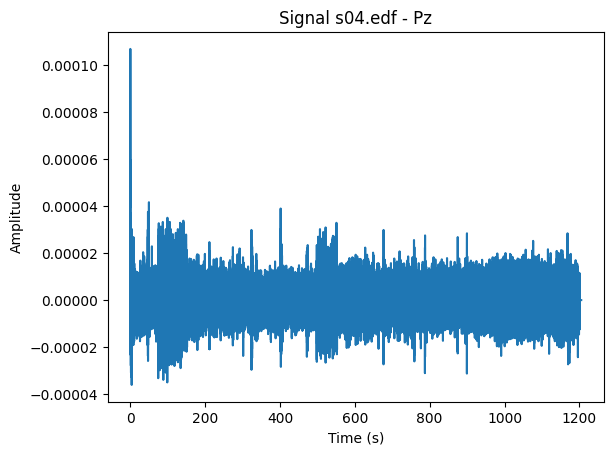

Extracting EDF parameters from /kaggle/input/eeg-data2/h12.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


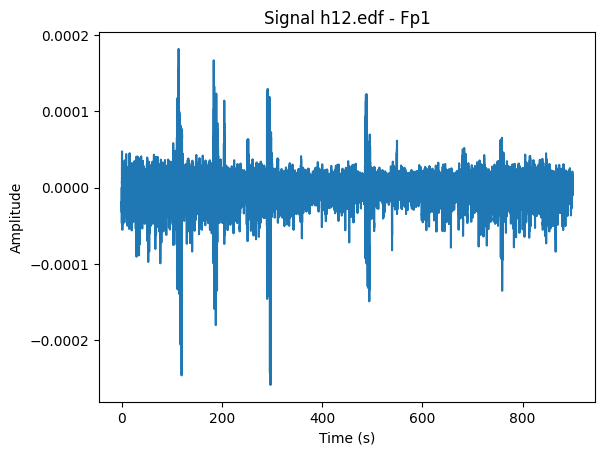

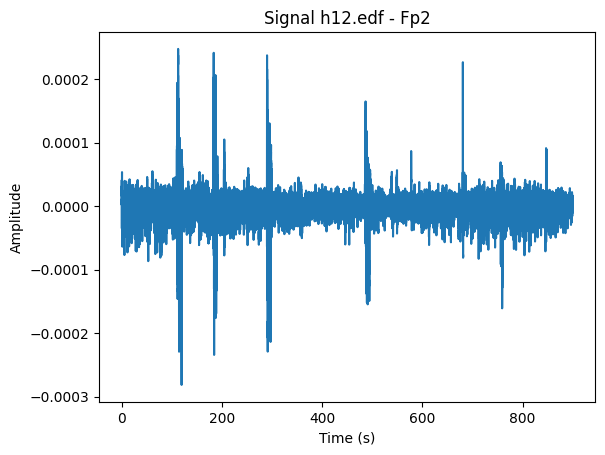

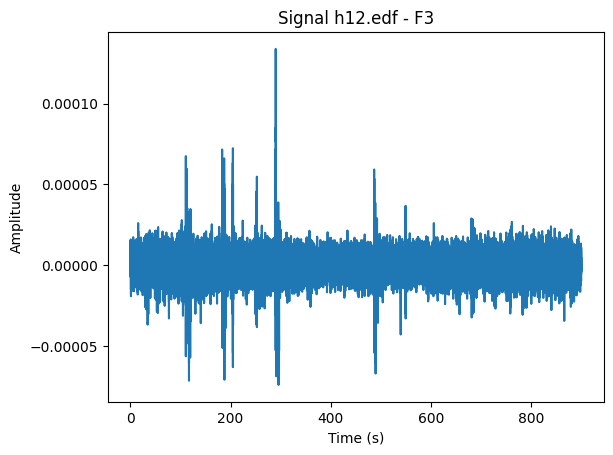

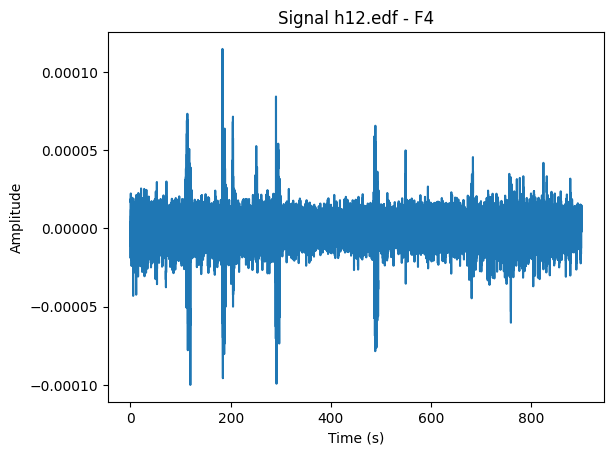

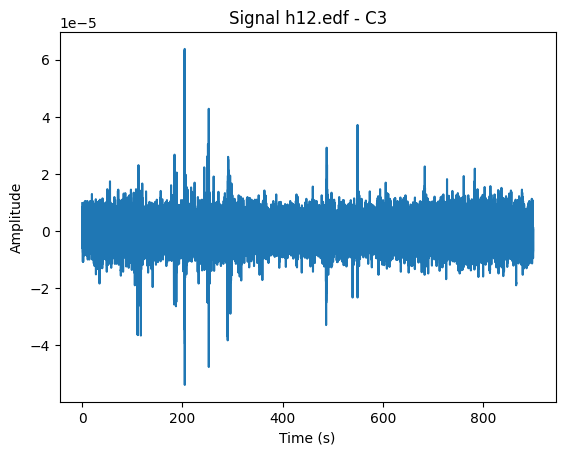

...

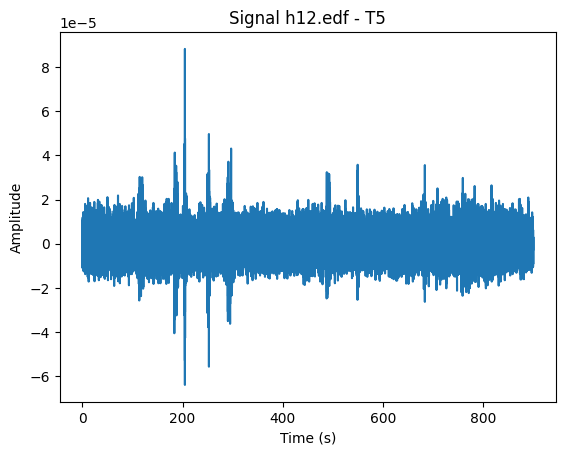

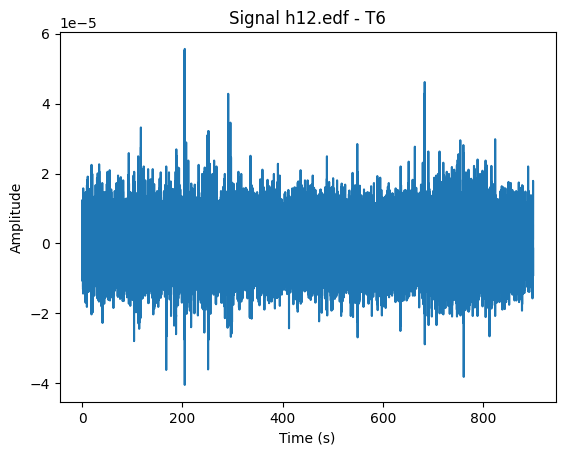

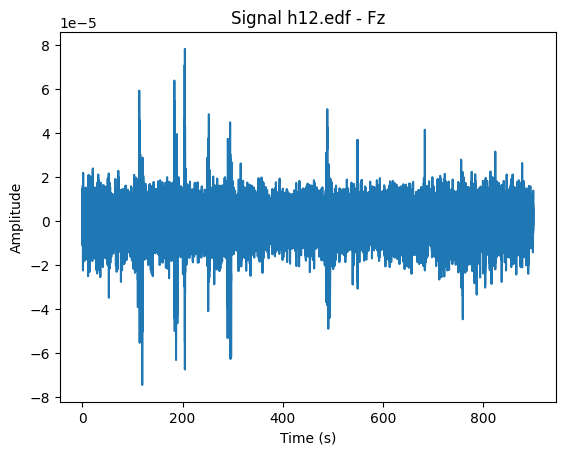

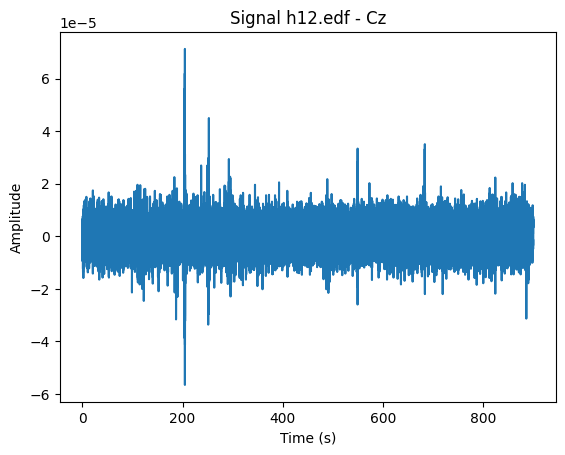

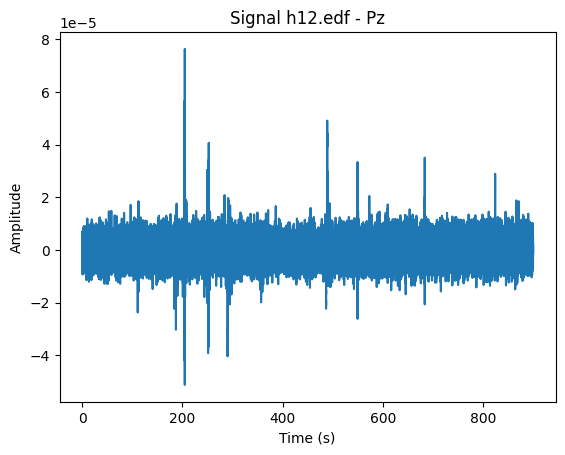

Extracting EDF parameters from /kaggle/input/eeg-data2/h05.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


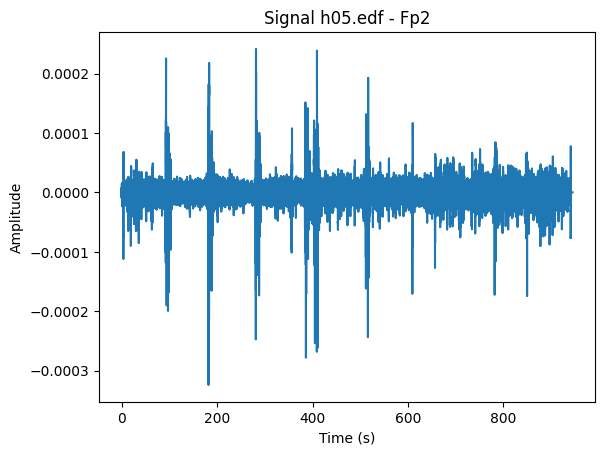

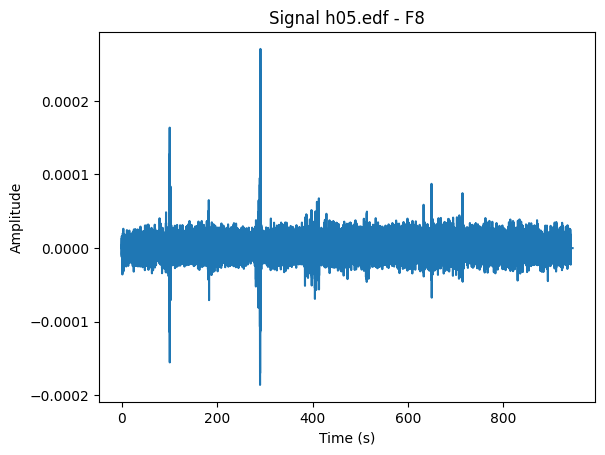

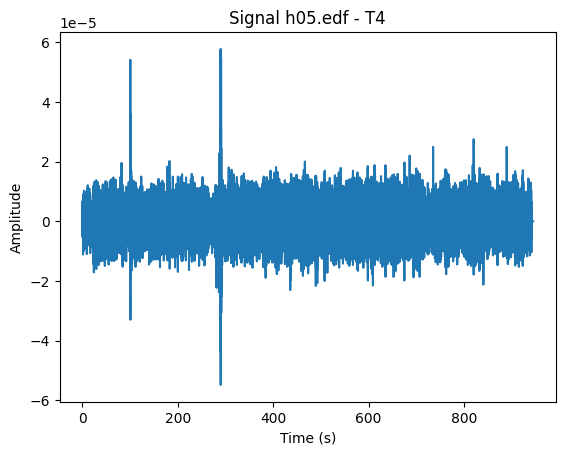

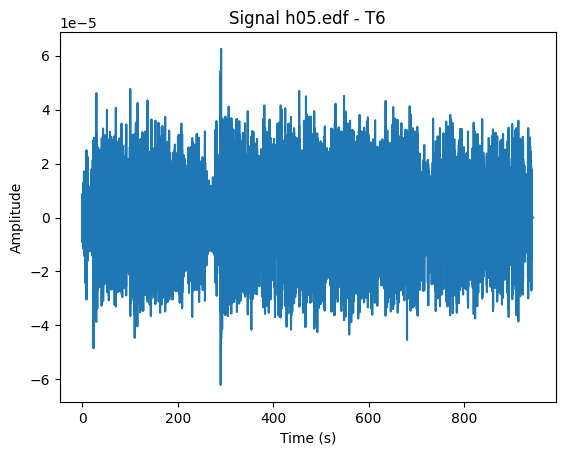

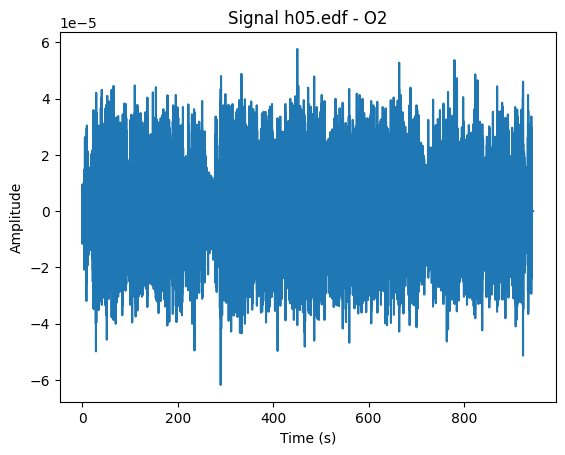

...

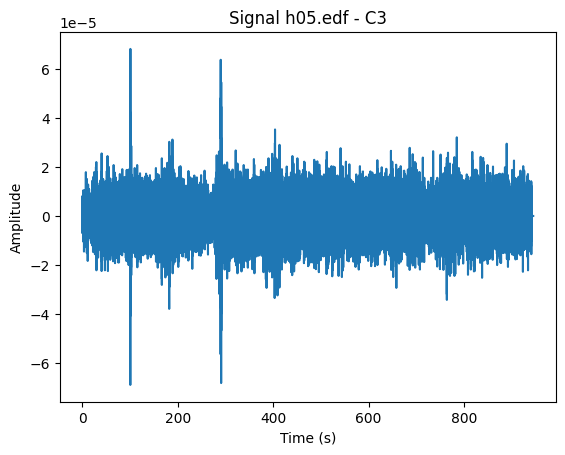

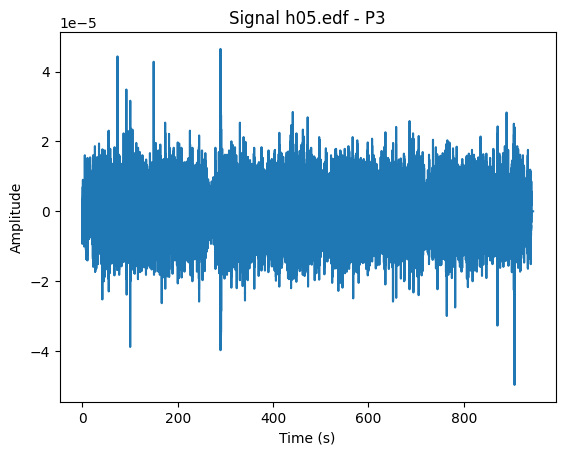

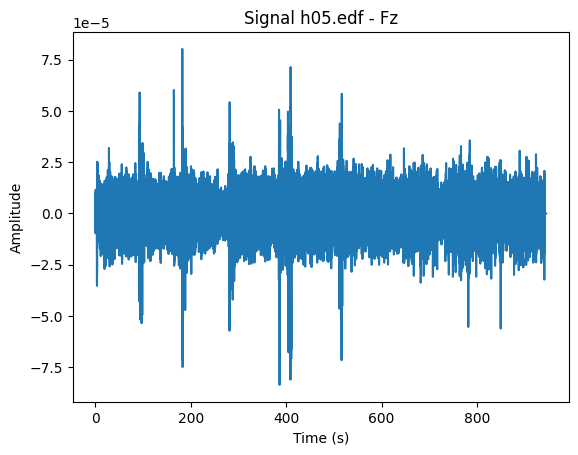

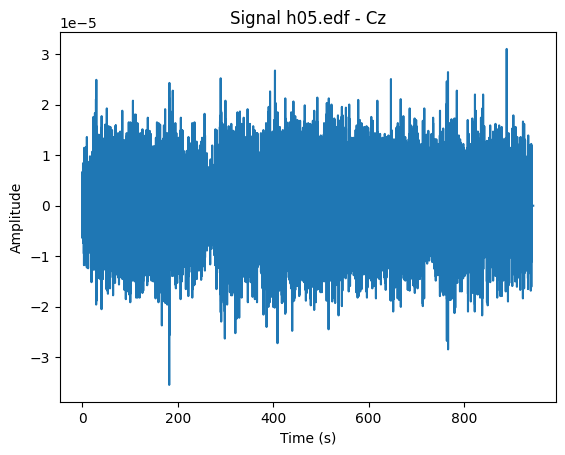

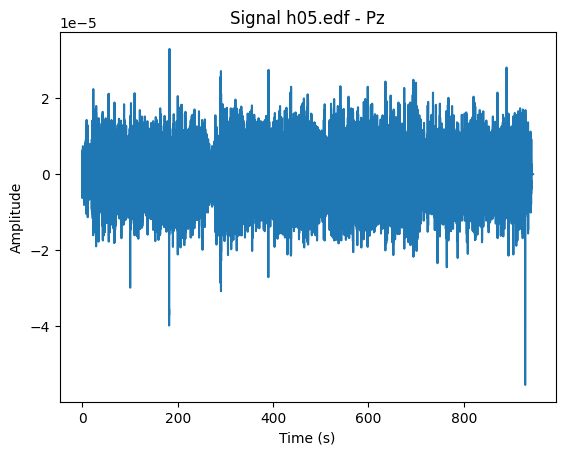

Extracting EDF parameters from /kaggle/input/eeg-data2/h03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


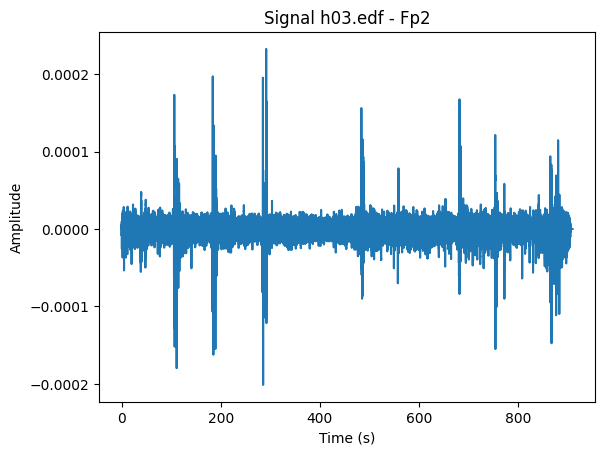

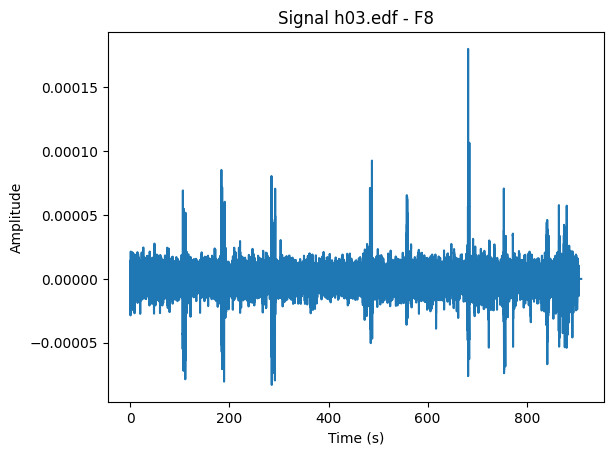

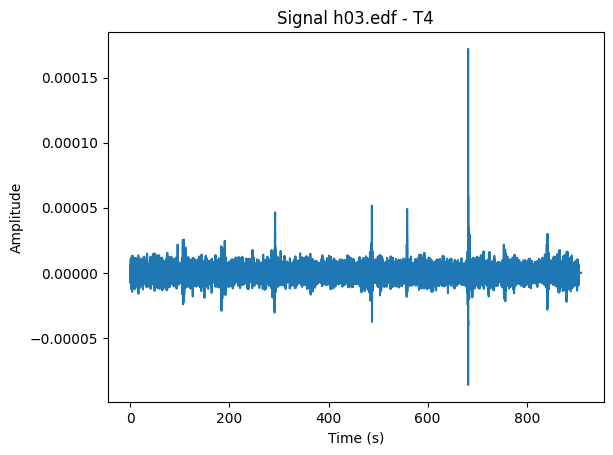

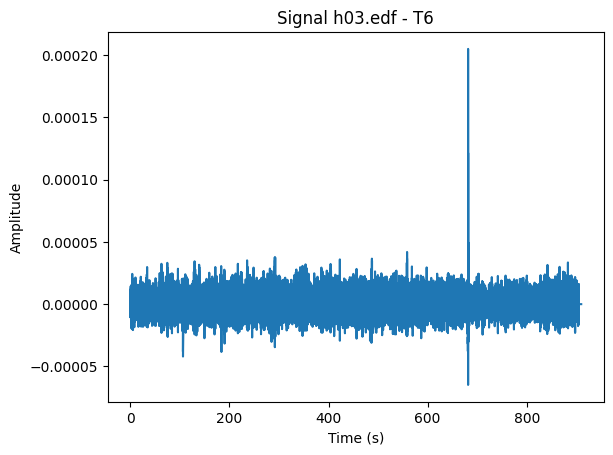

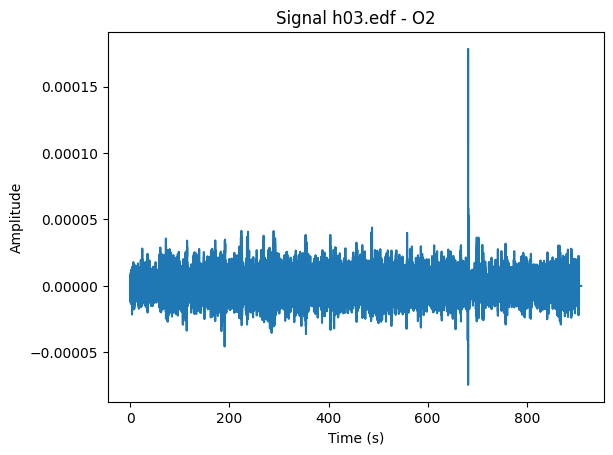

...

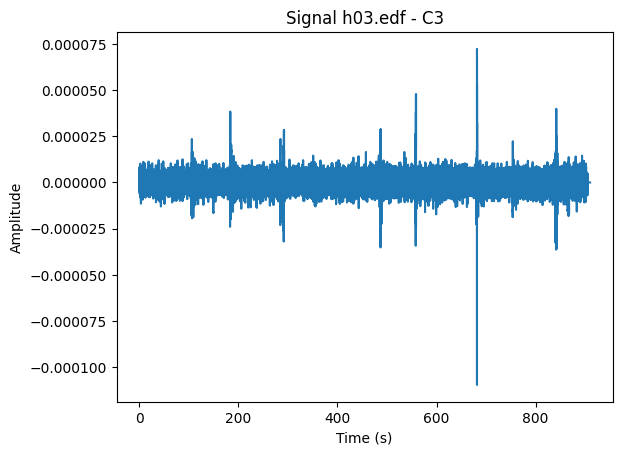

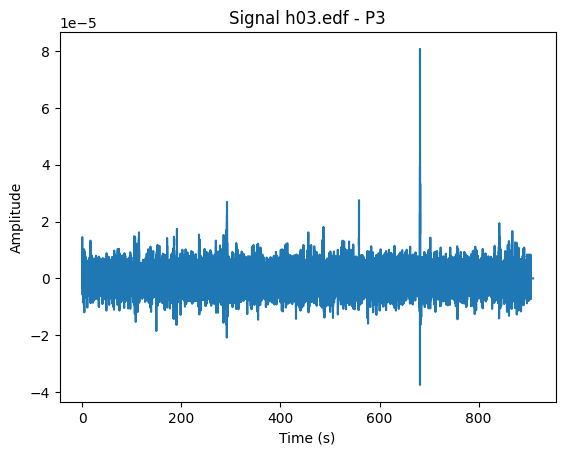

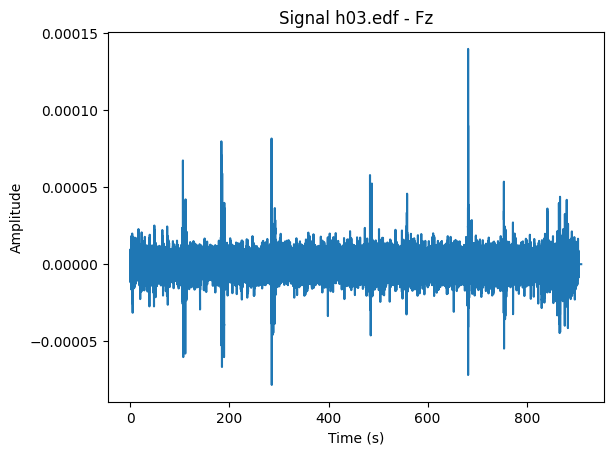

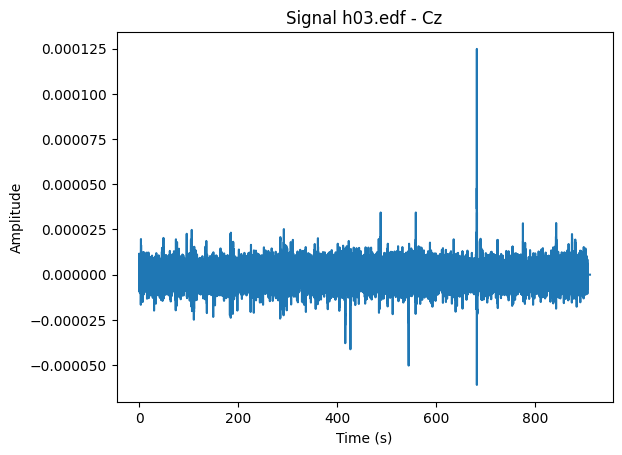

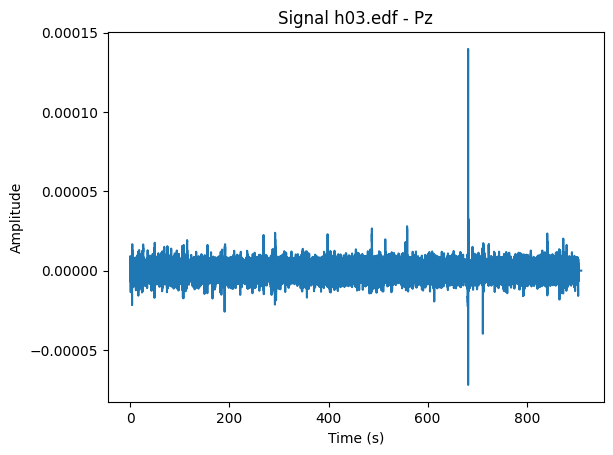

Extracting EDF parameters from /kaggle/input/eeg-data2/s11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


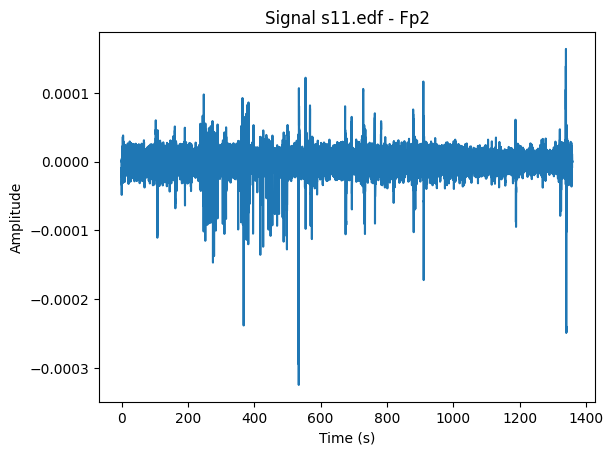

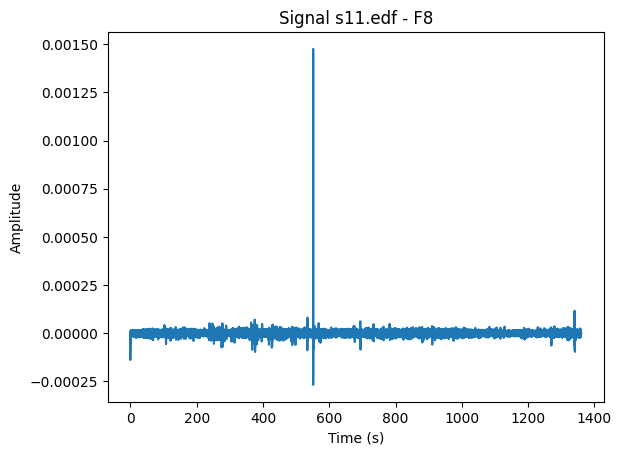

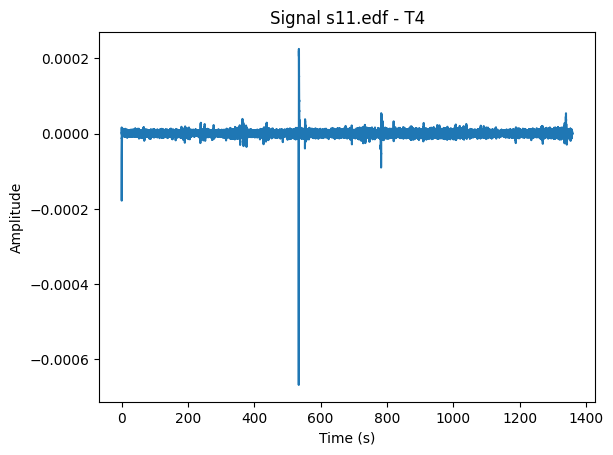

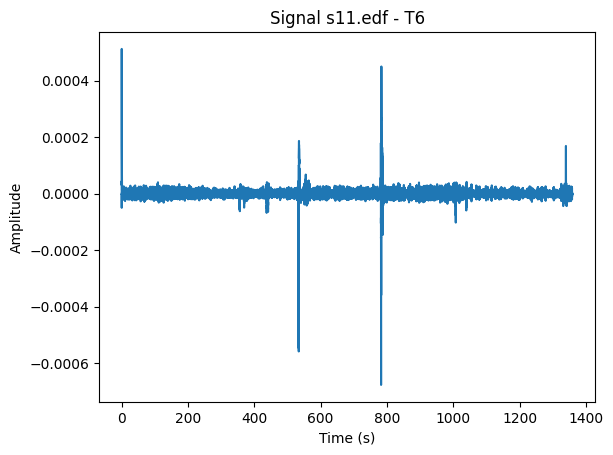

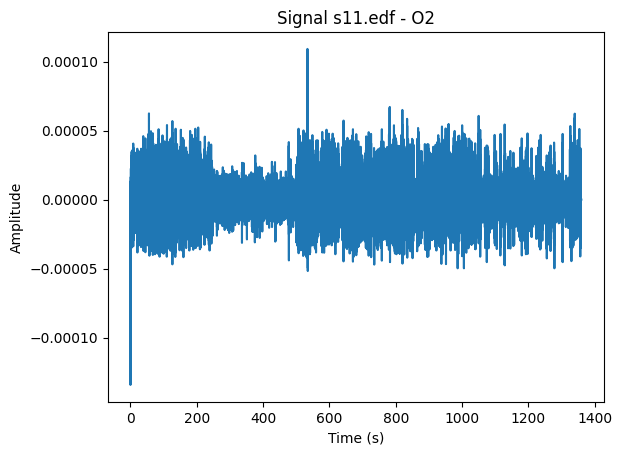

...

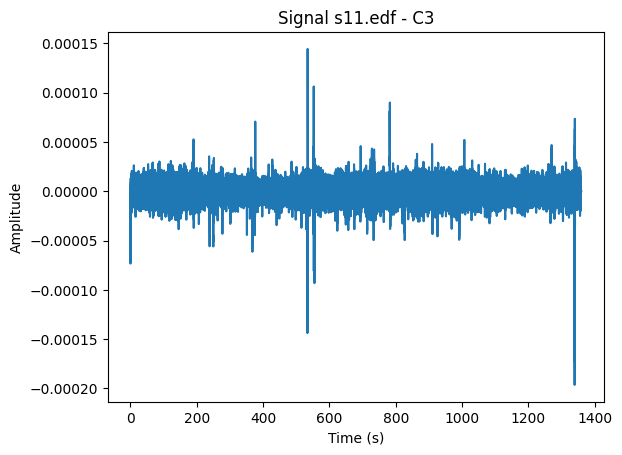

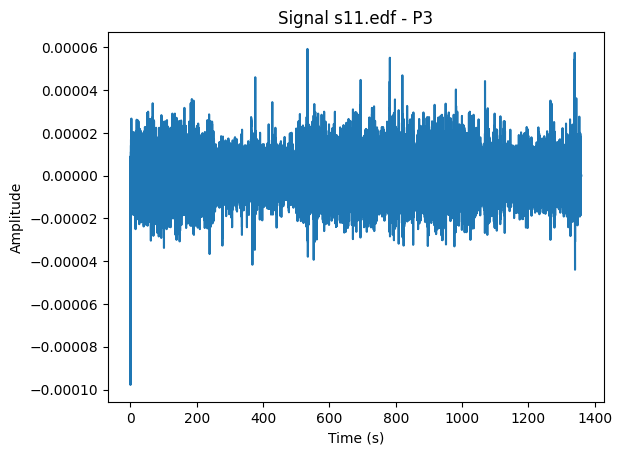

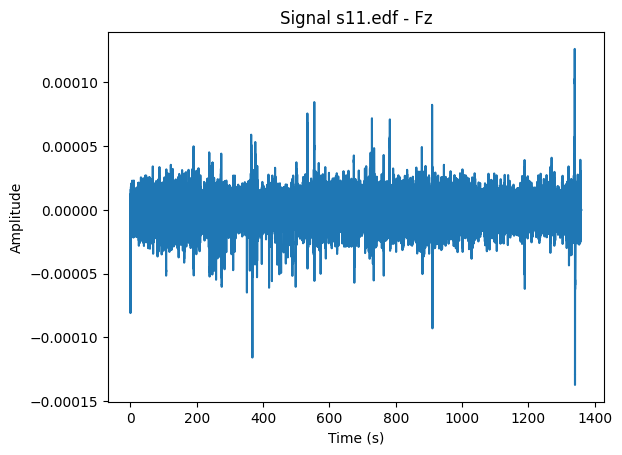

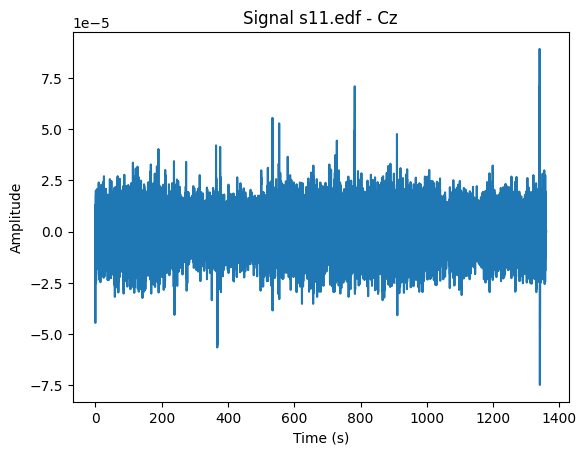

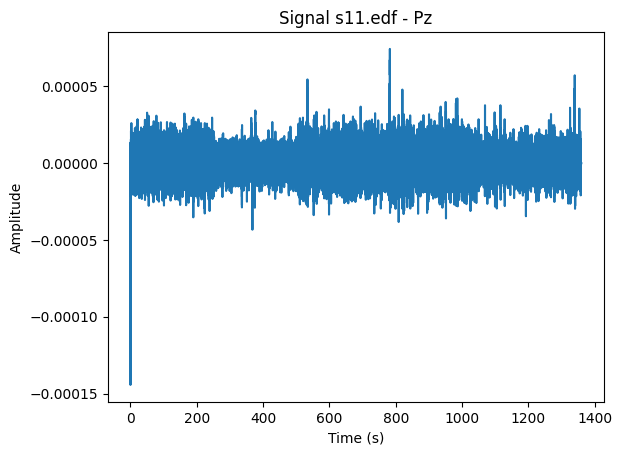

Extracting EDF parameters from /kaggle/input/eeg-data2/h02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


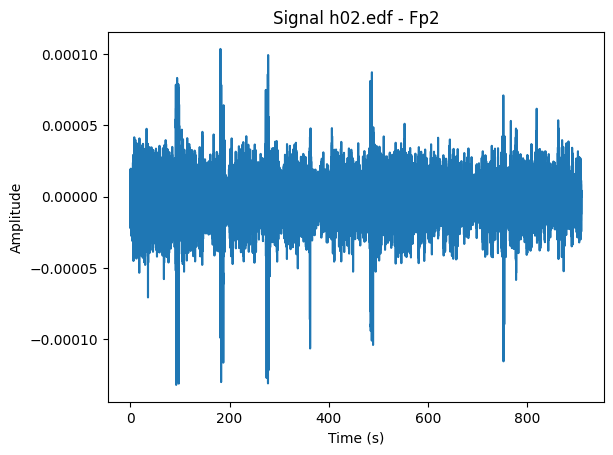

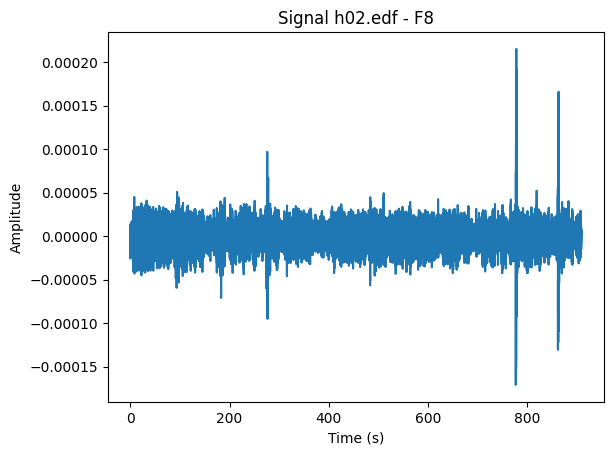

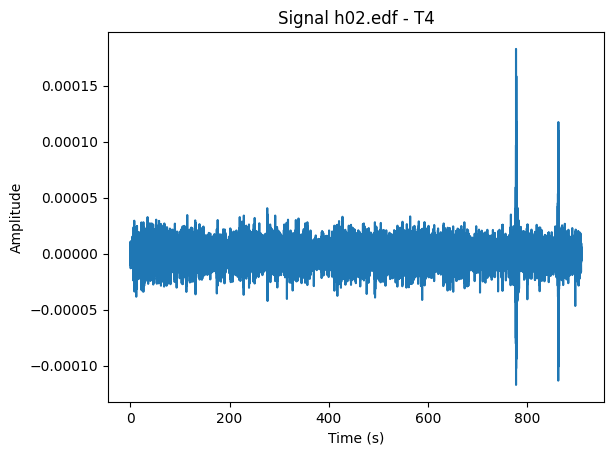

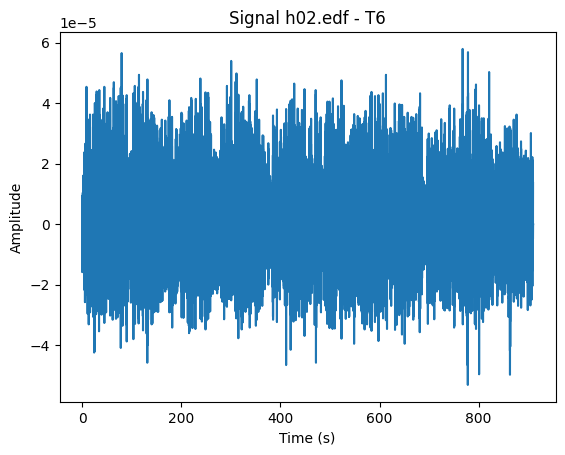

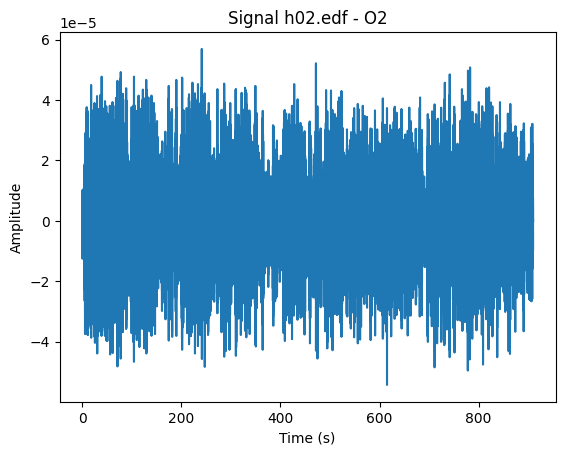

...

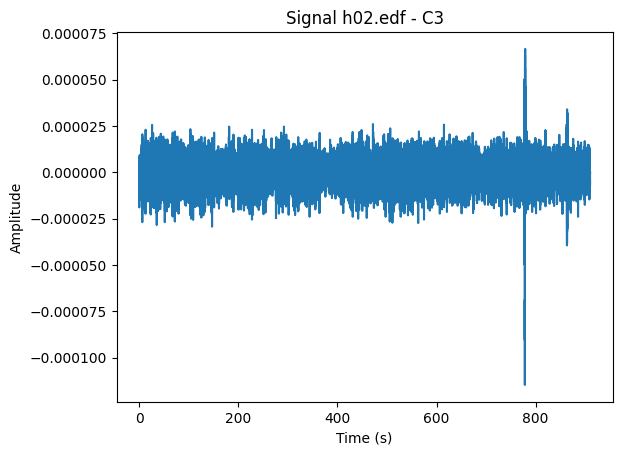

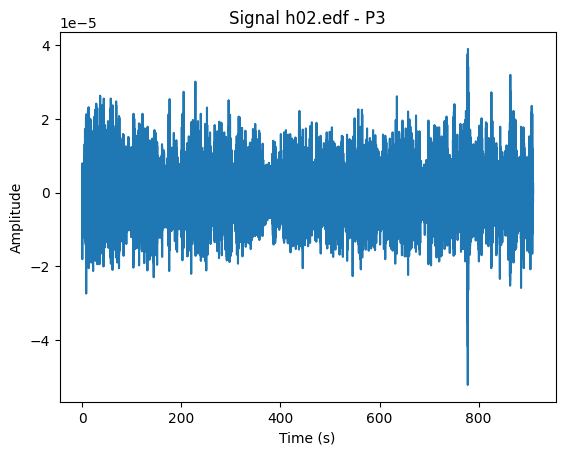

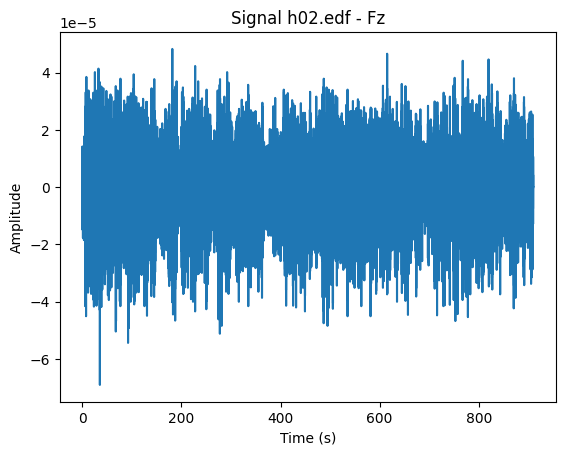

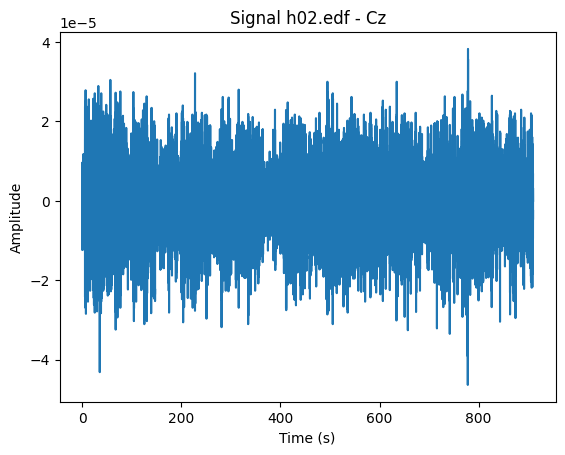

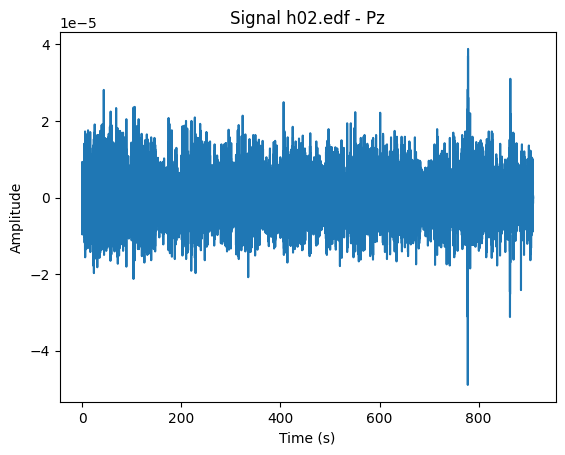

Extracting EDF parameters from /kaggle/input/eeg-data2/h08.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


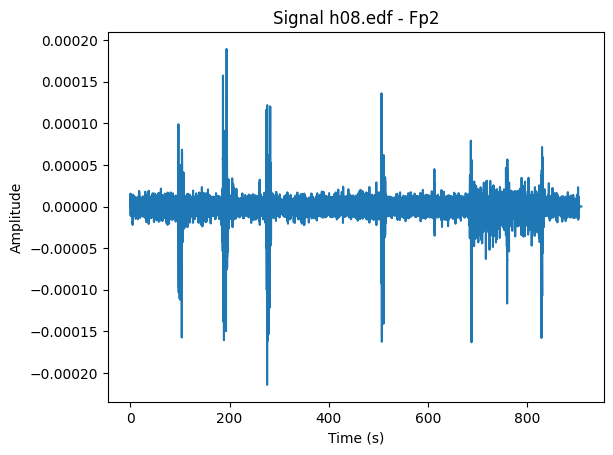

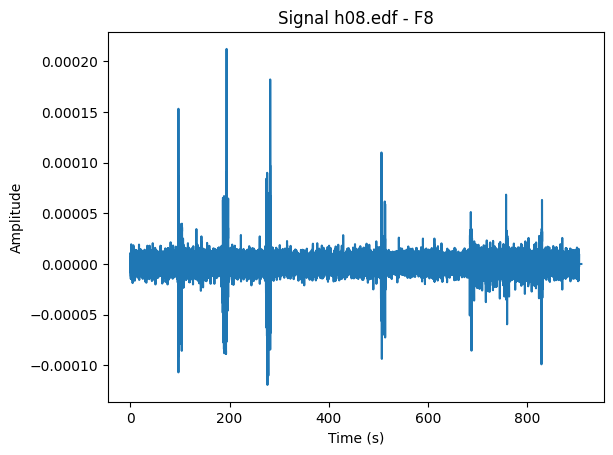

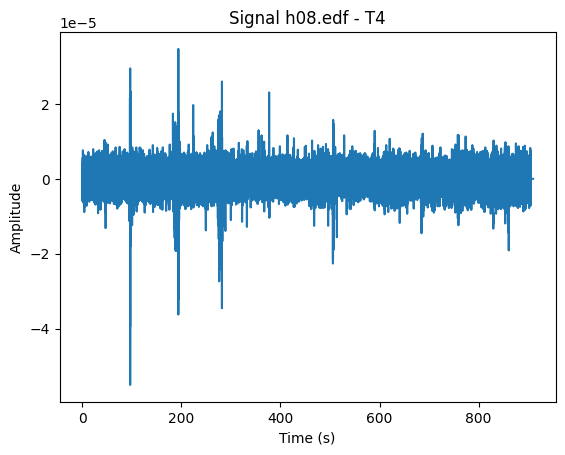

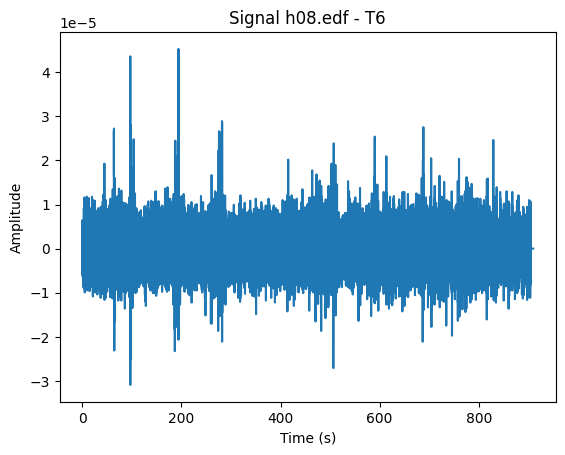

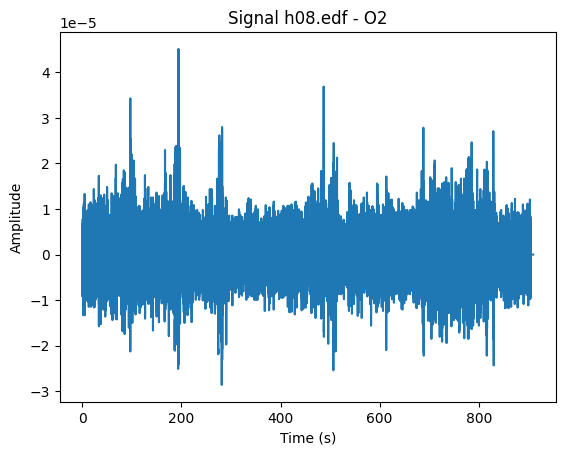

...

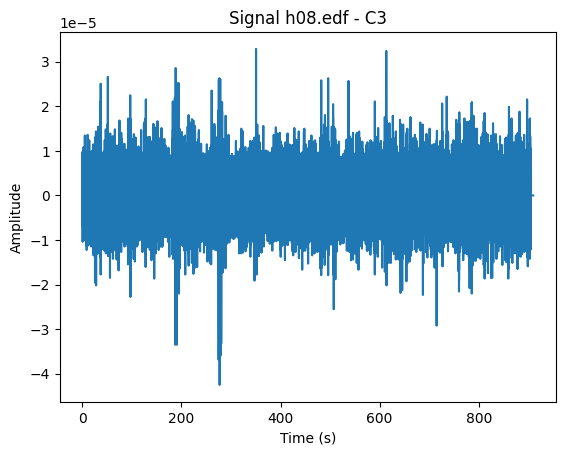

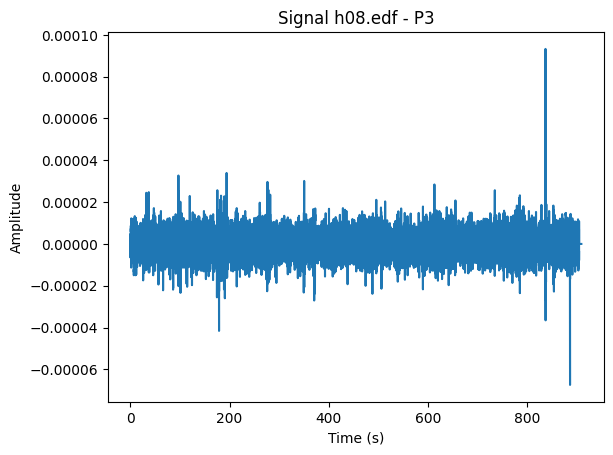

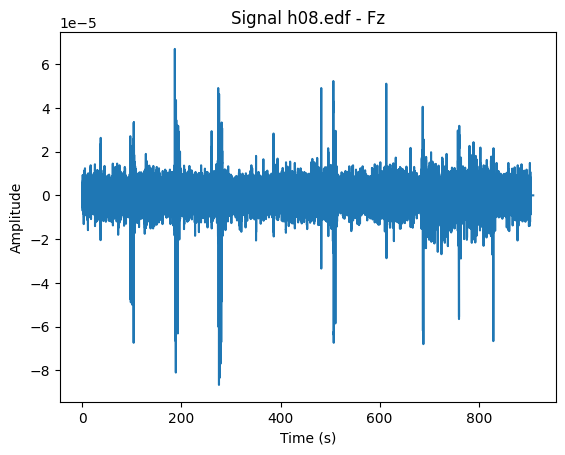

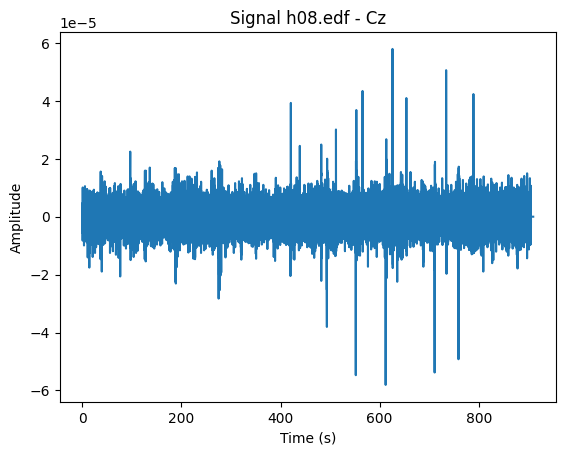

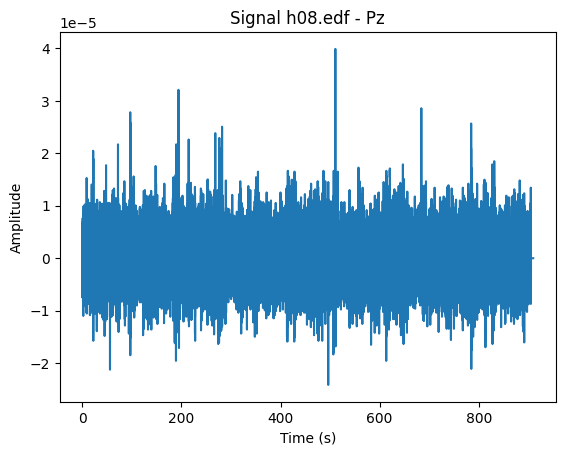

Extracting EDF parameters from /kaggle/input/eeg-data2/h11.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


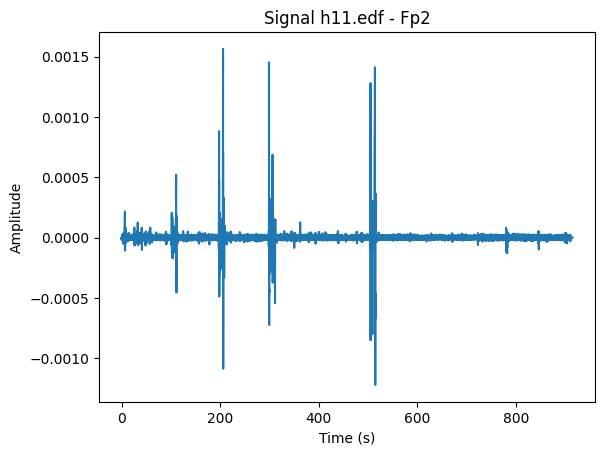

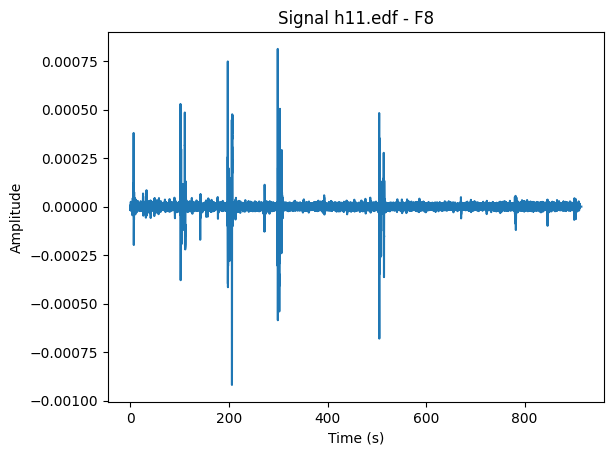

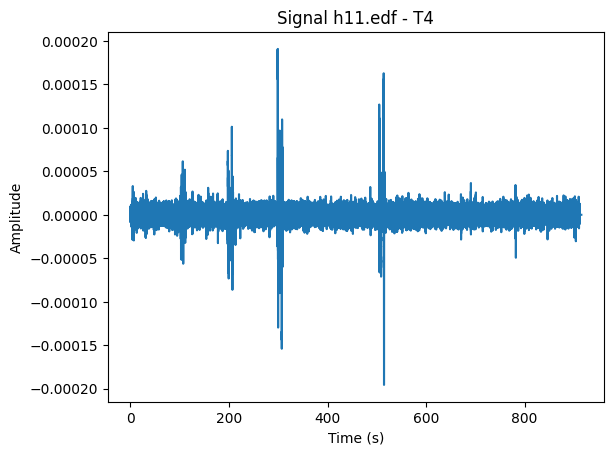

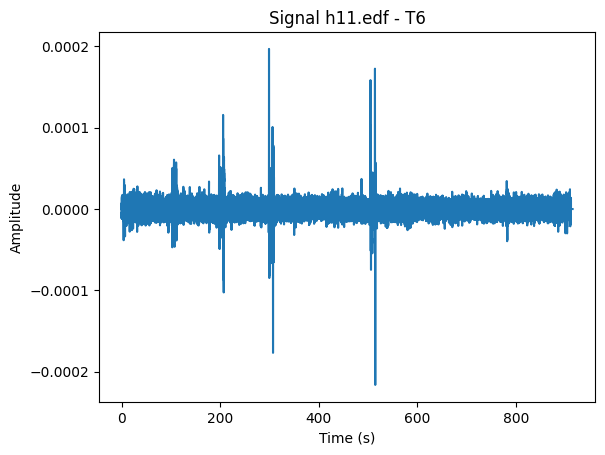

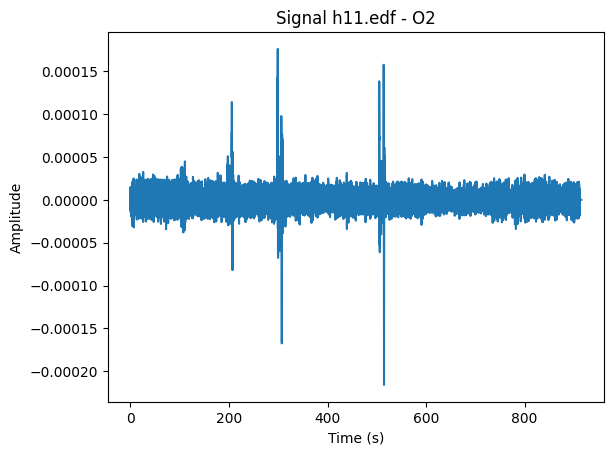

...

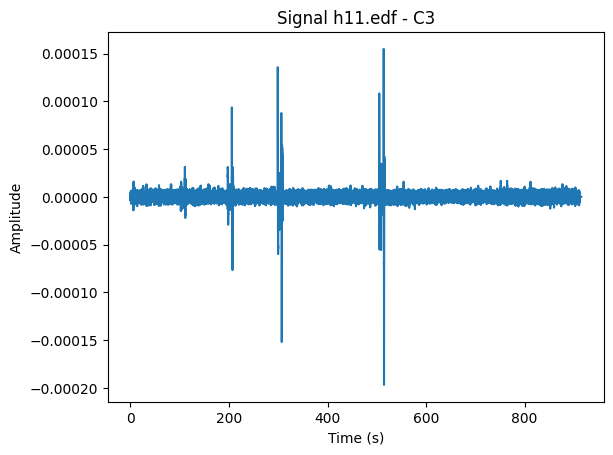

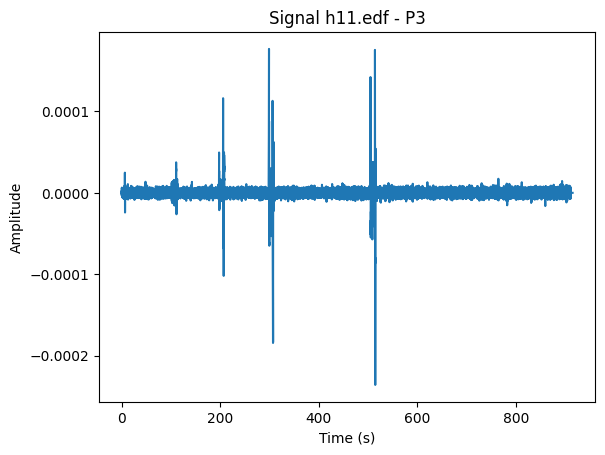

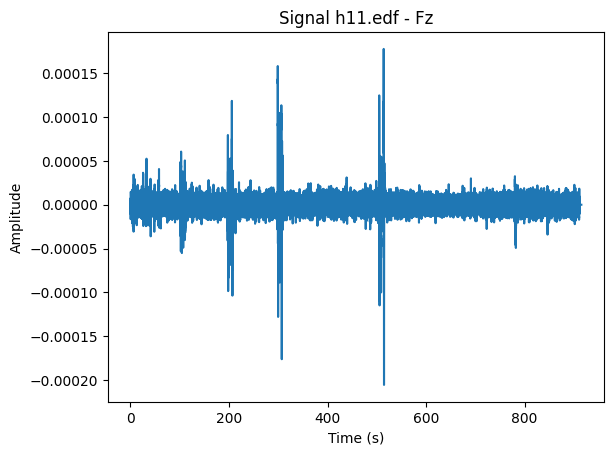

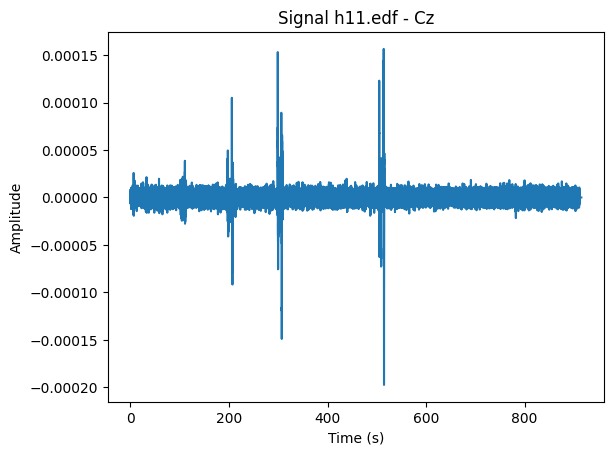

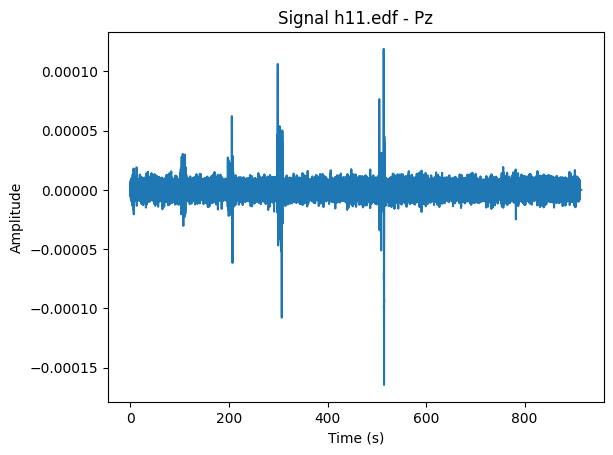

Extracting EDF parameters from /kaggle/input/eeg-data2/s03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


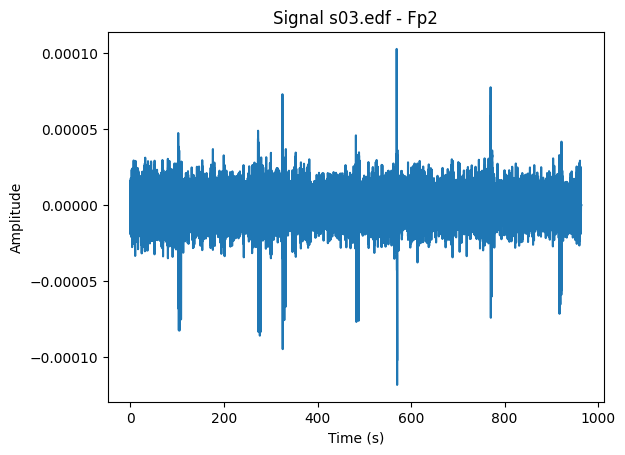

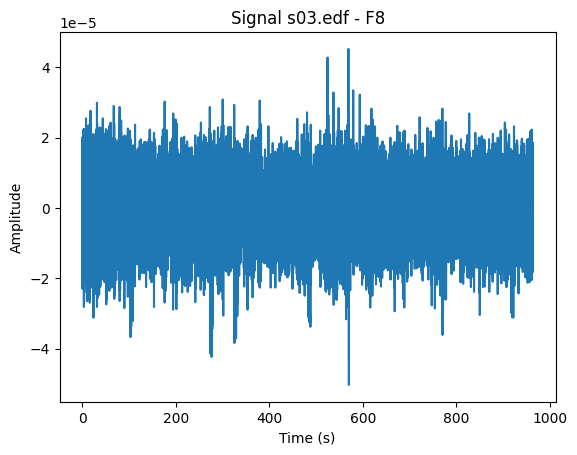

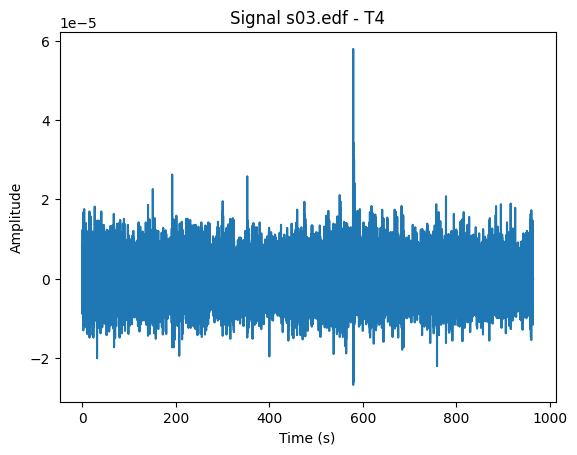

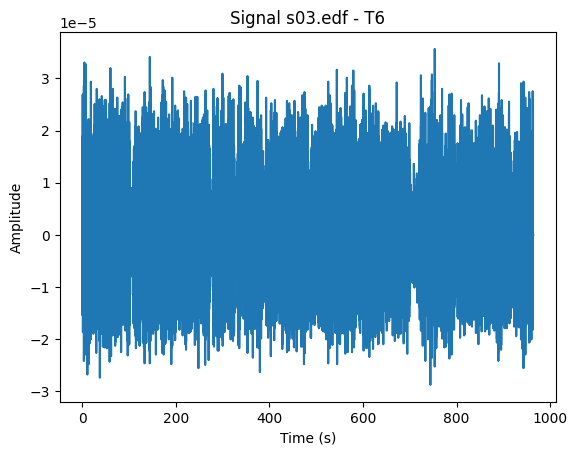

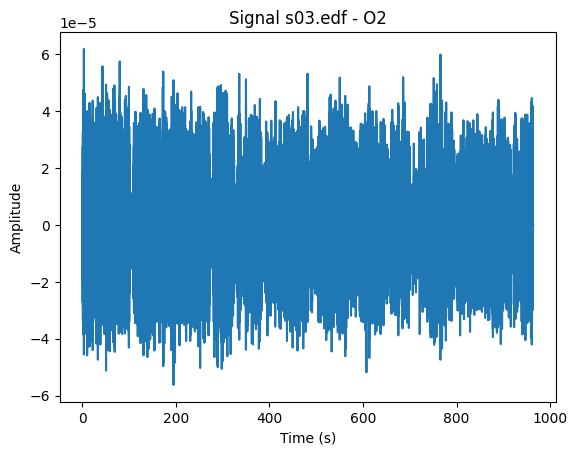

...

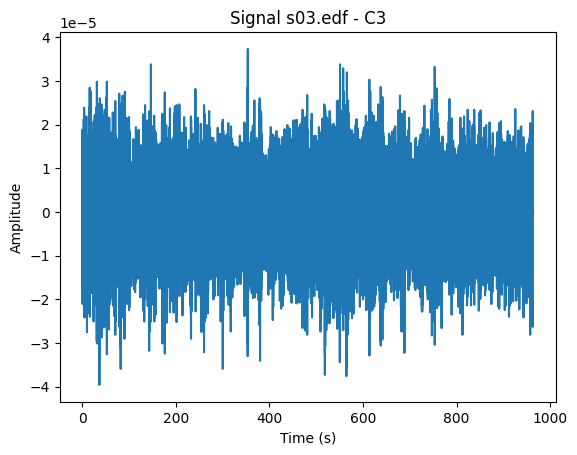

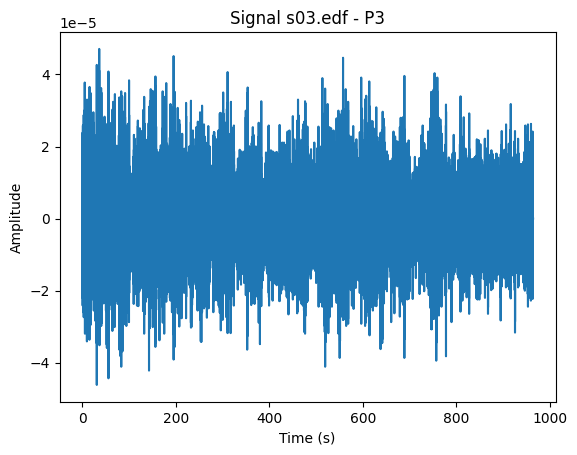

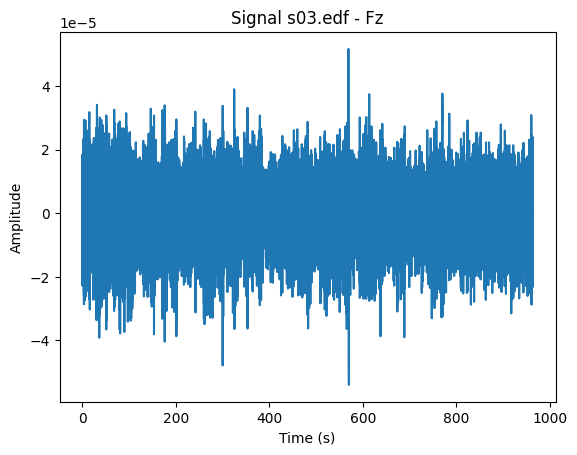

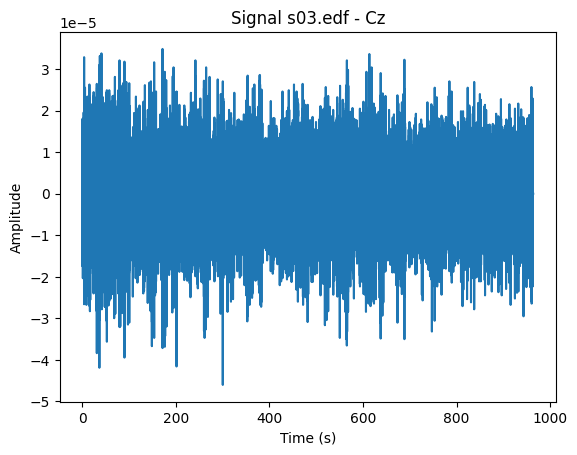

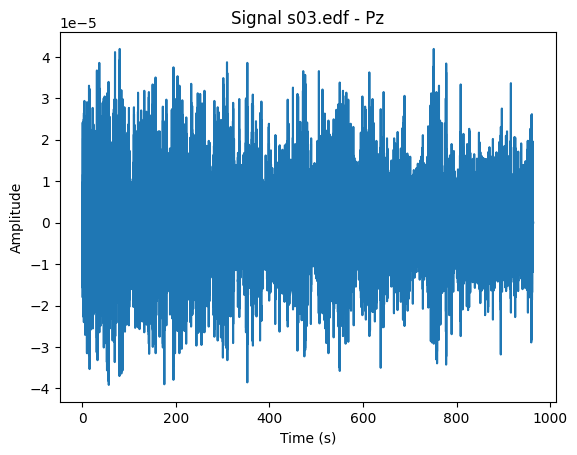

Extracting EDF parameters from /kaggle/input/eeg-data2/h06.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


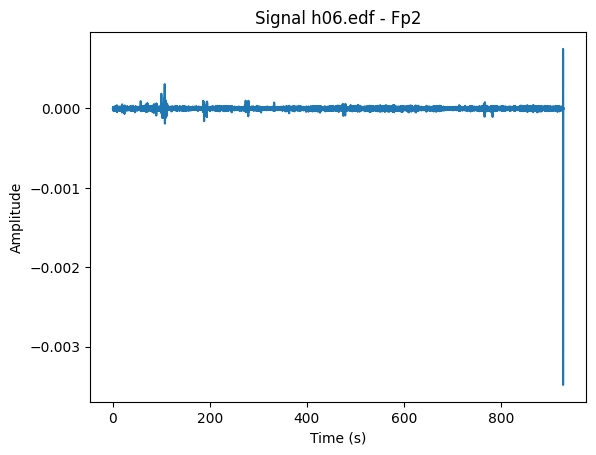

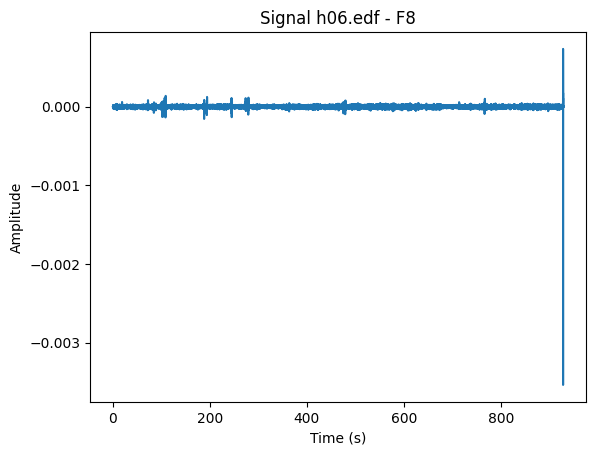

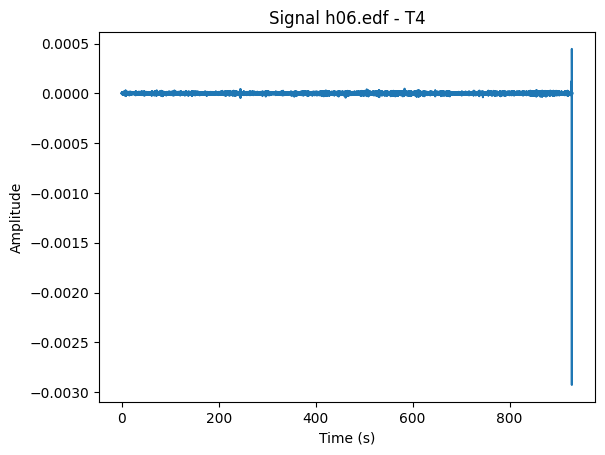

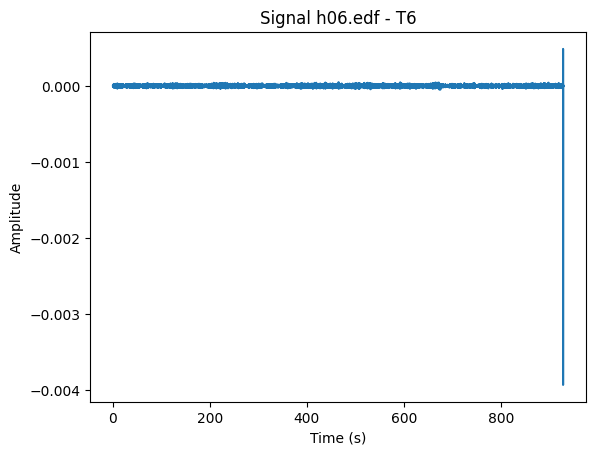

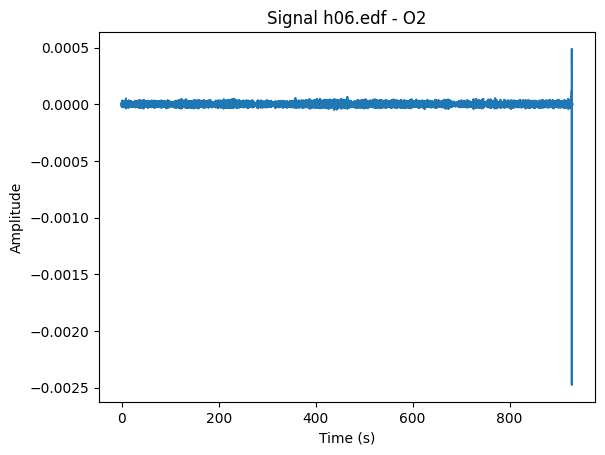

...

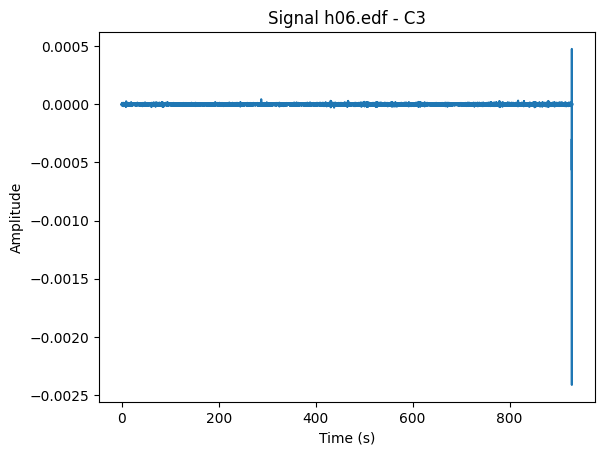

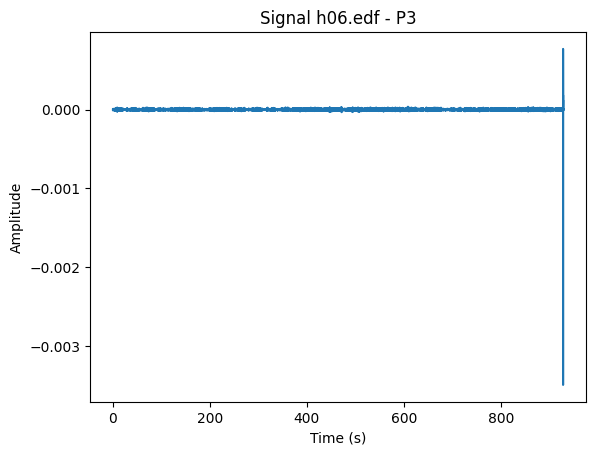

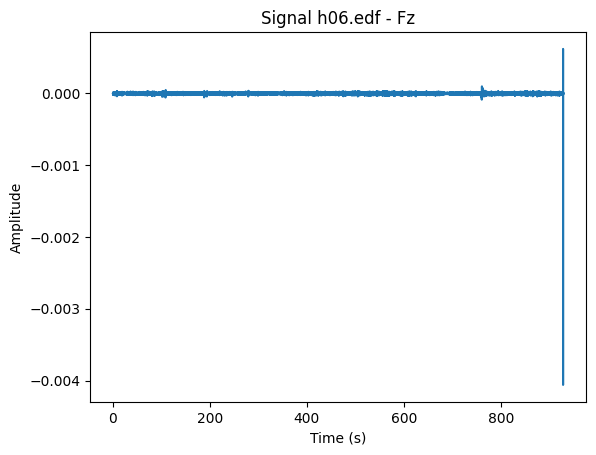

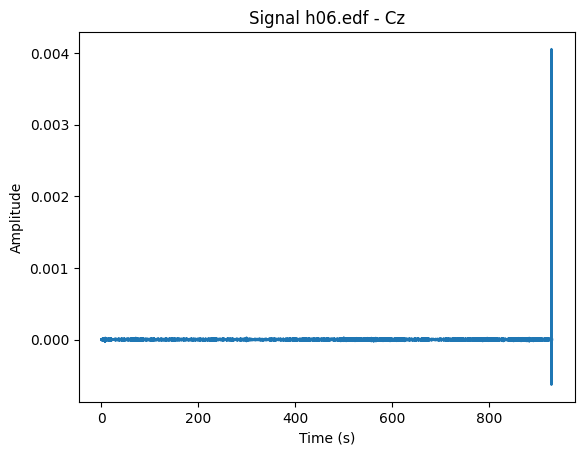

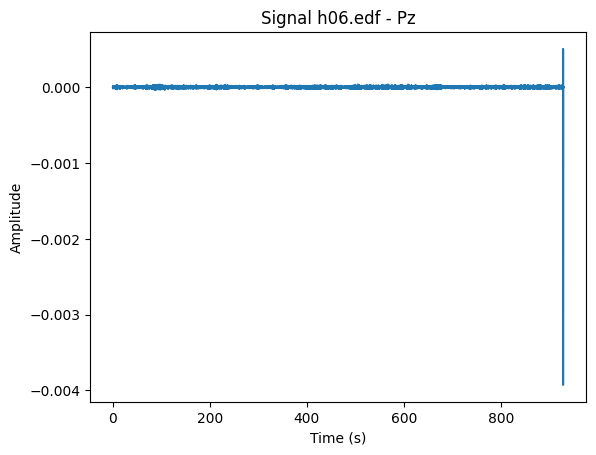

Extracting EDF parameters from /kaggle/input/eeg-data2/s12.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


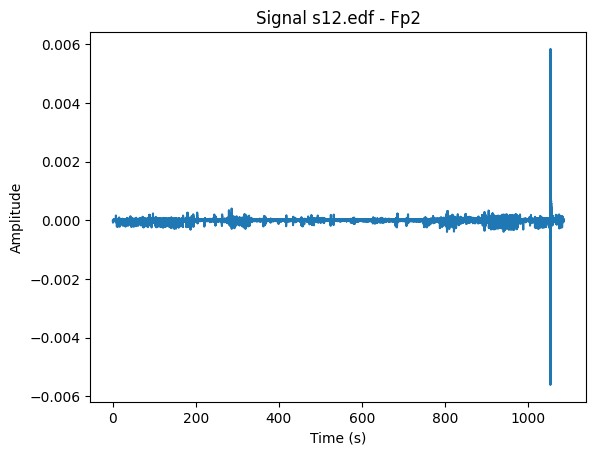

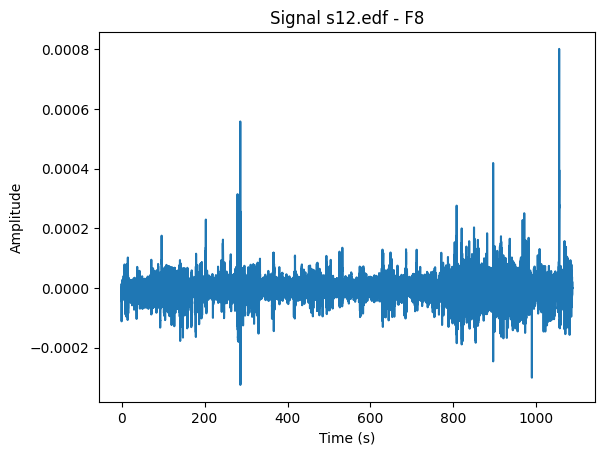

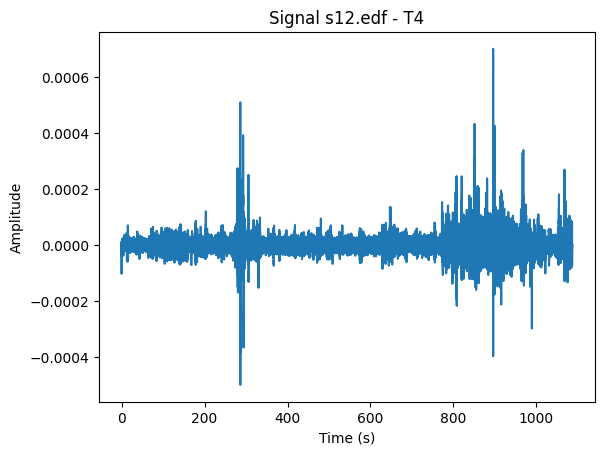

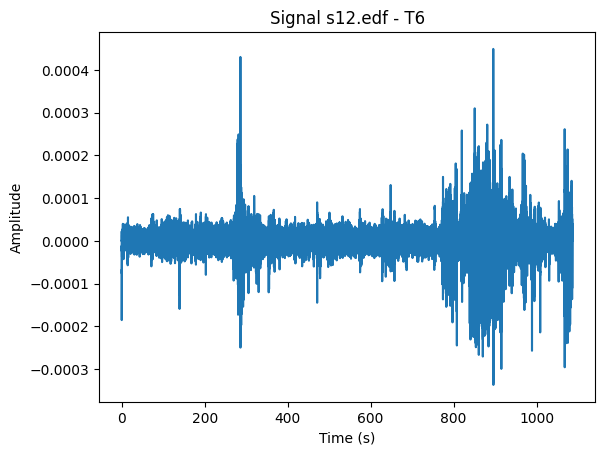

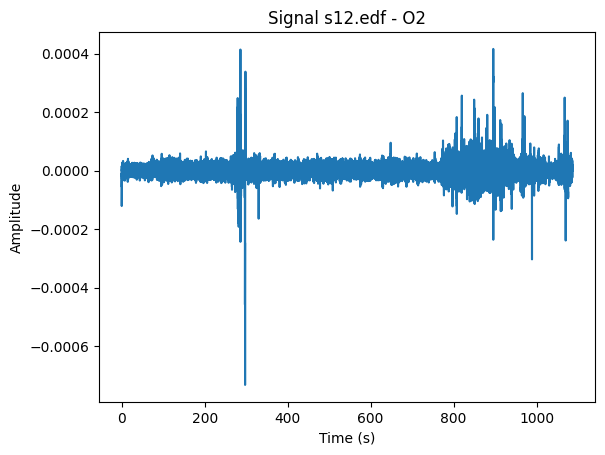

...

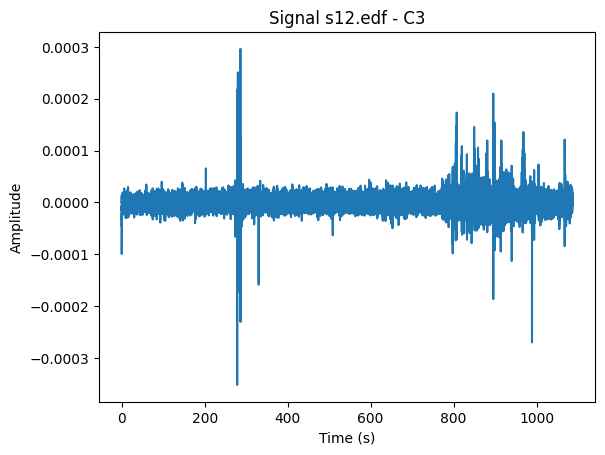

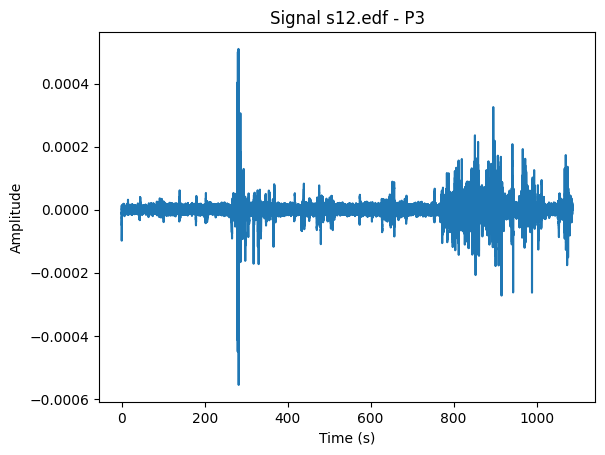

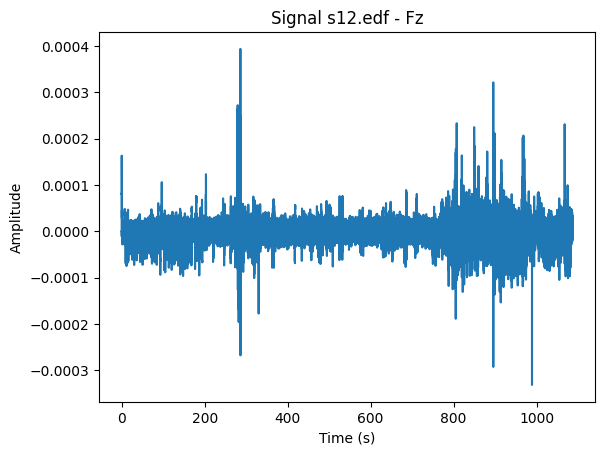

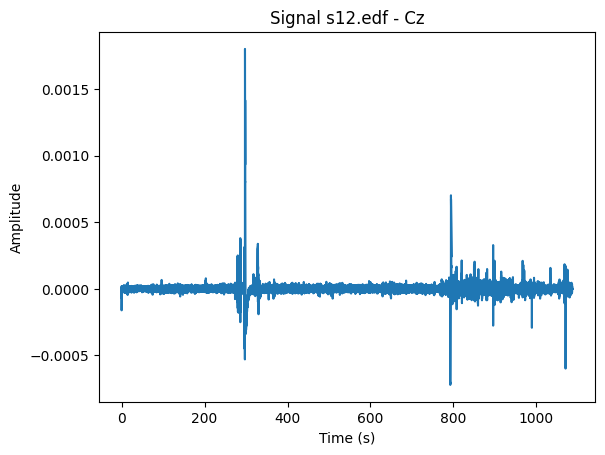

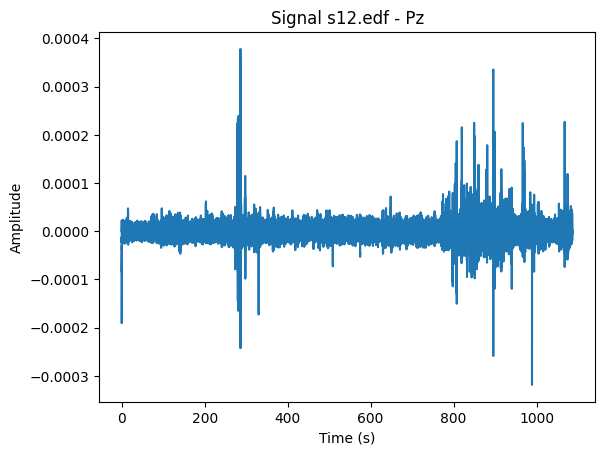

In [ ]:
import os
import mne
import matplotlib.pyplot as plt

# مسار المجلد الذي تحتوي على ملفات EDF
folder_path = '/kaggle/input/eeg-data2'

# الحصول على قائمة بجميع ملفات EDF في المجلد
edf_files = [f for f in os.listdir(folder_path) if f.endswith('.edf')]

# اللوب لقراءة وعرض كل ملف EDF
for edf_file in edf_files:
    # قراءة ملف EDF
    raw = mne.io.read_raw_edf(os.path.join(folder_path, edf_file))

    # استخراج البيانات
    data = raw.get_data()

    # عدد الإشارات (channels)
    num_channels = len(raw.ch_names)

    # رسم كل إشارة بشكل منفصل
    for i in range(num_channels):
        plt.figure()
        plt.plot(raw.times, data[i, :])  # بيانات الإشارة رقم i
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.title('Signal {} - {}'.format(edf_file, raw.ch_names[i]))
        plt.show()


In [ ]:
print (len(raw.ch_names))

19


In [ ]:
folder_path = '/kaggle/input/eeg-data2'
files_in_folder = os.listdir(folder_path)
num_files = len(files_in_folder)
print("عدد الملفات في المجلد هو:",num_files)

عدد الملفات في المجلد هو: 29


In [ ]:
from glob import glob
import os
import numpy as np
import pandas
import matplotlib.pyplot as plt

In [ ]:
glob('/kaggle/input/eeg-data2/*.edf')

['/kaggle/input/eeg-data2/h09.edf',
 '/kaggle/input/eeg-data2/h07.edf',
 '/kaggle/input/eeg-data2/s10.edf',
 '/kaggle/input/eeg-data2/s08.edf',
 '/kaggle/input/eeg-data2/s06.edf',
 '/kaggle/input/eeg-data2/h04.edf',
 '/kaggle/input/eeg-data2/h01.edf',
 '/kaggle/input/eeg-data2/s01.edf',
 '/kaggle/input/eeg-data2/h13.edf',
 '/kaggle/input/eeg-data2/s09.edf',
 '/kaggle/input/eeg-data2/s05.edf',
 '/kaggle/input/eeg-data2/h10.edf',
 '/kaggle/input/eeg-data2/s02.edf',
 '/kaggle/input/eeg-data2/s07.edf',
 '/kaggle/input/eeg-data2/s14.edf',
 '/kaggle/input/eeg-data2/s13.edf',
 '/kaggle/input/eeg-data2/h14.edf',
 '/kaggle/input/eeg-data2/s04.edf',
 '/kaggle/input/eeg-data2/h12.edf',
 '/kaggle/input/eeg-data2/h05.edf',
 '/kaggle/input/eeg-data2/h03.edf',
 '/kaggle/input/eeg-data2/s11.edf',
 '/kaggle/input/eeg-data2/h02.edf',
 '/kaggle/input/eeg-data2/h08.edf',
 '/kaggle/input/eeg-data2/h11.edf',
 '/kaggle/input/eeg-data2/s03.edf',
 '/kaggle/input/eeg-data2/h06.edf',
 '/kaggle/input/eeg-data2/s1

In [ ]:
all_file_path=glob('/kaggle/input/eeg-data2/*.edf')
print(len(all_file_path))

28


In [ ]:
all_file_path[0]

'/kaggle/input/eeg-data2/h09.edf'

In [ ]:
import os

# Assuming you have a list called all_file_path containing all file paths


healthy_file_path = [i for i in all_file_path if 'h' in os.path.split(i)[1]]
patient_file_path = [i for i in all_file_path if 's' in os.path.split(i)[1]]

print(len(healthy_file_path), len(patient_file_path))


14 14


In [ ]:
def read_data(file_path):
    data=mne.io.read_raw_edf(file_path,preload=True)
    data.set_eeg_reference()
    data.filter(l_freq=0.5,h_freq=45)
    epochs=mne.make_fixed_length_epochs(data,duration=5,overlap=1)
    array=epochs.get_data()
    return array

In [ ]:
sample_data=read_data(healthy_file_path[0])

Extracting EDF parameters from /kaggle/input/eeg-data2/h09.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 226249  =      0.000 ...   904.996 secs...
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 45 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 45.00 Hz
- Upper transition bandwidth: 11.25 Hz (-6 dB cutoff frequency: 50.62 Hz)
- Filter length: 1651 samples (6.604 s)

Not setting metadata
226 matching events found
No baseline correction applied
0 projection items activated
Using data f

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s


In [ ]:
sample_data.shape #no.of epochs,channels,length of signal

(226, 19, 1250)

In [ ]:
%%capture
control_epochs_array=[read_data(i) for i in healthy_file_path ]
patient_epochs_array=[read_data(i) for i in patient_file_path ]

In [ ]:
control_epochs_array[0].shape , control_epochs_array[1].shape

((226, 19, 1250), (227, 19, 1250))

In [ ]:
control_epoch_labels=[len(i)*[0] for i in control_epochs_array]
patient_epoch_labels=[len(i)*[1] for i in patient_epochs_array]
len(control_epoch_labels),len(patient_epoch_labels)

(14, 14)

In [ ]:
data_list=control_epochs_array+patient_epochs_array
label_list=control_epoch_labels+patient_epoch_labels

In [ ]:
group_list=[[i]*len(j) for i,j in enumerate(data_list)]
len(group_list)

28

In [ ]:
data_array=np.vstack(data_list)
label_array=np.hstack(label_list)
group_array=np.hstack(group_list)
print(data_array.shape , label_array.shape , group_array.shape)

(7201, 19, 1250) (7201,) (7201,)


In [ ]:
np.mean(data_array , axis=-1).shape

(7201, 19)

# Preprocessing

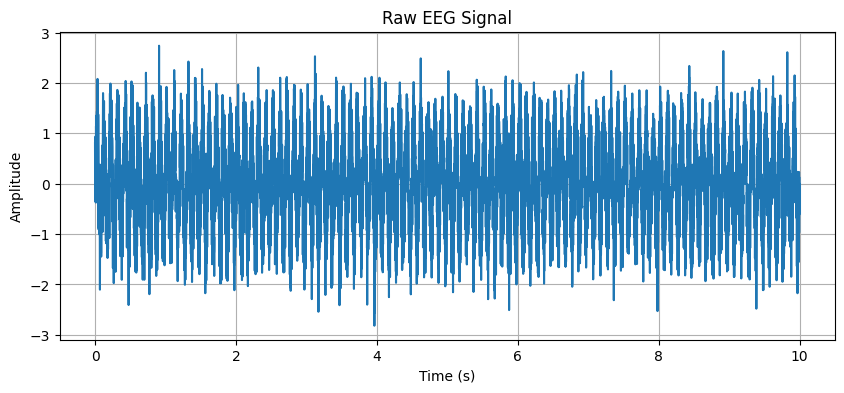

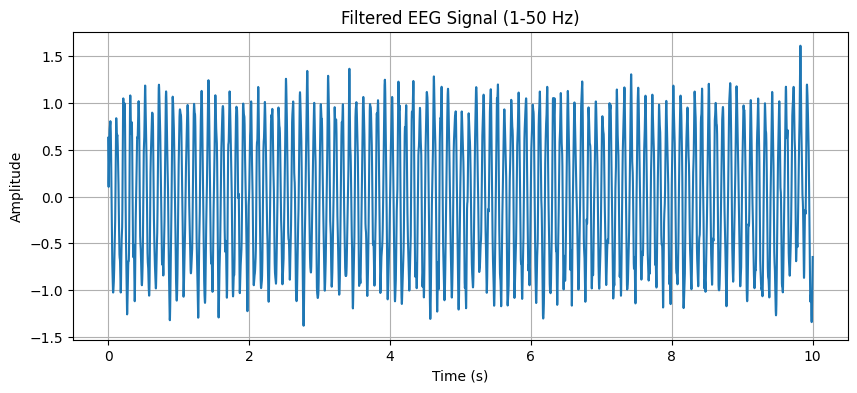

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal

# Generate example EEG data
fs = 1000  # Sampling frequency
t = np.linspace(0, 10, 10*fs)  # Time vector
eeg_data = np.sin(2*np.pi*10*t) + 0.5*np.random.randn(len(t))  # Example EEG signal with 10 Hz component

# Plot the raw EEG signal
plt.figure(figsize=(10, 4))
plt.plot(t, eeg_data)
plt.title('Raw EEG Signal')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()

# Apply bandpass filter (e.g., 1-50 Hz)
lowcut = 1  # Lower cutoff frequency
highcut = 50  # Upper cutoff frequency
order = 4  # Filter order

# Design Butterworth bandpass filter
b, a = signal.butter(order, [lowcut, highcut], btype='band', fs=fs)

# Apply filter to EEG data
filtered_eeg_data = signal.filtfilt(b, a, eeg_data)

# Plot the filtered EEG signal
plt.figure(figsize=(10, 4))
plt.plot(t, filtered_eeg_data)
plt.title('Filtered EEG Signal (1-50 Hz)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()


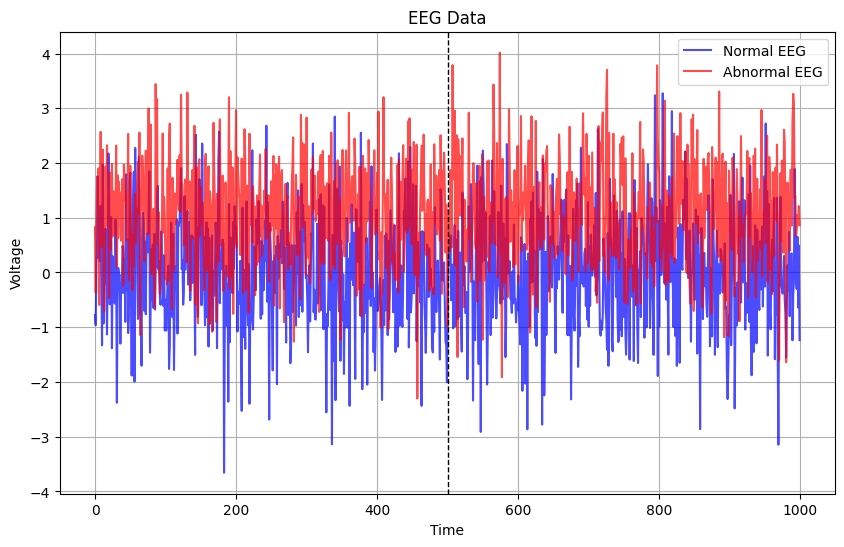

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Generate some sample EEG data (replace this with your actual data)
# Assume EEG data is a 1D array
num_samples = 1000
eeg_normal = np.random.normal(0, 1, num_samples)  # Normal EEG data
eeg_abnormal = np.random.normal(1, 1, num_samples)  # Abnormal EEG data

# Plotting
plt.figure(figsize=(10, 6))

# Plot normal EEG data
plt.plot(eeg_normal, label='Normal EEG', color='blue', alpha=0.7)

# Plot abnormal EEG data
plt.plot(eeg_abnormal, label='Abnormal EEG', color='red', alpha=0.7)

# Highlight differences (you would replace this with your actual analysis)
# For illustration, let's just highlight the difference at a specific index
index_to_highlight = 500
plt.axvline(x=index_to_highlight, color='black', linestyle='--', linewidth=1)

plt.title('EEG Data')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.legend()
plt.grid(True)
plt.show()


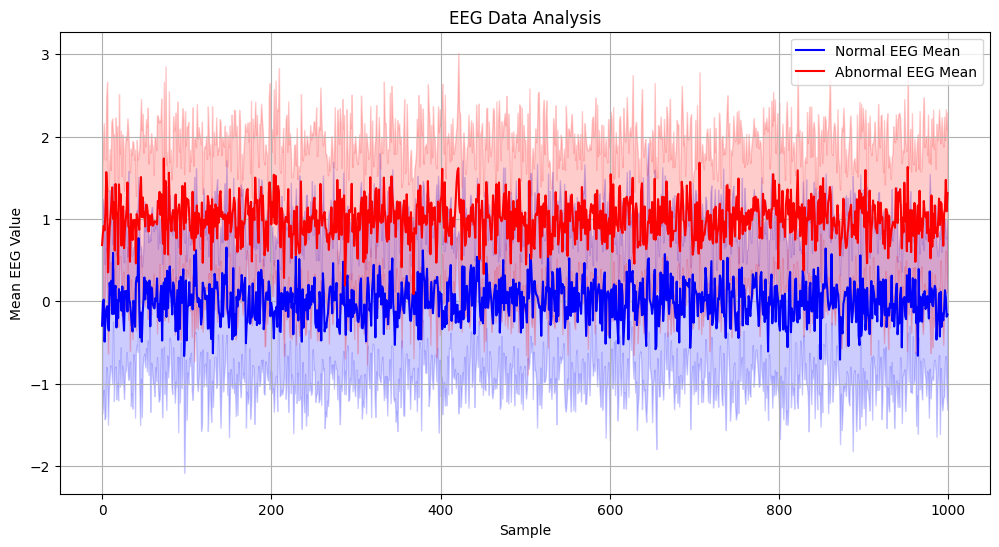

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Generate some sample EEG data (replace this with your actual data)
# Assume EEG data is a 2D array, with each row representing a sample and each column representing a channel
num_samples = 1000
num_channels = 16  # Number of EEG channels
eeg_normal = np.random.normal(0, 1, size=(num_samples, num_channels))  # Normal EEG data
eeg_abnormal = np.random.normal(1, 1, size=(num_samples, num_channels))  # Abnormal EEG data

# Calculate mean and standard deviation across channels for each sample
mean_normal = np.mean(eeg_normal, axis=1)
std_normal = np.std(eeg_normal, axis=1)

mean_abnormal = np.mean(eeg_abnormal, axis=1)
std_abnormal = np.std(eeg_abnormal, axis=1)

# Plotting
plt.figure(figsize=(12, 6))

# Plot mean with standard deviation for normal EEG data
plt.plot(mean_normal, label='Normal EEG Mean', color='blue')
plt.fill_between(range(len(mean_normal)), mean_normal - std_normal, mean_normal + std_normal, color='blue', alpha=0.2)

# Plot mean with standard deviation for abnormal EEG data
plt.plot(mean_abnormal, label='Abnormal EEG Mean', color='red')
plt.fill_between(range(len(mean_abnormal)), mean_abnormal - std_abnormal, mean_abnormal + std_abnormal, color='red', alpha=0.2)

plt.title('EEG Data Analysis')
plt.xlabel('Sample')
plt.ylabel('Mean EEG Value')
plt.legend()
plt.grid(True)
plt.show()


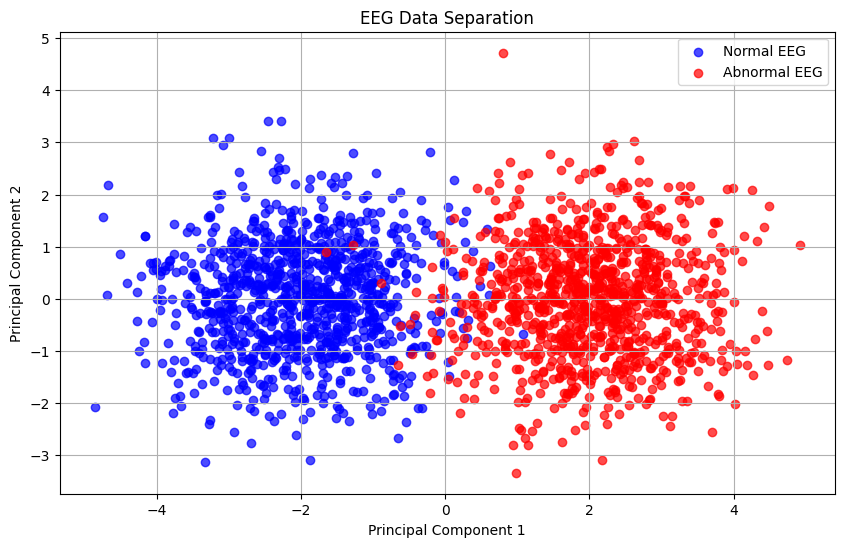

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Assuming you have eeg_normal and eeg_abnormal as your EEG data

# Combine normal and abnormal EEG data into one array
all_eeg_data = np.concatenate((eeg_normal, eeg_abnormal), axis=0)

# Apply PCA to reduce dimensionality
pca = PCA(n_components=2)  # Assuming we want to visualize in 2D
pca.fit(all_eeg_data)

# Transform EEG data using PCA
normal_pca = pca.transform(eeg_normal)
abnormal_pca = pca.transform(eeg_abnormal)

# Plotting
plt.figure(figsize=(10, 6))

# Plot normal EEG data
plt.scatter(normal_pca[:, 0], normal_pca[:, 1], label='Normal EEG', color='blue', alpha=0.7)

# Plot abnormal EEG data
plt.scatter(abnormal_pca[:, 0], abnormal_pca[:, 1], label='Abnormal EEG', color='red', alpha=0.7)

plt.title('EEG Data Separation')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.grid(True)
plt.show()


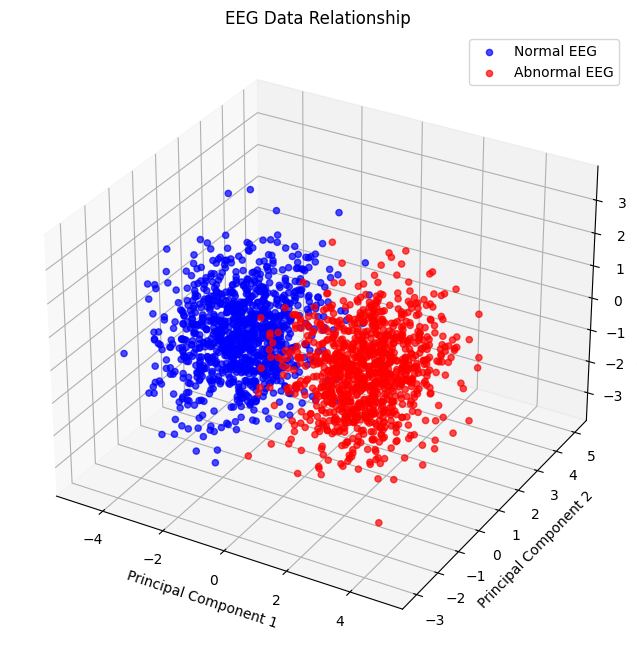

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Assuming you have eeg_normal and eeg_abnormal as your EEG data

# Combine normal and abnormal EEG data into one array
all_eeg_data = np.concatenate((eeg_normal, eeg_abnormal), axis=0)

# Apply PCA to reduce dimensionality
pca = PCA(n_components=3)  # Assuming we want to visualize in 3D
pca.fit(all_eeg_data)

# Transform EEG data using PCA
normal_pca = pca.transform(eeg_normal)
abnormal_pca = pca.transform(eeg_abnormal)

# Plotting
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot normal EEG data
ax.scatter(normal_pca[:, 0], normal_pca[:, 1], normal_pca[:, 2], label='Normal EEG', color='blue', alpha=0.7)

# Plot abnormal EEG data
ax.scatter(abnormal_pca[:, 0], abnormal_pca[:, 1], abnormal_pca[:, 2], label='Abnormal EEG', color='red', alpha=0.7)

ax.set_title('EEG Data Relationship')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.legend()
plt.show()


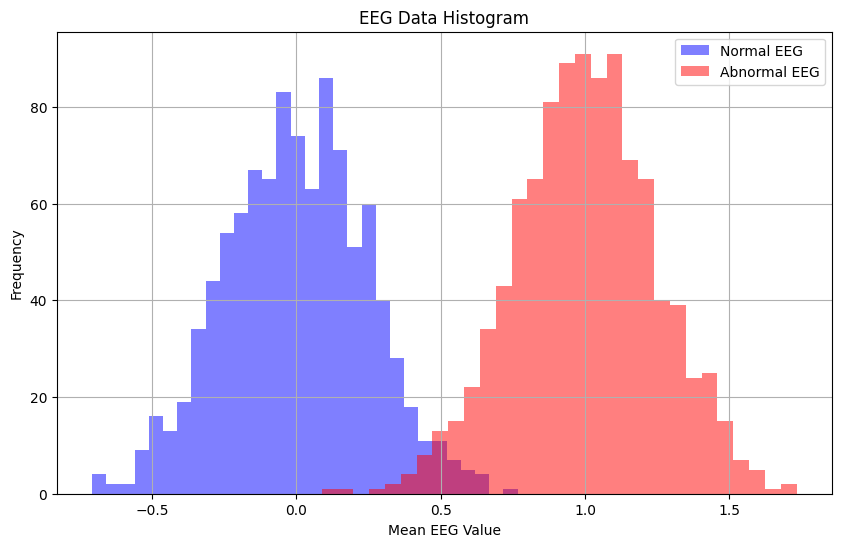

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming you have eeg_normal and eeg_abnormal as your EEG data

# Calculate mean for each EEG channel for normal and abnormal data
mean_normal = np.mean(eeg_normal, axis=1)
mean_abnormal = np.mean(eeg_abnormal, axis=1)

# Plotting histograms
plt.figure(figsize=(10, 6))

# Plot histogram for normal EEG data
plt.hist(mean_normal, bins=30, alpha=0.5, color='blue', label='Normal EEG')

# Plot histogram for abnormal EEG data
plt.hist(mean_abnormal, bins=30, alpha=0.5, color='red', label='Abnormal EEG')

plt.title('EEG Data Histogram')
plt.xlabel('Mean EEG Value')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()


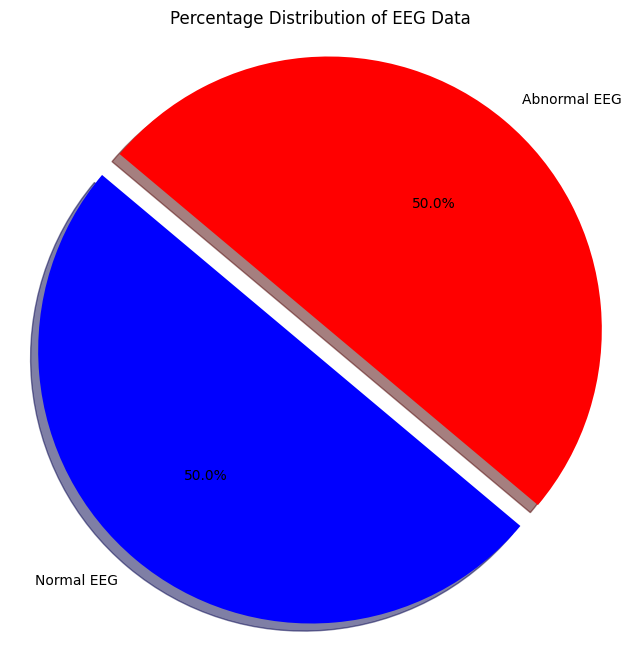

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming you have eeg_normal and eeg_abnormal as your EEG data

# Calculate the percentage of each type of EEG data
percentage_normal = len(eeg_normal) / (len(eeg_normal) + len(eeg_abnormal)) * 100
percentage_abnormal = len(eeg_abnormal) / (len(eeg_normal) + len(eeg_abnormal)) * 100

# Plotting
plt.figure(figsize=(8, 8))

# Data to plot
labels = 'Normal EEG', 'Abnormal EEG'
sizes = [percentage_normal, percentage_abnormal]
colors = ['blue', 'red']
explode = (0.1, 0)  # explode 1st slice (to highlight 'Normal EEG')

# Plot
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)

plt.title('Percentage Distribution of EEG Data')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import class_weight
from tensorflow.keras.layers import LSTM, BatchNormalization, LeakyReLU, Dense, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.backend import clear_session

# Define the RNN model
def rnn_model():
    clear_session()
    model = Sequential()

    # LSTM Layer
    model.add(LSTM(units=64, input_shape=(6250, 19)))
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    model.add(Dropout(0.5))

    # Fully Connected Layer
    model.add(Dense(32, activation='relu'))

    # Output Layer
    model.add(Dense(1, activation='sigmoid'))

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Generate dummy data for illustration
data_array = np.random.rand(100, 6250, 19)
label_array = np.random.randint(0, 2, size=(100, 1))

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data_array, label_array, test_size=0.2, random_state=42)

# Scale the data
scaler = StandardScaler()

# Flatten the training data, fit the scaler, and then reshape back to original shape
X_train_reshaped = X_train.reshape(-1, X_train.shape[-1])
X_train_scaled = scaler.fit_transform(X_train_reshaped).reshape(X_train.shape)

# Apply the same transformation to the test data
X_test_reshaped = X_test.reshape(-1, X_test.shape[-1])
X_test_scaled = scaler.transform(X_test_reshaped).reshape(X_test.shape)

# Calculate class weights to handle class imbalance
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train), y=y_train.flatten())
class_weights = dict(enumerate(class_weights))

# Create and train the model
model = rnn_model()
model.summary()

# Define callbacks
callbacks = [
    ModelCheckpoint("best_model.keras", save_best_only=True, monitor='val_loss', mode='min'),
    ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]

# Train the model
history = model.fit(X_train_scaled, y_train, epochs=100, batch_size=32, validation_split=0.2, callbacks=callbacks, class_weight=class_weights)

# Evaluate the model on test data
test_loss, test_accuracy = model.evaluate(X_test_scaled, y_test, verbose=0)
print(f"Test Accuracy: {test_accuracy:.4f}")

# Get predictions from the model
Y_pred_prob = model.predict(X_test_scaled)

# Flatten the predictions
Y_pred_prob = Y_pred_prob.flatten()

# Compute ROC curve and ROC area
fpr, tpr, roc_thresholds = roc_curve(y_test, Y_pred_prob)
roc_auc = auc(fpr, tpr)

# Increase the number of thresholds
thresholds = np.linspace(0.0, 1.0, num=11)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.4f})')
plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')

# Add points at each threshold
for threshold in thresholds:
    index = np.argmin(np.abs(roc_thresholds - threshold))
    plt.plot(fpr[index], tpr[index], 'o', label=f'Threshold = {threshold:.2f}', markersize=8)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) - Increased Thresholds')
plt.xticks(np.arange(0, 1.1, 0.1))
plt.yticks(np.arange(0, 1.1, 0.1))
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

2024-05-19 19:11:04.715190: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-19 19:11:04.715320: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-19 19:11:04.841146: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
/opt/conda/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:205: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 64)             │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,873 (93.25 KB)

 Trainable params: 23,745 (92.75 KB)

 Non-trainable params: 128 (512.00 B)

Epoch 1/100


In [ ]:
from sklearn.metrics import confusion_matrix, f1_score, accuracy_score, roc_curve
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y_test, Y_pred_prob)

# Find the best threshold based on Youden's J statistic
optimal_idx = np.argmax(tpr - fpr)
best_threshold = thresholds[optimal_idx]

# Convert probabilities to binary classification based on the best threshold
Y_pred = (Y_pred_prob > best_threshold).astype(int)

# Compute confusion matrix
cm = confusion_matrix(y_test, Y_pred)
tn, fp, fn, tp = cm.ravel()
accuracy = accuracy_score(y_test, Y_pred)
tpr_value = tp / (tp + fn)
fpr_value = fp / (fp + tn)
f1 = f1_score(y_test, Y_pred)

# Add a small value to avoid division by zero
epsilon = 1e-8

# Update confusion matrix if false positives are zero
if fp == 0:
    fp = epsilon

# Recalculate false positive rate
fpr_value = fp / (fp + tn)

print(f'Best Threshold: {best_threshold:.4f}')
print(f'Accuracy: {accuracy:.4f}')
print(f'True Positive: {tp}')
print(f'True Negative: {tn}')
print(f'False Positive: {fp}')
print(f'False Negative: {fn}')
print(f'True Positive Rate (TPR): {tpr_value:.4f}')
print(f'False Positive Rate (FPR): {fpr_value:.4f}')
print(f'F-measure: {f1:.4f}')
print('-' * 30)

# Plot confusion matrix
plt.figure(figsize=(5, 5))
sns.heatmap(cm,
            cmap=sns.dark_palette("#69d", 10, reverse=True, as_cmap=True),
            annot=True,
            linewidths=1,
            fmt=".0f")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title(f'Confusion Matrix (Best Threshold = {best_threshold:.4f})')
plt.show()

In [ ]:
from tensorflow.keras.layers import LSTM, BatchNormalization, LeakyReLU, Dense, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import StandardScaler
import numpy as np

def generate_random_data(samples, time_steps, num_channels):
    # Generate random EEG data and corresponding labels
    data_array = np.random.rand(samples, time_steps, num_channels)
    label_array = np.random.randint(0, 2, size=(samples, 1))  # Binary labels (0 or 1)
    return data_array, label_array

def eeg_model(time_steps, num_channels):
    model = Sequential()
    model.add(LSTM(units=64, input_shape=(time_steps, num_channels)))  # Modify input shape according to your EEG data
    model.add(BatchNormalization())
    model.add(LeakyReLU())
    model.add(Dropout(0.5))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))  # Output layer for binary classification

    model.compile('adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Generate random EEG data and labels
samples = 1000
time_steps = 128
num_channels = 4
data_array, label_array = generate_random_data(samples, time_steps, num_channels)

# Scale your data
scaler = StandardScaler()
data_array_scaled = scaler.fit_transform(data_array.reshape(-1, num_channels)).reshape(data_array.shape)

# Define model and early stopping
model = eeg_model(time_steps, num_channels)
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model
history = model.fit(data_array_scaled, label_array, epochs=10, batch_size=128, validation_split=0.2, callbacks=[early_stopping])

# Evaluate model on the entire dataset
test_loss, test_accuracy = model.evaluate(data_array_scaled, label_array)
print("Test Accuracy:", test_accuracy)

# Generate new random EEG data for prediction
new_data = np.random.rand(1, time_steps, num_channels)
new_data_scaled = scaler.transform(new_data.reshape(-1, num_channels)).reshape(new_data.shape)
predictions = model.predict(new_data_scaled)

# Interpret predictions
if predictions[0] < 0.5:
    print("Normal EEG Signal")
else:
    print("Abnormal EEG Signal")



In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
import numpy as np
# Generate predictions on the scaled data
predictions = (model.predict(data_array_scaled) > 0.5).astype(int)

# Compute the confusion matrix
cm = confusion_matrix(label_array, predictions)

# Extract TP, FN, TN, FP from the confusion matrix
TN, FP, FN, TP = cm.ravel()

print(f"True Positives (TP): {TP}")
print(f"False Negatives (FN): {FN}")
print(f"True Negatives (TN): {TN}")
print(f"False Positives (FP): {FP}")

In [ ]:
# قم بإدخال رمز الوصول الشخصي الخاص بك، واسم المستخدم، واسم المستودع
!git clone https://<Band7@@##>@github.com/<mennaayman1>/<REPOSITORY_NAME>.git
